The problem is that I should use proper barcode counting, I must see how many of barcodes I am counting from barcode sequencing
Some of those barcodes have N in their sequence and with simple matching you can't use them, there should be proper way to assign them, like minimap2

In [2]:
import itertools
import os
import re
import warnings
import seaborn as sns
import numpy as np

import sfmap
from scipy.stats import pearsonr, mannwhitneyu, wilcoxon, gaussian_kde, ttest_ind

import matplotlib.pyplot as plt
plt.rcParams["figure.dpi"] = 300  # High resolution
import numpy as np

from datetime import datetime
from collections import Counter

from matplotlib_venn import venn3, venn3_circles


from IPython.display import display, HTML
from matplotlib.backends.backend_pdf import PdfPages


from sklearn.decomposition import PCA
from adjustText import adjust_text

import pandas as pd
from pathlib import Path
from sklearn.metrics import r2_score

from Bio.Seq import Seq
from Bio import SeqIO

import random

import matplotlib as mpl
mpl.rcParams['font.family'] = 'Helvetica'

# Set global font to Helvetica
mpl.rcParams['font.family'] = 'Helvetica'


import yaml
warnings.simplefilter('ignore')

In [3]:
plot_cmap = {
    
    "EmberRed": "#7C1900",
    "TranqMist": "#466058",
    "SapphBlue": "#438CBD",
    "GoldHarmon": "#DACF6D",
    "AmberBurst": "#9E5817",
    "AzureDream": "#61BDD2",
    "CopperSet": "#B99131",
    "TwilightIndigo": "#305CAB",
    "green": "#278343",
    "grey" : "#b7b7b7"
}




name_map = {
    'insBindR1': 'Insulin binding score rep 1',
    'insBindR2': 'Insulin binding score rep 2',
    'a07BindR1': 'mAb 83-7 binding score rep 1',
    'a07BindR2': 'mAb 83-7 binding score rep 2',
    'a14BindR1': 'mAb 83-14 binding score rep 1',
    'a14BindR2': 'mAb 83-14 binding score rep 2',
    'a07SignR1': 'mAb 83-7 signalling score rep 1',
    'a07SignR2': 'mAb 83-7 signalling score rep 2',
    'a07SignR3': 'mAb 83-7 signalling score rep 3',
    'a14SignR1': 'mAb 83-14 signalling score rep 1',
    'a14SignR2': 'mAb 83-14 signalling score rep 2',
    'a14SignR3': 'mAb 83-14 signalling score rep 3',
    'insSignR1': 'Insulin signalling score rep 1',
    'insSignR2': 'Insulin signalling score rep 2',
    'insSignR3': 'Insulin signalling score rep 3',
    'insSignR4': 'Insulin signalling score rep 4',
    'insSignR5': 'iInsulin signalling score rep 5',
    'insSignR6': 'iInsulin signalling score rep 6',
    'insSignR7': 'iInsulin signalling score rep 7',
    'insBind_avg': 'Insulin binding score',
    'a07Bind_avg': 'mAb 83-7 binding score',
    'a14Bind_avg': 'mAb 83-14 binding score',
    'insSign_avg': 'Insulin signalling score',
    'a07Sign_avg': 'mAb 83-7 signalling score',
    'a14Sign_avg': 'mAb 83-14 signalling score',
    'a07a14_Bind_avg': 'Cell surface expression score',
    'a07a14_Sign_avg': 'average antibodies signalling score'}



Read the configuration file:

In [4]:
with open('config.yaml') as f:
    config = yaml.safe_load(f)

Make output directory for counts:

## Load Codon-Variant table

Read the PacBio amplicon target sequence and translate it to protein and Classify the variants and flag wt and synonymous variants in aa_substitutions column

In [5]:
#read codon_variant_table generated by pacbio sequencing and pbData_analysis
variants = pd.read_csv(f'{config["codon_variant_table_file"]}', na_filter=None)
variants = variants[variants['n_codon_substitutions']  < 2]

        
display(HTML(variants.head().to_html(index=False)))

#can assign variatn class column if not present in df generated by pbData_analysis.ipynb
def classify_variants(df):
    def classify(row):
        if row["n_codon_substitutions"] == 0:
            return "wildtype"
        elif row["n_codon_substitutions"] > 0 and row["n_aa_substitutions"] == 0:
            return "codon_substitutions"
        elif "*" in str(row["aa_substitutions"]) and row["n_aa_substitutions"]==1:
            return "stop"
        elif row["n_aa_substitutions"] == 1:
            return "1 nonsynonymous"
        else:
            return ">1 nonsynonymous"
    df["variant_class"] = df.apply(classify, axis=1)
    return df


variants=classify_variants(variants)
variants['aa_substitutions']=variants['aa_substitutions'].where(variants['aa_substitutions'] != '', variants['variant_class'])
variants.loc[variants['aa_substitutions'] == 'codon_substitutions', 'aa_substitutions'] = \
    variants.loc[variants['aa_substitutions'] == 'codon_substitutions', 'codon_substitutions']

variants=variants[variants['variant_class']!='1 nonsynonymous']


target,library,barcode,variant_call_support,number_of_indels,codon_substitutions,aa_substitutions,n_codon_substitutions,n_aa_substitutions,variant_class,aa_substitutions_c
INSR_PacBio_amplicon,insr,AATGGCGAATTATCTACAGCCATTTTTTTT,5,0,,,0,0,wildtype,wildtype
INSR_PacBio_amplicon,insr,ATCAAACAAAGCACCGATCACATTTTTTTT,9,0,GAA938GCC,E938A,1,1,1 nonsynonymous,E938A
INSR_PacBio_amplicon,insr,GACAAGAAGCACTTGGTTAAATGTTTTTTT,19,0,,,0,0,wildtype,wildtype
INSR_PacBio_amplicon,insr,GGGGGAGCTGAGGCGCCTAGTAATTTTTTT,1,0,TCC711TCG,,1,0,synonymous,synonymous
INSR_PacBio_amplicon,insr,GACTTGGAAAAACTCAGTTGATCGTTTTTT,31,0,AAG337CTC,K337L,1,1,1 nonsynonymous,K337L


## Read enrich2 barcode counts (values) for each facs run (key) as dict
We want to see how many of the barcodes per single variant (assigned by PacBio) have got reads after in FACS sorting

In [6]:
col_names = ['barcode','bin1', 'bin2', 'bin3', 'bin4']

# create an empty dictionary to store the barcode counts
barcode_counts = {}

facs_runs=pd.read_csv(f'{config["facs_runs"]}')

# drop duplicate libraries from the facs_runs dataframe
facs_runs_ = facs_runs.drop_duplicates(subset=['library'])

# iterate through the facs_runs dataframe
for i, row in facs_runs_.iterrows():
    print (f"Reading {(row['Enrich2_BC_counts'])}")
    # read the Enrich2_BC_counts file into a dataframe
    df = pd.read_table(f'{row["Enrich2_BC_counts"]}', names=col_names, skiprows=1)
    df['total_count']=df[["bin1", "bin2", "bin3", "bin4"]].sum(axis=1)
    df.set_index('barcode')
    # add the barcode counts dataframe to the dictionary with the library name as the key
    barcode_counts[row['library']] = df
    
print ("DONE!")

Reading results/Enrich2_counts/rep1/rep1_insulin_bind/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep1/rep1_8307_bind/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep1/rep1_8314_bind/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep1/rep1_pAKT_insulin/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep1/rep1_pAKT_8307/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep1/rep1_pAKT_8314/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep2/rep2_insulin_bind/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep2/rep2_8307_bind/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep2/rep2_8314_bind/tsv/sort_sel/main_barcodes_counts_unfiltered.tsv
Reading results/Enrich2_counts/rep2/rep2_pAKT_8307/tsv/sort_sel/main_barcodes_counts_unfilt

## score barcodes individually

In [7]:
barcode_scored={}
stdDict={}
bins = ['bin1', 'bin2', 'bin3', 'bin4']
constan_values=[0.25,0.5,0.75,1]

for library, df in barcode_counts.items():
    count=pd.merge(variants, df, on='barcode', how='left').fillna(0) # merge barcode counts with variant table
    
    count=count[count['total_count']>=150].reset_index(drop=True)


    count[['bin1_freq', 'bin2_freq', 'bin3_freq', 'bin4_freq']] = count[['bin1', 'bin2', 'bin3', 'bin4']].div(count[['bin1', 'bin2', 'bin3', 'bin4']].sum())

    count[['bin1_weighted_freq', 'bin2_weighted_freq', 'bin3_weighted_freq', 'bin4_weighted_freq']] = count[['bin1_freq', 'bin2_freq', 'bin3_freq', 'bin4_freq']].mul([0.25,0.5,0.75,1])

    count['barcode_weighted_avg']=((count[['bin1_weighted_freq', 'bin2_weighted_freq', 'bin3_weighted_freq', 'bin4_weighted_freq']].sum(axis=1))/
                    (count[['bin1_freq', 'bin2_freq', 'bin3_freq', 'bin4_freq']].sum(axis=1)))

    #count.reset_index(inplace=True, drop=True)
    
    
    count=count.reset_index()
    
    df=(count[~count['aa_substitutions'].str.endswith('*')])
    
    df_wt=(df[df['aa_substitutions']=='wildtype'])
    
    wt_std=round(np.std(df_wt['barcode_weighted_avg']),3)
    
    df_syn=(df[df['aa_substitutions']=='synonymous'])
    
    syn_std=round(np.std(df_syn['barcode_weighted_avg']),3)
    
    df_nonSyn = df[(df['aa_substitutions'] != 'wildtype') & (df['aa_substitutions'] != 'synonymous')]
    
    df_varCount = len(np.unique(df[df['variant_class']=='1 nonsynonymous']['aa_substitutions']))
    
    nonSyn_std=round(np.std(df_nonSyn['barcode_weighted_avg']),3)
    
    
    stdDict[library] = {
        'ScoredBarcodes': len(df.dropna(subset=["barcode_weighted_avg"])),
        'wt_std': wt_std,
        'syn_std': syn_std,
        'nonSyn_std': nonSyn_std
    }

    print (f'{library} ScoredBarcodes: {len(df.dropna(subset=["barcode_weighted_avg"]))},\
    varCount: {df_varCount} \
    wt_std: {wt_std}, \
    syn_std: {syn_std}, \
    nonSyn_std: {nonSyn_std}')
    
    count['barcode_weighted_avg_var'] = count['barcode_weighted_avg'] * (1 / (wt_std))
    
    barcode_scored[library]=count
    
    
bc_score = barcode_scored['insBindR1'][['barcode','aa_substitutions','barcode_weighted_avg']]
bc_score.rename(columns={'barcode_weighted_avg': 'insBindR1'}, inplace=True)

for library, df in barcode_scored.items():
    if library != 'insBindR1':
        
        df=df[['barcode','aa_substitutions','barcode_weighted_avg']]
        df.rename(columns={'barcode_weighted_avg': library}, inplace=True)
    
        bc_score = pd.merge(bc_score, df, on=['barcode','aa_substitutions'], how='outer')

insBindR1 ScoredBarcodes: 27636,    varCount: 0     wt_std: 0.122,     syn_std: nan,     nonSyn_std: 0.12
a07BindR1 ScoredBarcodes: 28902,    varCount: 0     wt_std: 0.123,     syn_std: nan,     nonSyn_std: 0.121
a14BindR1 ScoredBarcodes: 29473,    varCount: 0     wt_std: 0.132,     syn_std: nan,     nonSyn_std: 0.129
insSignR1 ScoredBarcodes: 29399,    varCount: 0     wt_std: 0.073,     syn_std: nan,     nonSyn_std: 0.072
a07SignR1 ScoredBarcodes: 28763,    varCount: 0     wt_std: 0.085,     syn_std: nan,     nonSyn_std: 0.084
a14SignR1 ScoredBarcodes: 28257,    varCount: 0     wt_std: 0.112,     syn_std: nan,     nonSyn_std: 0.11
insBindR2 ScoredBarcodes: 31330,    varCount: 0     wt_std: 0.117,     syn_std: nan,     nonSyn_std: 0.116
a07BindR2 ScoredBarcodes: 30947,    varCount: 0     wt_std: 0.136,     syn_std: nan,     nonSyn_std: 0.135
a14BindR2 ScoredBarcodes: 32005,    varCount: 0     wt_std: 0.143,     syn_std: nan,     nonSyn_std: 0.138
a07SignR2 ScoredBarcodes: 27401,    var

## replicates barcode score averaging

In [8]:
bc_score['insBind_avg']=np.nanmean(bc_score[['insBindR1','insBindR2']], axis=1)
bc_score['a07Bind_avg']=np.nanmean(bc_score[['a07BindR1','a07BindR2']], axis=1)
bc_score['a14Bind_avg']=np.nanmean(bc_score[['a14BindR1','a14BindR2']], axis=1)
bc_score['insSign_avg']=np.nanmean(bc_score[['insSignR1','insSignR2','insSignR3','insSignR4','insSignR5']], axis=1)
bc_score['a07Sign_avg']=np.nanmean(bc_score[['a07SignR1','a07SignR2','a07SignR3']], axis=1)
bc_score['a14Sign_avg']=np.nanmean(bc_score[['a14SignR1','a14SignR2','a14SignR3']], axis=1)
bc_score['a07a14_Bind_avg']=np.nanmean(bc_score[['a07BindR1','a07BindR2','a14BindR1','a14BindR2']], axis=1)



In [9]:
# Calculating variant score withing each replicate
numeric_cols = bc_score.select_dtypes(include='number').columns

bc_score_grpd=bc_score.groupby('aa_substitutions')[numeric_cols].mean().reset_index()

# Select the rows corresponding to 'wildtype' and 'variants' separately
wildtype_score = bc_score_grpd[bc_score_grpd['aa_substitutions'] == 'wildtype']
variants_score = bc_score_grpd[~bc_score_grpd['aa_substitutions'].isin(['wildtype','synonymous'])]

# Drop 'aa_substitutions' column for division
wildtype_values = wildtype_score.drop(columns='aa_substitutions')
variants_values = variants_score.drop(columns='aa_substitutions')

# Perform division
variants_divided_by_wildtype = variants_values.divide(wildtype_values.iloc[0])

# Update 'variants_row' DataFrame with the result
variants_score.loc[:, variants_divided_by_wildtype.columns] = variants_divided_by_wildtype

# calculating variant score for avregaes, here is the place to apply weighting
variants_score['insBind_avg']=np.log2(np.nanmean(variants_score[['insBindR1','insBindR2']], axis=1))
variants_score['a07Bind_avg']=np.log2(np.nanmean(variants_score[['a07BindR1','a07BindR2']], axis=1))
variants_score['a14Bind_avg']=np.log2(np.nanmean(variants_score[['a14BindR1','a14BindR2']], axis=1))
variants_score['insSign_avg']=np.log2(np.nanmean(variants_score[['insSignR1','insSignR2','insSignR3','insSignR4','insSignR5']], axis=1))
variants_score['a07Sign_avg']=np.log2(np.nanmean(variants_score[['a07SignR1','a07SignR2','a07SignR3']], axis=1))
variants_score['a14Sign_avg']=np.log2(np.nanmean(variants_score[['a14SignR1','a14SignR2','a14SignR3']], axis=1))
variants_score['a07a14_Bind_avg']=np.log2(np.nanmean(variants_score[['a07BindR1','a07BindR2','a14BindR1','a14BindR2']], axis=1))




#Find number of replicates each variant  reprsentend

num_nans = variants_score[['insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['insSign_RepCont'] = np.select(
    [num_nans == 5, num_nans == 4, num_nans == 3, num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2, 3, 4, 5],
    default=np.nan
)

num_nans = variants_score[['a07BindR1', 'a07BindR2', 'a14BindR1', 'a14BindR2']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['a07a14_Bind_RepCont'] = np.select(
    [num_nans == 4, num_nans == 3, num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2, 3, 4],
    default=np.nan
)

num_nans = variants_score[['insBindR1', 'insBindR2']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['insBind_RepCont'] = np.select(
    [num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2,],
    default=np.nan
)

num_nans = variants_score[['a07BindR1', 'a07BindR2']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['a07Bind_RepCont'] = np.select(
    [num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2,],
    default=np.nan
)

num_nans = variants_score[['a14BindR1', 'a14BindR2']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['a14Bind_RepCont'] = np.select(
    [num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2,],
    default=np.nan
)

num_nans = variants_score[['a07SignR1', 'a07SignR2', 'a07SignR3']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['a07Sign_RepCont'] = np.select(
    [num_nans == 3, num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2,3],
    default=np.nan
)

num_nans = variants_score[['a14SignR1', 'a14SignR2', 'a14SignR3']].isna().sum(axis=1)

# Assign repCount based on the number of NaNs
variants_score['a14Sign_RepCont'] = np.select(
    [num_nans == 3, num_nans == 2, num_nans == 1, num_nans == 0],
    [0, 1, 2,3],
    default=np.nan
)

#get only synonymous variants
variants_score = variants_score[variants_score['aa_substitutions'].str.len() > 5]
variants_score_syns=variants_score[['aa_substitutions','insBind_avg','a07Bind_avg','a14Bind_avg','insSign_avg', 'a07a14_Bind_avg']]
variants_score_syns.to_csv('results/scores/syonymouse_variants_scores.csv', index=False)

variants_score_dict={}
variants_score_dict['insBind_avg']=variants_score[['aa_substitutions','insBind_avg','insBind_RepCont']]
variants_score_dict['a07Bind_avg']=variants_score[['aa_substitutions','a07Bind_avg','a07Bind_RepCont']]
variants_score_dict['a14Bind_avg']=variants_score[['aa_substitutions','a14Bind_avg', 'a14Bind_RepCont']]
variants_score_dict['insSign_avg']=variants_score[['aa_substitutions','insSign_avg','insSign_RepCont']]
variants_score_dict['a07Sign_avg']=variants_score[['aa_substitutions','a07Sign_avg', 'a07Sign_RepCont']]
variants_score_dict['a14Sign_avg']=variants_score[['aa_substitutions','a14Sign_avg', 'a14Sign_RepCont']]
variants_score_dict['a07a14_Bind_avg']=variants_score[['aa_substitutions','a07a14_Bind_avg','a07a14_Bind_RepCont']]


In [ ]:
df22=bc_score[['barcode','aa_substitutions','insBindR1','insBind_avg']]
df2=bc_score[['barcode','aa_substitutions','insBindR2','insBind_avg']]
df22['Rep']=1
df22.dropna(subset='insBindR1', inplace=True)
df2.dropna(subset='insBindR2', inplace=True)
df=((pd.concat([df22,df2], axis=0)))
insBind_WtPool=list(df[df['aa_substitutions']=='wildtype']['insBind_avg'])
insBind_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del insBind_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
insBind_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['insBind_avg'].to_dict()

df22=bc_score[['barcode','aa_substitutions','a07BindR1','a07Bind_avg']]
df2=bc_score[['barcode','aa_substitutions','a07BindR2','a07Bind_avg']]
df1.dropna(subset='a07BindR1', inplace=True)
df2.dropna(subset='a07BindR2', inplace=True)
df=((pd.concat([df1,df2], axis=0)))
a07Bind_WtPool=list(df[df['aa_substitutions']=='wildtype']['a07Bind_avg'])
a07Bind_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del a07Bind_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
a07Bind_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['a07Bind_avg'].to_dict()


df1=bc_score[['barcode','aa_substitutions','a14BindR1','a14Bind_avg']]
df2=bc_score[['barcode','aa_substitutions','a14BindR2','a14Bind_avg']]
df1.dropna(subset='a14BindR1', inplace=True)
df2.dropna(subset='a14BindR2', inplace=True)
df=((pd.concat([df1,df2], axis=0)))
a14Bind_WtPool=list(df[df['aa_substitutions']=='wildtype']['a14Bind_avg'])
a14Bind_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del a14Bind_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
a14Bind_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['a14Bind_avg'].to_dict()

df1=bc_score[['barcode','aa_substitutions','insSignR1','insSign_avg']]
df2=bc_score[['barcode','aa_substitutions','insSignR2','insSign_avg']]
df3=bc_score[['barcode','aa_substitutions','insSignR3','insSign_avg']]
df4=bc_score[['barcode','aa_substitutions','insSignR4','insSign_avg']]
df5=bc_score[['barcode','aa_substitutions','insSignR5','insSign_avg']]
df1.dropna(subset='insSignR1', inplace=True)
df2.dropna(subset='insSignR2', inplace=True)
df3.dropna(subset='insSignR3', inplace=True)
df4.dropna(subset='insSignR4', inplace=True)
df5.dropna(subset='insSignR5', inplace=True)
df=((pd.concat([df1,df2,df3,df4,df5], axis=0)))
insSign_WtPool=list(df[df['aa_substitutions']=='wildtype']['insSign_avg'])
insSign_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del insSign_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
insSign_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['insSign_avg'].to_dict()

df1=bc_score[['barcode','aa_substitutions','a07BindR1','a07a14_Bind_avg']]
df2=bc_score[['barcode','aa_substitutions','a07BindR2','a07a14_Bind_avg']]
df3=bc_score[['barcode','aa_substitutions','a14BindR1','a07a14_Bind_avg']]
df4=bc_score[['barcode','aa_substitutions','a14BindR2','a07a14_Bind_avg']]



df1.dropna(subset='a07BindR1', inplace=True)
df2.dropna(subset='a07BindR2', inplace=True)
df3.dropna(subset='a14BindR1', inplace=True)
df4.dropna(subset='a14BindR2', inplace=True)
df=((pd.concat([df1,df2,df3,df4], axis=0)))
a07a14_Bind_WtPool=list(df[df['aa_substitutions']=='wildtype']['a07a14_Bind_avg'])
a07a14_Bind_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del a07a14_Bind_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
a07a14_Bind_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['a07a14_Bind_avg'].to_dict()


df1=bc_score[['barcode','aa_substitutions','a07SignR1','a07Sign_avg']]
df2=bc_score[['barcode','aa_substitutions','a07SignR2','a07Sign_avg']]
df3=bc_score[['barcode','aa_substitutions','a07SignR3','a07Sign_avg']]
df1.dropna(subset='a07SignR1', inplace=True)
df2.dropna(subset='a07SignR2', inplace=True)
df3.dropna(subset='a07SignR3', inplace=True)
df=((pd.concat([df1,df2,df3], axis=0)))
a07Sign_WtPool=list(df[df['aa_substitutions']=='wildtype']['a07Sign_avg'])
a07Sign_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del a07Sign_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
a07Sign_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['a07Sign_avg'].to_dict()



df1=bc_score[['barcode','aa_substitutions','a14SignR1','a14Sign_avg']]
df2=bc_score[['barcode','aa_substitutions','a14SignR2','a14Sign_avg']]
df3=bc_score[['barcode','aa_substitutions','a14SignR3','a14Sign_avg']]
df1.dropna(subset='a14SignR1', inplace=True)
df2.dropna(subset='a14SignR2', inplace=True)
df3.dropna(subset='a14SignR3', inplace=True)
df=((pd.concat([df1,df2,df3], axis=0)))
a14Sign_WtPool=list(df[df['aa_substitutions']=='wildtype']['a14Sign_avg'])
a14Sign_VarRepBarCont=df.groupby('aa_substitutions').size().to_dict()
del a14Sign_VarRepBarCont['wildtype']

numeric_cols = df.select_dtypes(include='number').columns
a14Sign_VarScore=df.groupby('aa_substitutions')[numeric_cols].mean()['a14Sign_avg'].to_dict()





In [73]:
lib_list=['wt_pool_insBind','wt_pool_a07Bind',
                'wt_pool_a14Bind', 'wt_pool_a07Sign',
                'wt_pool_a14Sign','wt_pool_insSign',
                'wt_pool_a07a14_Bind', 'wt_pool_a07a14_Sign']

lib_list_dict={ 'insBind_avg':[insBind_WtPool, insBind_VarRepBarCont, insBind_VarScore],
                'a07Bind_avg':[a07Bind_WtPool, a07Bind_VarRepBarCont, a07Bind_VarScore],
                'a14Bind_avg':[a14Bind_WtPool, a14Bind_VarRepBarCont, a14Bind_VarScore],
                'a07Sign_avg':[a07Sign_WtPool, a07Sign_VarRepBarCont, a07Sign_VarScore],
                'a14Sign_avg':[a14Sign_WtPool, a14Sign_VarRepBarCont, a14Sign_VarScore],
                'insSign_avg':[insSign_WtPool, insSign_VarRepBarCont, insSign_VarScore],
                'a07a14_Bind_avg':[a07a14_Bind_WtPool, a07a14_Bind_VarRepBarCont, a07a14_Bind_VarScore]
                }
                
                
start_time_clock = datetime.now().strftime("%H:%M:%S")
print("Start time:", start_time_clock)


wt_bootstraps={}
for j, library in enumerate(lib_list_dict.keys()):
    
    wt_pool=lib_list_dict[library][0] #list of wt barcode scores
                

    print ('wildtype bootstrapping for ' + library + ' please wait ...')

    print("current time:", datetime.now().strftime("%H:%M:%S")) 
    
    wt_bc_score_dists = {}

    for i in range (1, 300):
        wt_bc_score_avg_bootstrapped=[]
        
        for _ in range(10000): #bootstrapping size
            wt_bc_score_avg_bootstrapped.append(np.mean(random.sample(wt_pool, i)))
            
        wt_bc_score_dists[i]=wt_bc_score_avg_bootstrapped
    
    wt_bootstraps[lib_list[j]]=wt_bc_score_dists
    pd.DataFrame(wt_bc_score_dists).to_csv(f"results/bootstraps/{library}_wildtype_bootstraps_syn.csv")
    
end_time_clock = datetime.now().strftime("%H:%M:%S")
print("Finish time:", end_time_clock)

Start time: 13:35:18
wildtype bootstrapping for insBind_avg please wait ...
current time: 13:35:18
wildtype bootstrapping for a07Bind_avg please wait ...
current time: 13:37:24
wildtype bootstrapping for a14Bind_avg please wait ...
current time: 13:39:37
wildtype bootstrapping for a07Sign_avg please wait ...
current time: 13:41:45
wildtype bootstrapping for a14Sign_avg please wait ...
current time: 13:44:11
wildtype bootstrapping for insSign_avg please wait ...
current time: 13:46:29
wildtype bootstrapping for a07a14_Bind_avg please wait ...
current time: 13:49:10
Finish time: 13:51:28


## Calculate FDRvalues based on barcode scores and sum of their barcode counts in the replicates using wildtype bootstraps

In [74]:
#Read wildtype bootstrapping results 

wt_bootstraps_new={}
for library in lib_list_dict.keys():
                
    
    df = pd.read_csv(f'results/bootstraps/{library}_wildtype_bootstraps_syn.csv', index_col=0,skiprows=1, names=np.arange(1,300))

    wt_bootstraps_new[library] = df.to_dict(orient='series')
###

def count_greater_smaller(number, lst):
    listMean=np.mean(lst)
    if number <= listMean:
        less_than_mean = [item for item in lst if item < listMean]
        fdr = sum(1 for item in less_than_mean if item < number)
        lst_size=len(less_than_mean)
        
    if number > listMean:
        more_than_mean = [item for item in lst if item > listMean]
        fdr = sum(1 for item in more_than_mean if item > number)
        lst_size=len(more_than_mean)
    if fdr == 0:
        fdr=1
    return (fdr/lst_size)

exclude_values = ['wildtype', 'stop']


lib_list2=['wt_pool_a07a14_Sign']

for library in lib_list_dict.keys():
    
    FDRvalues = {}
    print (f'calculating FDR for {library}, please wait...')
    
    start_time_clock = datetime.now().strftime("%H:%M:%S")
    print("Start time:", start_time_clock)
    
    var_list = list(lib_list_dict[library][2].keys())
    var_list.remove('wildtype')
   
    WT_bootstraps=wt_bootstraps_new[library]

    for item in var_list:
        
 
        VarCount=lib_list_dict[library][1][item]
        
        VarScore=lib_list_dict[library][2][item]
        
        wt_bootstraps_list=list(WT_bootstraps[VarCount])
                                            
        fdr_1=count_greater_smaller(VarScore, wt_bootstraps_list)
                                             
        FDRvalues[item] = (fdr_1)
    
    print ("writing FDR values to df ...")
    _df = variants_score_dict[library]
    df2 = variants_score
    _df['FDRvalues']='' # this is to set FDRvalues empty 
    for item, value in FDRvalues.items():
        # Update the 'FDRvalues' column where 'aa_substitutions' matches the current item
        _df.loc[_df['aa_substitutions'] == item, 'FDRvalues'] = value
        df2.loc[df2['aa_substitutions'] == item, f'{library}_FDR'] = value
    
    _df.rename(columns={library: 'variant_score'}, inplace=True)
    
    _df=_df.dropna()
    variants_score_dict[library]=_df

    for library in lib_list_dict:
        variants_score_dict[library].to_csv(f"results/bootstraps/{library}_BArcodeScoresWithFDR_syn.csv", index=False)
df
df2.to_csv('results/scores/variant_scores_withFDRs_syn.csv')

end_time_clock = datetime.now().strftime("%H:%M:%S")
print("Finish time:", end_time_clock)    

calculating FDR for insBind_avg, please wait...
Start time: 13:51:30
writing FDR values to df ...
calculating FDR for a07Bind_avg, please wait...
Start time: 13:51:31
writing FDR values to df ...
calculating FDR for a14Bind_avg, please wait...
Start time: 13:51:33
writing FDR values to df ...
calculating FDR for a07Sign_avg, please wait...
Start time: 13:51:35
writing FDR values to df ...
calculating FDR for a14Sign_avg, please wait...
Start time: 13:51:37
writing FDR values to df ...
calculating FDR for insSign_avg, please wait...
Start time: 13:51:39
writing FDR values to df ...
calculating FDR for a07a14_Bind_avg, please wait...
Start time: 13:51:41
writing FDR values to df ...
Finish time: 13:51:43


In [11]:
variants_score_dict={}

for library in ['insBind_avg', 'a07Bind_avg', 'a14Bind_avg', 
                'a07Sign_avg', 'a14Sign_avg', 'insSign_avg',
               'a07a14_Bind_avg', 'a07a14_Sign_avg']:
    
    df=pd.read_csv(f"results/bootstraps/{library}_BArcodeScoresWithFDR_syn.csv")
    
    mask = df['aa_substitutions'].str.endswith('*')
    df = df[~mask]
    
    df['position'] = df['aa_substitutions'].str[1:-1].str.extract('(\d+)') # Extract digits
    df = df.dropna(subset=['position'])  # Drop rows with NaN values, synonymous variant
    df['position'] = df['position'].astype(int)  # Convert to integers
    df = df[df['position'] > 27]
    df = df.reset_index(drop=True)

    variants_score_dict[library]=df
    
    print (f'variants scored in {library} are {len(df)}')
    
'''
#this to save time not doing FDR calculations again, when doing FDR calculation again, drop this line and rename variants_score_dict_temp
# to variants_score_dict above
for item in ['insBind_avg','insSign_avg','a07a14_Bind_avg']:
    
    variants_score_dict[item]=variants_score_dict[item].merge(variants_score_dict_temp[item], on='aa_substitutions', how='left')
    variants_score_dict[item]=variants_score_dict[item].drop(columns=[item])
'''

variants scored in insBind_avg are 1032
variants scored in a07Bind_avg are 1034
variants scored in a14Bind_avg are 1048
variants scored in a07Sign_avg are 1053
variants scored in a14Sign_avg are 1053
variants scored in insSign_avg are 1070
variants scored in a07a14_Bind_avg are 1061
variants scored in a07a14_Sign_avg are 14237


"\n#this to save time not doing FDR calculations again, when doing FDR calculation again, drop this line and rename variants_score_dict_temp\n# to variants_score_dict above\nfor item in ['insBind_avg','insSign_avg','a07a14_Bind_avg']:\n    \n    variants_score_dict[item]=variants_score_dict[item].merge(variants_score_dict_temp[item], on='aa_substitutions', how='left')\n    variants_score_dict[item]=variants_score_dict[item].drop(columns=[item])\n"

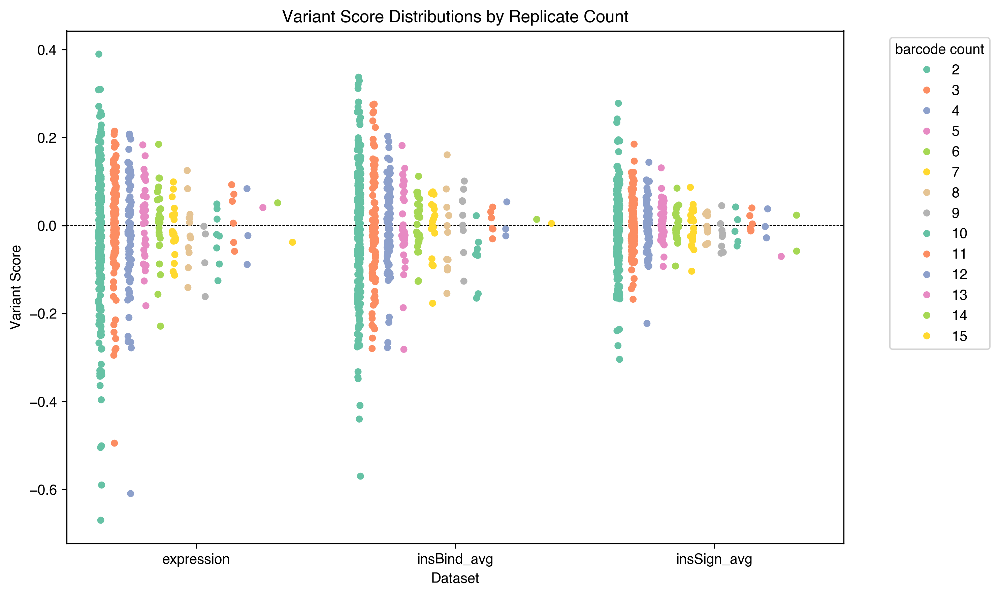

In [73]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Standardize the replicate count column name
df1 = variants_score_dict['a07a14_Bind_avg'].copy()
df1['Source'] = 'expression'
df1 = df1.rename(columns={'a07a14_Bind_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['a07BindR1', 'a07BindR2', 'a14BindR1', 'a14BindR2']].dropna() #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df1 = df1.sort_values(by='variant_score', ascending=True)
df1 = df1.merge(aa_counts, on='aa_substitutions', how='left')
df1['bc_count'] = df1['bc_count'].fillna(0).astype(int)
df1=df1[df1['bc_count']>1]
#df1=df1[df1['FDRvalues']<0.05]
#=========================================================================================

df2 = variants_score_dict['insBind_avg'].copy()
df2['Source'] = 'insBind_avg'
df2 = df2.rename(columns={'insBind_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['insBindR1', 'insBindR2']].dropna() #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df2 = df2.sort_values(by='variant_score', ascending=True)
df2 = df2.merge(aa_counts, on='aa_substitutions', how='left')
df2['bc_count'] = df2['bc_count'].fillna(0).astype(int)
df2=df2[df2['bc_count']>1]
#df2=df2[df2['FDRvalues']<0.05]

#=========================================================================================

df3 = variants_score_dict['insSign_avg'].copy()
df3['Source'] = 'insSign_avg'
df3 = df3.rename(columns={'insSign_avg_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5']].dropna()  #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df3 = df3.sort_values(by='variant_score', ascending=True)
df3 = df3.merge(aa_counts, on='aa_substitutions', how='left')
df3['bc_count'] = df3['bc_count'].fillna(0).astype(int)
df3=df3[df3['bc_count']>1]
#df3=df3[df3['FDRvalues']<0.05]

# Combine
combined_df = pd.concat([df1, df2, df3], ignore_index=True)

# Plot with hue based on replicate count
plt.figure(figsize=(10, 6))
sns.stripplot(data=combined_df, x='Source', y='variant_score', hue='bc_count', jitter=True, dodge=True, palette='Set2')

# Annotate variants with score < -0.3
# Annotate points with variant_score < -0.3
subset = combined_df[combined_df['variant_score'] < -0.3]

# Map source names to categorical x positions
source_to_x = {'insBind_avg': 0, 'insSign_avg': 1, 'expression': 2}


    
# Styling
plt.title('Variant Score Distributions by Replicate Count')
plt.ylabel('Variant Score')
plt.xlabel('Dataset')
plt.axhline(y=0, color='black', linestyle='--', linewidth=0.5)
plt.legend(title='barcode count', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

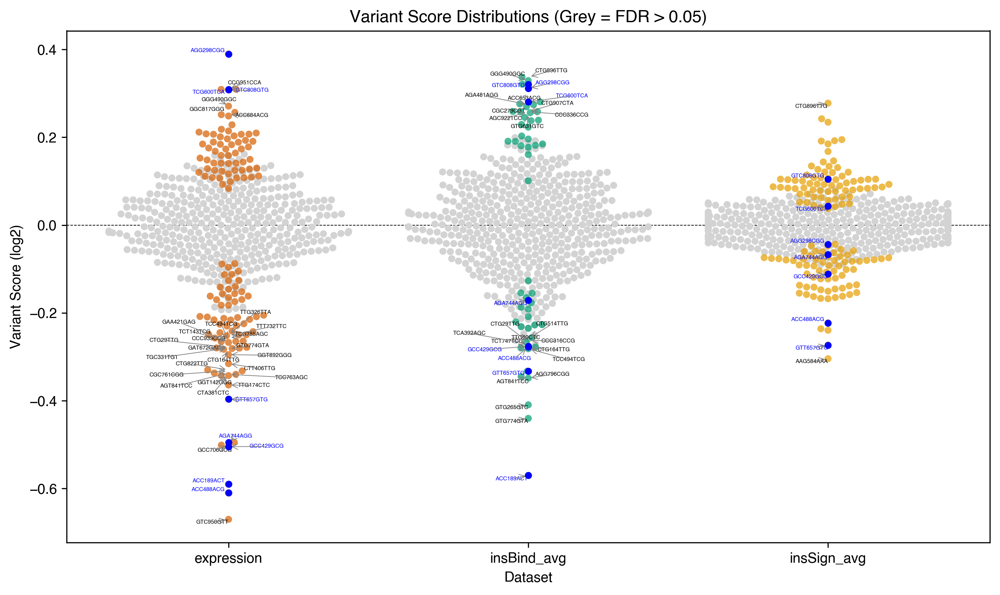

In [75]:
# Standardize the replicate count column name
df1 = variants_score_dict['a07a14_Bind_avg'].copy()
df1['Source'] = 'expression'
df1 = df1.rename(columns={'a07a14_Bind_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['a07BindR1', 'a07BindR2', 'a14BindR1', 'a14BindR2']].dropna() #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df1 = df1.sort_values(by='variant_score', ascending=True)
df1 = df1.merge(aa_counts, on='aa_substitutions', how='left')
df1['bc_count'] = df1['bc_count'].fillna(0).astype(int)
df1=df1[df1['bc_count']>1]
#df1=df1[df1['FDRvalues']<0.05]
#=========================================================================================

df2 = variants_score_dict['insBind_avg'].copy()
df2['Source'] = 'insBind_avg'
df2 = df2.rename(columns={'insBind_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['insBindR1', 'insBindR2']].dropna() #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df2 = df2.sort_values(by='variant_score', ascending=True)
df2 = df2.merge(aa_counts, on='aa_substitutions', how='left')
df2['bc_count'] = df2['bc_count'].fillna(0).astype(int)
df2=df2[df2['bc_count']>1]
#df2=df2[df2['FDRvalues']<0.05]

#=========================================================================================

df3 = variants_score_dict['insSign_avg'].copy()
df3['Source'] = 'insSign_avg'
df3 = df3.rename(columns={'insSign_avg_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5']].dropna()  #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df3 = df3.sort_values(by='variant_score', ascending=True)
df3 = df3.merge(aa_counts, on='aa_substitutions', how='left')
df3['bc_count'] = df3['bc_count'].fillna(0).astype(int)
df3=df3[df3['bc_count']>1]
#df3=df3[df3['FDRvalues']<0.05]
# Combine
combined_df = pd.concat([df1, df2, df3], ignore_index=True)

# Create color column based on FDR
combined_df['color'] = combined_df['FDRvalues'].apply(lambda x: 'lightgrey' if x > 0.05 else None)

# Create the base plot
plt.figure(figsize=(10, 6))

# Plot variants with FDR > 0.05 (in grey)
sns.swarmplot(data=combined_df[combined_df['FDRvalues'] > 0.05], x='Source', y='variant_score', color='lightgrey', label='FDR > 0.05')

# Plot variants with FDR <= 0.05 using Set2 palette
sns.swarmplot(data=combined_df[combined_df['FDRvalues'] <= 0.05], x='Source', y='variant_score', palette=['#D55E00',  '#009E73', '#E69F00',], label='FDR ≤ 0.05', alpha=0.7)

# Map source names to categorical x-axis positions
source_to_x = {'insBind_avg': 1, 'insSign_avg': 2, 'expression': 0}

# Define variants to always highlight in red
highlight_variants = ['ACC488ACG', 'GTT657GTG', 'AGA744AGG', 'ACC189ACT', 'TCG600TCA', 'AGG298CGG', 'GTC808GTG', 'GCC429GCG']

# Define subset to annotate (extreme scores or highlighted)
subset = combined_df[
    (combined_df['variant_score'] < -0.25) |
    (combined_df['variant_score'] > 0.25) |
    (combined_df['aa_substitutions'].isin(highlight_variants))
]

texts = []
for _, row in subset.iterrows():
    x = source_to_x[row['Source']]
    y = row['variant_score']
    aa = row['aa_substitutions']

    is_highlight = aa in highlight_variants

    # Overlay blue marker if it's a highlight variant
    if is_highlight:
        plt.plot(x, y, 'o', color='blue', markersize=4, zorder=10)

    # Annotate
    text_color = 'blue' if is_highlight else 'black'
    text = plt.text(x, y, aa, fontsize=4, ha='center', va='center', color=text_color)
    texts.append(text)

# Adjust annotation positions to reduce overlap
adjust_text(
    texts,
    arrowprops=dict(arrowstyle="->", color='gray', lw=0.5),
    expand_points=(1.2, 1.4),
    expand_text=(1.2, 1.4),
    force_text=0.75,
    force_points=0.2,
    only_move={'points': 'y', 'text': 'xy'},
)

# Styling
plt.title('Variant Score Distributions (Grey = FDR > 0.05)')
plt.ylabel('Variant Score (log2)')
plt.xlabel('Dataset')
plt.axhline(y=0, color='black', linestyle='--', linewidth=0.5)
plt.legend([], [], frameon=False)  # Optional: custom legend if needed
plt.tight_layout()
plt.savefig('results/figures/synonymous/synonymous_scatter_plot.pdf')
plt.show()

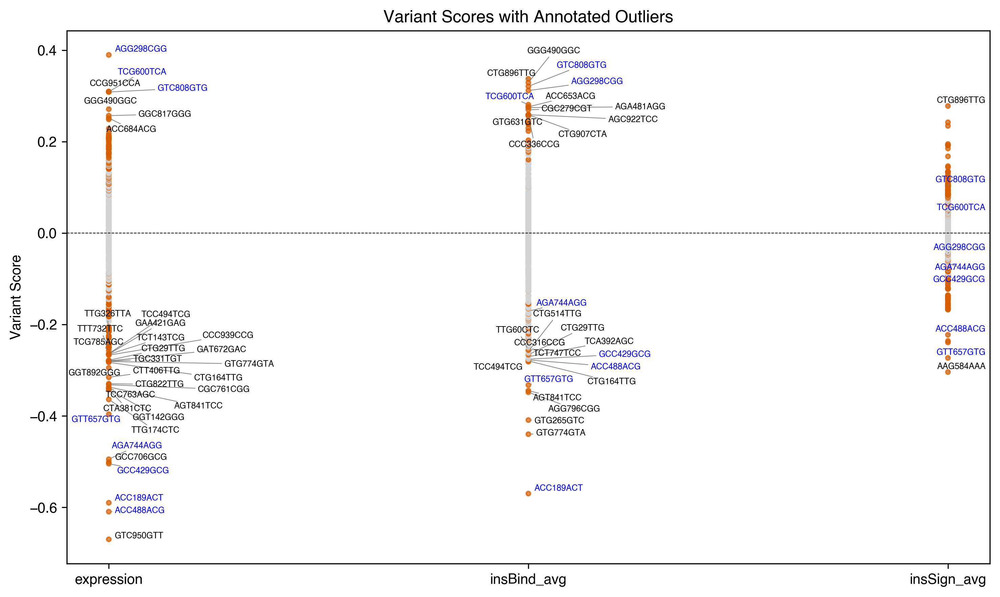

In [91]:
import matplotlib.pyplot as plt
from adjustText import adjust_text

# Map sources to numeric x-axis
source_to_x = {'expression': 0, 'insBind_avg': 1, 'insSign_avg': 2}
combined_df['x_numeric'] = combined_df['Source'].map(source_to_x)

# Color by FDR significance
combined_df['color'] = combined_df['FDRvalues'].apply(lambda x: '#D55E00' if x <= 0.05 else 'lightgrey')

# Start figure
plt.figure(figsize=(10, 6))

# Scatterplot
plt.scatter(
    combined_df['x_numeric'],
    combined_df['variant_score'],
    c=combined_df['color'],
    s=10,
    alpha=0.7
)

# Prepare annotation text
subset = combined_df[
    (combined_df['variant_score'] < -0.25) |
    (combined_df['variant_score'] > 0.25) |
    (combined_df['aa_substitutions'].isin(highlight_variants))
]

texts = []
for _, row in subset.iterrows():
    color = 'blue' if row['aa_substitutions'] in highlight_variants else 'black'
    texts.append(
        plt.text(
            row['x_numeric'],
            row['variant_score'],
            row['aa_substitutions'],
            fontsize=6,
            color=color
        )
    )

# Use adjust_text to avoid overlaps
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.5))

# Plot aesthetics
plt.axhline(0, linestyle='--', color='black', linewidth=0.5)
plt.xticks([0, 1, 2], ['expression', 'insBind_avg', 'insSign_avg'])
plt.ylabel('Variant Score')
plt.title('Variant Scores with Annotated Outliers')
plt.tight_layout()

# Save and show
plt.savefig('results/figures/synonymous/adjusted_scatter_plot.pdf')
plt.show()

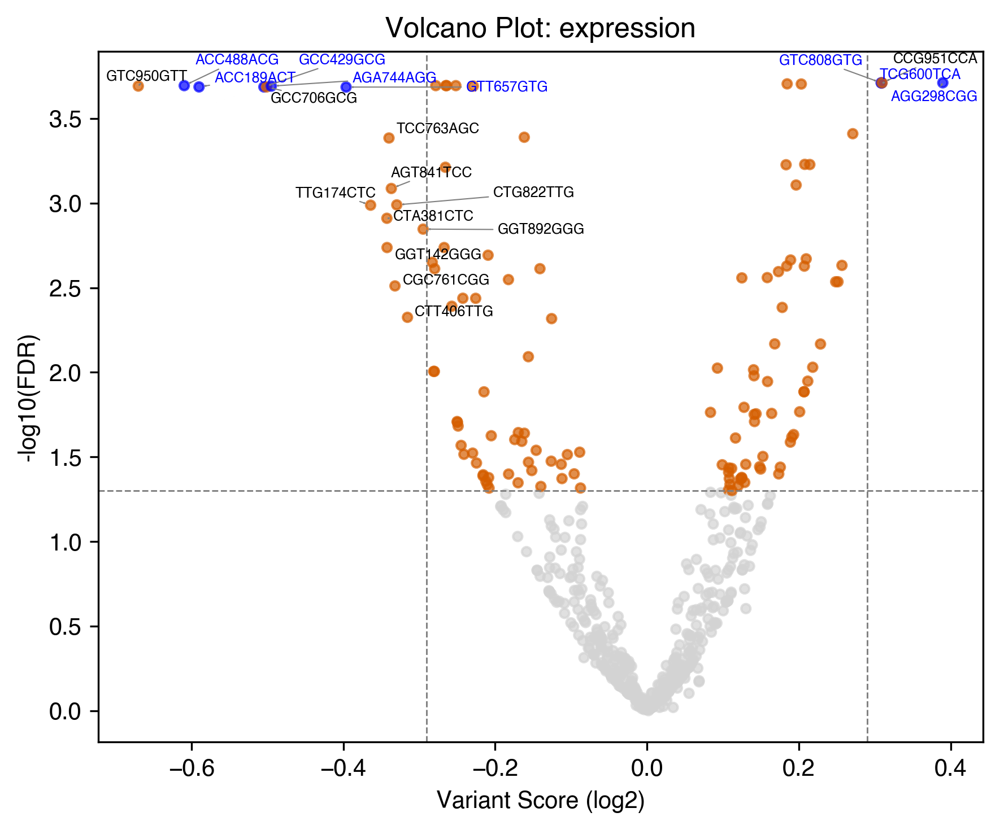

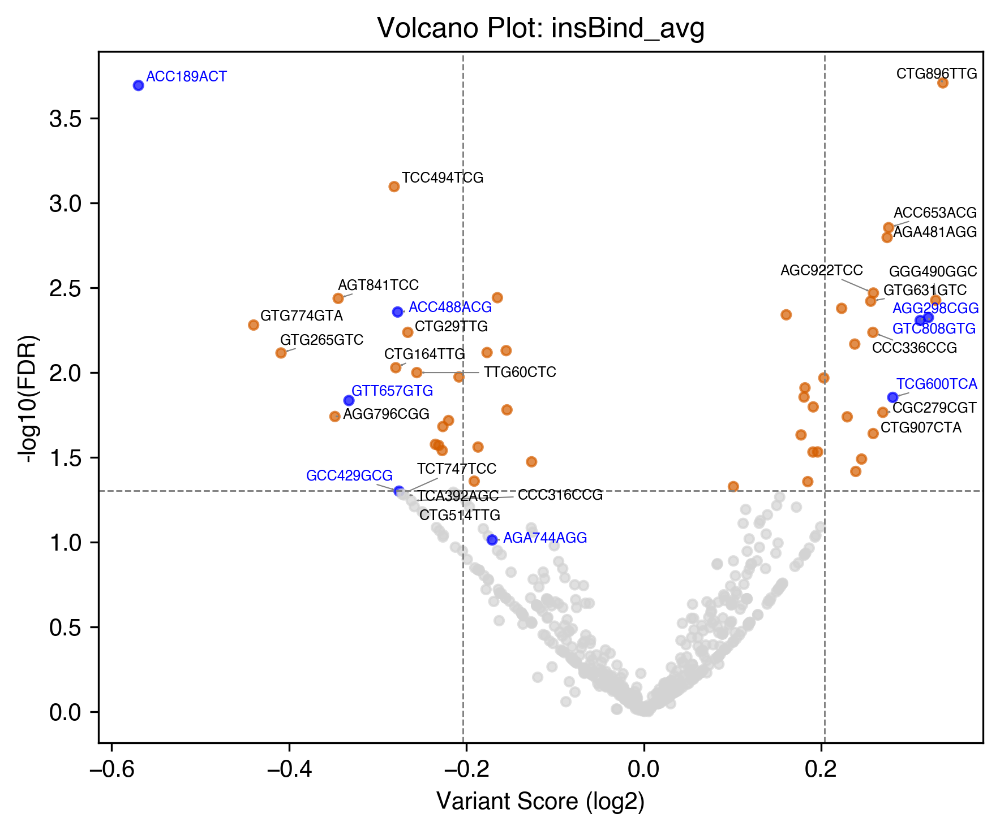

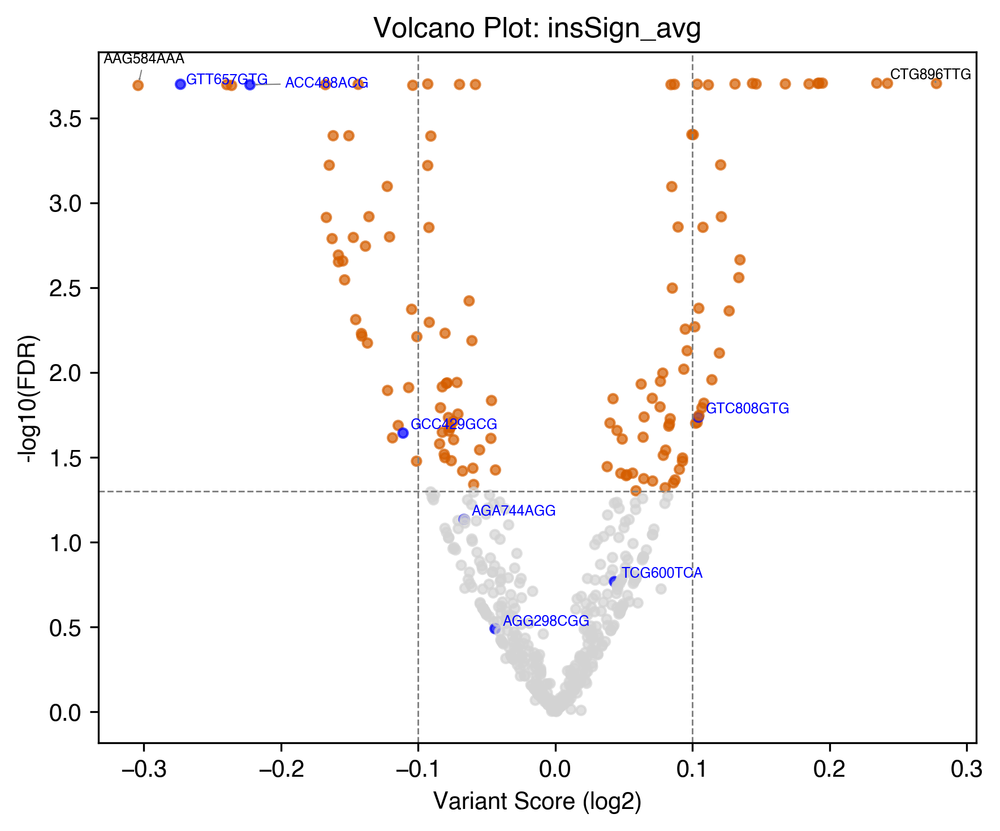

In [96]:
import matplotlib.pyplot as plt
from adjustText import adjust_text
import numpy as np

# Define highlight variants
highlight_variants = ['ACC488ACG', 'GTT657GTG', 'AGA744AGG', 'ACC189ACT', 'TCG600TCA', 'AGG298CGG', 'GTC808GTG', 'GCC429GCG']

def volcano_plot(df, source_name):
    plt.figure(figsize=(6,5))
    subset = df[df['Source'] == source_name]

    epsilon = 1e-10
    neg_log_fdr = -np.log10(subset['FDRvalues'] + epsilon)

    # Assign colors: blue for highlight variants, else orange if significant, else lightgrey
    colors = []
    for i, row in subset.iterrows():
        if row['aa_substitutions'] in highlight_variants:
            colors.append('blue')
        elif row['FDRvalues'] <= 0.05:
            colors.append('#D55E00')  # orange/red for significant
        else:
            colors.append('lightgrey')

    plt.scatter(subset['variant_score'], neg_log_fdr, c=colors, alpha=0.7, s=15)

    # Set vertical line threshold for plotting
    if source_name == 'expression':
        v_thresh = 0.29
    elif source_name == 'insBind_avg':
        v_thresh = 0.204
    elif source_name == 'insSign_avg':
        v_thresh = 0.1
    else:
        v_thresh = 0.25  # fallback

    # Threshold lines
    plt.axhline(-np.log10(0.05), color='grey', linestyle='--', linewidth=0.7)
    plt.axvline(v_thresh, color='grey', linestyle='--', linewidth=0.7)
    plt.axvline(-v_thresh, color='grey', linestyle='--', linewidth=0.7)

    # Set annotation thresholds
    if source_name in ['insBind_avg', 'insSign_avg']:
        annotate_thresh = 0.25
    else:
        annotate_thresh = v_thresh

    # Annotate extreme variants
    to_annotate = subset[
        (subset['variant_score'] > annotate_thresh) |
        (subset['variant_score'] < -annotate_thresh) |
        (subset['aa_substitutions'].isin(highlight_variants))
    ]

    texts = []
    for _, row in to_annotate.iterrows():
        color = 'blue' if row['aa_substitutions'] in highlight_variants else 'black'
        texts.append(
            plt.text(row['variant_score'], -np.log10(row['FDRvalues'] + epsilon), row['aa_substitutions'], fontsize=6, color=color)
        )

    adjust_text(texts, arrowprops=dict(arrowstyle='->', color='gray', lw=0.5))

    plt.xlabel('Variant Score (log2)')
    plt.ylabel('-log10(FDR)')
    plt.title(f'Volcano Plot: {source_name}')
    plt.tight_layout()
    plt.show()

# Plot all three sources
for source in ['expression', 'insBind_avg', 'insSign_avg']:
    volcano_plot(combined_df, source)

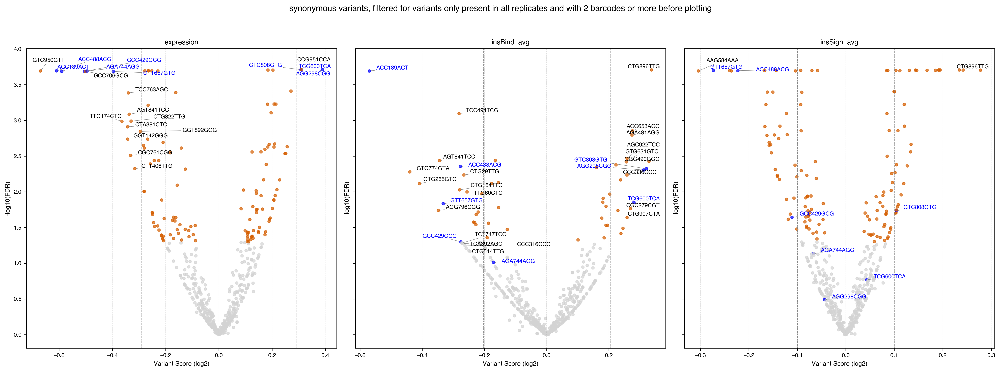

In [115]:
# Standardize the replicate count column name
df1 = variants_score_dict['a07a14_Bind_avg'].copy()
df1['Source'] = 'expression'
df1 = df1.rename(columns={'a07a14_Bind_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['a07BindR1', 'a07BindR2', 'a14BindR1', 'a14BindR2']].dropna() #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df1 = df1.sort_values(by='variant_score', ascending=True)
df1 = df1.merge(aa_counts, on='aa_substitutions', how='left')
df1['bc_count'] = df1['bc_count'].fillna(0).astype(int)
df1=df1[df1['bc_count']>1]
#df1=df1[df1['FDRvalues']<0.05]
#=========================================================================================

df2 = variants_score_dict['insBind_avg'].copy()
df2['Source'] = 'insBind_avg'
df2 = df2.rename(columns={'insBind_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['insBindR1', 'insBindR2']].dropna() #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df2 = df2.sort_values(by='variant_score', ascending=True)
df2 = df2.merge(aa_counts, on='aa_substitutions', how='left')
df2['bc_count'] = df2['bc_count'].fillna(0).astype(int)
df2=df2[df2['bc_count']>1]
#df2=df2[df2['FDRvalues']<0.05]

#=========================================================================================

df3 = variants_score_dict['insSign_avg'].copy()
df3['Source'] = 'insSign_avg'
df3 = df3.rename(columns={'insSign_avg_RepCont': 'RepCont'})  # Adjust if different
d1 = bc_score[['insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5']].dropna()  #this check if present in all replicates
d1 = d1.groupby(bc_score['aa_substitutions']).size()
aa_counts = d1.reset_index(name='bc_count')
df3 = df3.sort_values(by='variant_score', ascending=True)
df3 = df3.merge(aa_counts, on='aa_substitutions', how='left')
df3['bc_count'] = df3['bc_count'].fillna(0).astype(int)
df3=df3[df3['bc_count']>1]
#df3=df3[df3['FDRvalues']<0.05]
# Combine
combined_df = pd.concat([df1, df2, df3], ignore_index=True)


# Define highlight variants
highlight_variants = ['ACC488ACG', 'GTT657GTG', 'AGA744AGG', 'ACC189ACT', 'TCG600TCA', 'AGG298CGG', 'GTC808GTG', 'GCC429GCG']

def volcano_plot(ax, df, source_name):
    subset = df[df['Source'] == source_name]
    epsilon = 1e-10
    neg_log_fdr = -np.log10(subset['FDRvalues'] + epsilon)

    # Assign colors: blue for highlight variants, else orange if significant, else lightgrey
    colors = []
    for _, row in subset.iterrows():
        if row['aa_substitutions'] in highlight_variants:
            colors.append('blue')
        elif row['FDRvalues'] <= 0.05:
            colors.append('#D55E00')  # orange/red for significant
        else:
            colors.append('lightgrey')

    ax.scatter(subset['variant_score'], neg_log_fdr, c=colors, alpha=0.7, s=15)
    ax.grid(axis='x', linestyle='--', linewidth=0.5, alpha=0.5)


    # Set vertical threshold for plotting
    if source_name == 'expression':
        v_thresh = 0.29
    elif source_name == 'insBind_avg':
        v_thresh = 0.204
    elif source_name == 'insSign_avg':
        v_thresh = 0.1
    else:
        v_thresh = 0.25

    # Draw threshold lines
    ax.axhline(-np.log10(0.05), color='grey', linestyle='--', linewidth=0.7)
    ax.axvline(v_thresh, color='grey', linestyle='--', linewidth=0.7)
    ax.axvline(-v_thresh, color='grey', linestyle='--', linewidth=0.7)

    # Set annotation threshold
    if source_name in ['insBind_avg', 'insSign_avg']:
        annotate_thresh = 0.25
    else:
        annotate_thresh = v_thresh

    # Annotate variants
    to_annotate = subset[
        (subset['variant_score'] > annotate_thresh) |
        (subset['variant_score'] < -annotate_thresh) |
        (subset['aa_substitutions'].isin(highlight_variants))
    ]

    texts = []
    for _, row in to_annotate.iterrows():
        color = 'blue' if row['aa_substitutions'] in highlight_variants else 'black'
        texts.append(
            ax.text(row['variant_score'], -np.log10(row['FDRvalues'] + epsilon), row['aa_substitutions'], fontsize=8, color=color)
        )

    adjust_text(texts, ax=ax, arrowprops=dict(arrowstyle='->', color='gray', lw=0.5))

    ax.set_xlabel('Variant Score (log2)', fontsize=9)
    ax.set_ylabel('-log10(FDR)', fontsize=9)
    ax.set_title(source_name, fontsize=10)
    ax.tick_params(labelsize=8)

# Create subplots: 1 row, 3 columns
fig, axes = plt.subplots(1, 3, figsize=(20, 7.5), sharey=True)

# Plot each source in its corresponding axis
for ax, source in zip(axes, ['expression', 'insBind_avg', 'insSign_avg']):
    volcano_plot(ax, combined_df, source)

# Global title
plt.suptitle("synonymous variants, filtered for variants only present in all replicates and with 2 barcodes or more before plotting", fontsize=12)

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit suptitle
plt.savefig('results/figures/synonymous/adjusted_scatter_plot.pdf')

plt.show()

In [ ]:
save_dir = 'results/figures/volcano/'
os.makedirs(save_dir, exist_ok=True)

funcVariants_all=pd.read_csv('input_files/functional_variants.csv')
N_linked_glucosylation_variants
# Calculate number of rows needed to accommodate all plots
mylist = [ 'a07a14_Bind_avg', 'insBind_avg', 'insSign_avg']

for i, analysis in enumerate(mylist):
    df = variants_score_dict[analysis]
    df['-log10_FDRvalues'] = df['FDRvalues'].apply(lambda x: -np.log10(x))
    
    if analysis=='insBind_avg':
        df=df[df['insBind_RepCont']==2]
        lims=[-1,0.5]
        
    if analysis=='insSign_avg':
        df=df[df['insSign_RepCont']>2]
        lims=[-0.75,0.35]
        
    if analysis=='a07a14_Bind_avg':
        df=df[df['a07a14_Bind_RepCont']>=2]
        lims=[-1.3,0.4]
    
    fig, ax = plt.subplots(figsize=(5, 5))
    sns.scatterplot(data=df, x='variant_score', y='-log10_FDRvalues', ax=ax, color='lightgrey')
    ax.set_title(name_map[analysis], size=18)  # Set title for each subplot
    ax.axhline(-np.log10(0.05), color='red', linestyle='--', linewidth=1)  # FDR threshold
    ax.axvline(0, linestyle='--', linewidth=1)
    ax.set_xlabel('Variant Score', size=18)  # Set x-axis label
    ax.set_ylabel('FDR (-log10)', size=18)  # Set y-axis label
    ax.tick_params(axis='both', which='major', length=4, width=0.8, labelsize=17)
    ax.invert_yaxis()
    ax.set_ylim(-0.5, 4.5)
    ax.set_xlim(lims[0], lims[1])

    

    if analysis in ['insBind_avg', 'insSign_avg','a07a14_Bind_avg']:
       
        funcVariants = df[df['aa_substitutions'].isin(N_linked_glucosylation_variants)].dropna(subset=['variant_score'])
        sns.scatterplot(data=funcVariants, x='variant_score', y='-log10_FDRvalues', alpha=0.7, ax=ax)
        ax.invert_yaxis()
    
        texts = []
        for index, row in funcVariants.iterrows():
            texts.append(ax.text(row['variant_score'], row['-log10_FDRvalues'], row['aa_substitutions'],
                              fontsize=5, ha='left', va='bottom'))
        ax.invert_yaxis()
        adjust_text(texts, ax=ax, arrowprops=dict(arrowstyle='->', color='black'))




    plt.tight_layout()
    #subplot_save_path = os.path.join(save_dir, f'{analysis}_VolcanoPlot.png')
    plt.show()
    #plt.savefig(subplot_save_path, dpi=300)
    
    #plt.close()  # Close the current figure to release memory    

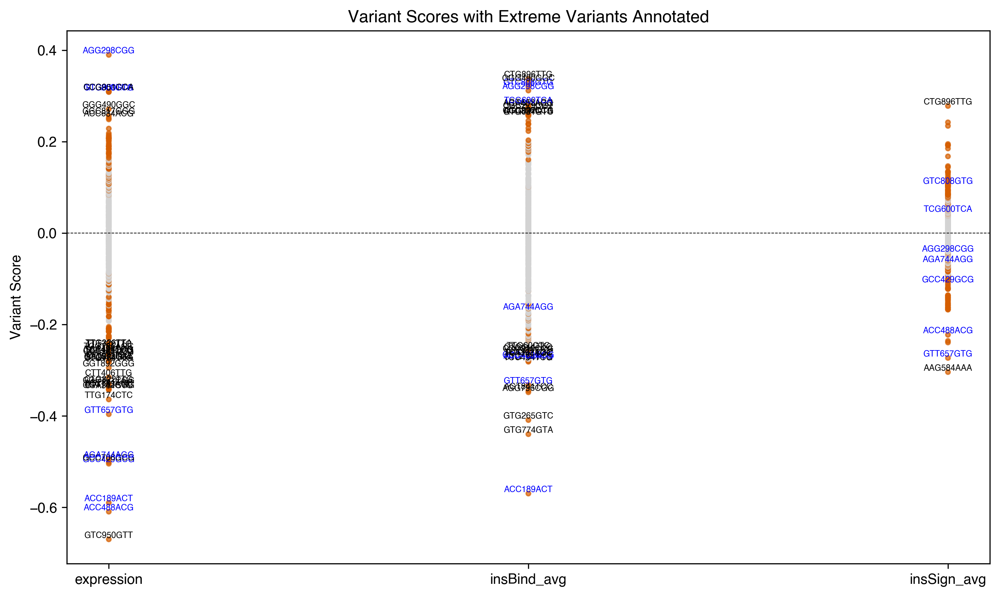

In [89]:
source_to_x = {'expression': 0, 'insBind_avg': 1, 'insSign_avg': 2}
combined_df['x_numeric'] = combined_df['Source'].map(source_to_x)

plt.figure(figsize=(10, 6))
colors = combined_df['FDRvalues'].apply(lambda x: 'lightgrey' if x > 0.05 else '#D55E00')

plt.scatter(
    combined_df['x_numeric'],
    combined_df['variant_score'],
    c=colors,
    s=10,
    alpha=0.7
)

# Annotate
subset = combined_df[
    (combined_df['variant_score'] < -0.25) |
    (combined_df['variant_score'] > 0.25) |
    (combined_df['aa_substitutions'].isin(highlight_variants))
]

for _, row in subset.iterrows():
    x = row['x_numeric']
    y = row['variant_score']
    label = row['aa_substitutions']
    color = 'blue' if label in highlight_variants else 'black'
    plt.text(x, y, label, fontsize=6, ha='center', va='bottom', color=color)

plt.axhline(0, linestyle='--', color='black', linewidth=0.5)
plt.xticks([0, 1, 2], ['expression', 'insBind_avg', 'insSign_avg'])
plt.ylabel('Variant Score')
plt.title('Variant Scores with Extreme Variants Annotated')
plt.tight_layout()
plt.savefig('results/figures/synonymous/simple_scatter_plot.pdf')
plt.show()

<Axes: xlabel='Source', ylabel='variant_score'>

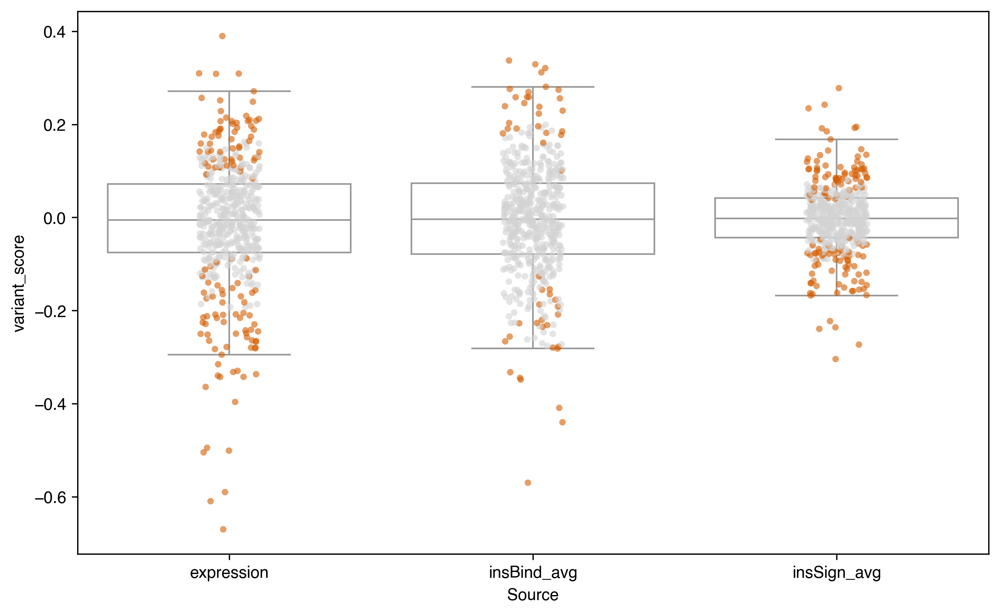

In [90]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=combined_df, x='Source', y='variant_score', whis=1.5, fliersize=0, color='white', linewidth=1)

# Overlaid scatter
sns.stripplot(
    data=combined_df,
    x='Source',
    y='variant_score',
    size=4,
    jitter=True,
    alpha=0.6,
    hue=combined_df['FDRvalues'] <= 0.05,
    palette={True: '#D55E00', False: 'lightgrey'},
    dodge=False,
    legend=False
)

# Annotation same as before...

In [120]:
# Step 1: Group and count barcode scores by 'aa_substitutions' in bc_score dataframe
# Selecting specific columns and dropping rows with any NaNs in them
d1 = bc_score[['a07BindR1', 'a07BindR2', 'a14BindR1', 'a14BindR2']].dropna()

# Count how many rows per 'aa_substitutions'
# Assuming 'aa_substitutions' is an index or column in bc_score; 
# if not, adjust accordingly (e.g. bc_score['aa_substitutions'])
d1 = d1.groupby(bc_score['aa_substitutions']).size()

# Convert series to dataframe for merging
aa_counts = d1.reset_index(name='size')

# Step 2: Get top 20 variants sorted by variant_score
d2 = variants_score_dict['a07a14_Bind_avg'].sort_values(by='variant_score', ascending=True)

# Step 3: Merge the counts from aa_counts into d2 on 'aa_substitutions'
d2 = d2.merge(aa_counts, on='aa_substitutions', how='left')

# Step 4: Replace missing counts with 0 and convert to int
d2['size'] = d2['size'].fillna(0).astype(int)

# Now d2 contains a new column 'size' showing the count from bc_score groupby
d2=d2[d2['size'] > 1]
d2.sort_values(by='variant_score', ascending=True, inplace=True)
d2.head(50)

print ('expression')
d2[d2['aa_substitutions'].isin(['ACC488ACG','GTT657GTG','AGA744AGG'])]


expression


,aa_substitutions,variant_score,a07a14_Bind_RepCont,FDRvalues,size
24,ACC488ACG,-0.609523,4.0,0.000202,4
42,AGA744AGG,-0.494830,4.0,0.000204,3
58,GTT657GTG,-0.396313,4.0,0.000206,2


In [117]:
# Step 1: Group and count barcode scores by 'aa_substitutions' in bc_score dataframe
# Selecting specific columns and dropping rows with any NaNs in them
d1 = bc_score[['insBindR1', 'insBindR2']].dropna()

# Count how many rows per 'aa_substitutions'
# Assuming 'aa_substitutions' is an index or column in bc_score; 
# if not, adjust accordingly (e.g. bc_score['aa_substitutions'])
d1 = d1.groupby(bc_score['aa_substitutions']).size()

# Convert series to dataframe for merging
aa_counts = d1.reset_index(name='size')

# Step 2: Get top 20 variants sorted by variant_score
d2 = variants_score_dict['insBind_avg'].sort_values(by='variant_score', ascending=True)

# Step 3: Merge the counts from aa_counts into d2 on 'aa_substitutions'
d2 = d2.merge(aa_counts, on='aa_substitutions', how='left')

# Step 4: Replace missing counts with 0 and convert to int
d2['size'] = d2['size'].fillna(0).astype(int)

# Now d2 contains a new column 'size' showing the count from bc_score groupby
d2=d2[d2['size'] > 1]
d2.sort_values(by='variant_score', ascending=True, inplace=True)
d2.head(50)

print ('insulin binding')
d2[d2['aa_substitutions'].isin(['ACC488ACG','GTT657GTG','AGA744AGG'])]



insulin binding


,aa_substitutions,variant_score,insBind_RepCont,FDRvalues,size
58,GTT657GTG,-0.332545,2.0,0.014658,2
77,ACC488ACG,-0.277618,2.0,0.004406,4
161,AGA744AGG,-0.171019,2.0,0.097244,3


In [118]:
# Step 1: Group and count barcode scores by 'aa_substitutions' in bc_score dataframe
# Selecting specific columns and dropping rows with any NaNs in them
d1 = bc_score[['insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5']].dropna()

# Count how many rows per 'aa_substitutions'
# Assuming 'aa_substitutions' is an index or column in bc_score; 
# if not, adjust accordingly (e.g. bc_score['aa_substitutions'])
d1 = d1.groupby(bc_score['aa_substitutions']).size()

# Convert series to dataframe for merging
aa_counts = d1.reset_index(name='size')

# Step 2: Get top 20 variants sorted by variant_score
d2 = variants_score_dict['insSign_avg'].sort_values(by='variant_score', ascending=True)

# Step 3: Merge the counts from aa_counts into d2 on 'aa_substitutions'
d2 = d2.merge(aa_counts, on='aa_substitutions', how='left')

# Step 4: Replace missing counts with 0 and convert to int
d2['size'] = d2['size'].fillna(0).astype(int)

# Now d2 contains a new column 'size' showing the count from bc_score groupby
d2=d2[d2['size'] > 1]
d2.sort_values(by='variant_score', ascending=True, inplace=True)

d2.head(50)
print ('insulin signalling')
d2[d2['aa_substitutions'].isin(['ACC488ACG','GTT657GTG','AGA744AGG'])]


insulin signalling


,aa_substitutions,variant_score,insSign_RepCont,FDRvalues,size
30,GTT657GTG,-0.273263,5.0,0.0002,2
41,ACC488ACG,-0.222629,5.0,0.000201,4
248,AGA744AGG,-0.066507,5.0,0.073337,3


# Prepare for MaveDB submission

In [ ]:
variants_score_maveDB=variants_score.copy()
# Drop variants with stop codons (substitutions ending with '*')
variants_score_maveDB = variants_score_maveDB[~variants_score_maveDB['aa_substitutions'].str.endswith('*')]

for library in ['insBind_avg', 'a07Bind_avg', 'a14Bind_avg', 
                'a07Sign_avg', 'a14Sign_avg', 'insSign_avg',
                'a07a14_Bind_avg']:
    
    dp = variants_score_dict[library]
    dp_s = dp[['aa_substitutions', 'FDRvalues']].copy()
    dp_s.rename(columns={'FDRvalues': f'{library}_FDR'}, inplace=True)
    
    variants_score_maveDB = pd.merge(variants_score_maveDB, dp_s, on='aa_substitutions', how='left')

replicate_cols = [col for col in variants_score_maveDB.columns if col.endswith(('R1', 'R2', 'R3', 'R4', 'R5'))]

# Apply log2 transformation directly
variants_score_maveDB[replicate_cols] = np.log2(variants_score_maveDB[replicate_cols])


variants_score_maveDB = variants_score_maveDB[(variants_score_maveDB['position'] > 27) & (variants_score_maveDB['position'] < 956)]
variants_score_maveDB.sort_values('position',inplace=True)


# Dictionary to map 1-letter to 3-letter amino acid codes
aa_dict = {
    'A': 'Ala', 'R': 'Arg', 'N': 'Asn', 'D': 'Asp', 'C': 'Cys',
    'Q': 'Gln', 'E': 'Glu', 'G': 'Gly', 'H': 'His', 'I': 'Ile',
    'L': 'Leu', 'K': 'Lys', 'M': 'Met', 'F': 'Phe', 'P': 'Pro',
    'S': 'Ser', 'T': 'Thr', 'W': 'Trp', 'Y': 'Tyr', 'V': 'Val',
    '*': 'Ter'
}

# Example: assume aa_substitutions is in your DataFrame `variants_score_maveDB`
three_letter_substitutions = []

for variant in variants_score_maveDB['aa_substitutions']:
    ref = variant[0]
    pos = ''.join(filter(str.isdigit, variant))
    alt = variant[-1]
    three_letter = f"p.{aa_dict.get(ref, ref)}{pos}{aa_dict.get(alt, alt)}"
    three_letter_substitutions.append(three_letter)

# Add the converted variants to a new column
variants_score_maveDB['hgvs_pro'] = three_letter_substitutions

variants_score_maveDB.drop(
    columns=[ 'position','aa_substitutions','insSign_RepCont', 'a07a14_Bind_RepCont', 'insBind_RepCont', 'a07Sign_RepCont', 'a14Sign_RepCont'],
    inplace=True)

#=====================================================
# Generate all single substitutions from position 0 to 955
insr_pro = "MATGGRRGAAAAPLLVAVAALLLGAAGHLYPGEVCPGMDIRNNLTRLHELENCSVIEGHLQILLMFKTRPEDFRDLSFPKLIMITDYLLLFRVYGLESLKDLFPNLTVIRGSRLFFNYALVIFEMVHLKELGLYNLMNITRGSVRIEKNNELCYLATIDWSRILDSVEDNYIVLNKDDNEECGDICPGTAKGKTNCPATVINGQFVERCWTHSHCQKVCPTICKSHGCTAEGLCCHSECLGNCSQPDDPTKCVACRNFYLDGRCVETCPPPYYHFQDWRCVNFSFCQDLHHKCKNSRRQGCHQYVIHNNKCIPECPSGYTMNSSNLLCTPCLGPCPKVCHLLEGEKTIDSVTSAQELRGCTVINGSLIINIRGGNNLAAELEANLGLIEEISGYLKIRRSYALVSLSFFRKLRLIRGETLEIGNYSFYALDNQNLRQLWDWSKHNLTITQGKLFFHYNPKLCLSEIHKMEEVSGTKGRQERNDIALKTNGDQASCENELLKFSYIRTSFDKILLRWEPYWPPDFRDLLGFMLFYKEAPYQNVTEFDGQDACGSNSWTVVDIDPPLRSNDPKSQNHPGWLMRGLKPWTQYAIFVKTLVTFSDERRTYGAKSDIIYVQTDATNPSVPLDPISVSNSSSQIILKWKPPSDPNGNITHYLVFWERQAEDSELFELDYCLKGLKLPSRTWSPPFESEDSQKHNQSEYEDSAGECCSCPKTDSQILKELEESSFRKTFEDYLHNVVFVPRKTSSGTGAEDPRPSRKRRSLGDVGNVTVAVPTVAAFPNTSSTSVPTSPEEHRPFEKVVNKESLVISGLRHFTGYRIELQACNQDTPEERCSVAAYVSARTMPEAKADDIVGPVTHEIFENNVVHLMWQEPKEPNGLIVLYEVSYRRYGDEELHLCVSRKHFALERGCRLRGLSPGNYSVRIRATSLAGNGSWTEPTYFYVTDYLDVPSNIA"

substitutions = []
for i in range(0, 955):  # 
    ref_aa = insr_pro[i]
    pos = i + 1
    for alt_aa in aa_dict.keys():
        if alt_aa != ref_aa:
            hgvs = f"p.{aa_dict[ref_aa]}{pos}{aa_dict[alt_aa]}"
            substitutions.append({'hgvs_pro': hgvs})

# Create DataFrame
all_variants_df = pd.DataFrame(substitutions)
#=====================================================


ins_bind=variants_score_maveDB[['hgvs_pro', 'insBind_avg', 'insBind_avg_FDR', 'insBindR1','insBindR2']]
ins_bind.rename(columns={'insBind_avg': 'score'}, inplace=True)
ins_bind.rename(columns={'insBind_avg_FDR': 'FDR'}, inplace=True)
ins_bind['score'] = np.log2(ins_bind['score'])

a07Bind=variants_score_maveDB[['hgvs_pro', 'a07Bind_avg', 'a07Bind_avg_FDR', 'a07BindR1','a07BindR2']]
a07Bind.rename(columns={'a07Bind_avg': 'score'}, inplace=True)
a07Bind.rename(columns={'a07Bind_avg_FDR': 'FDR'}, inplace=True)
a07Bind

a14Bind=variants_score_maveDB[['hgvs_pro', 'a14Bind_avg', 'a14Bind_avg_FDR', 'a14BindR1','a14BindR2']]
a14Bind.rename(columns={'a14Bind_avg': 'score'}, inplace=True)
a14Bind.rename(columns={'a14Bind_avg_FDR': 'FDR'}, inplace=True)
a14Bind

a07Sign = variants_score_maveDB[['hgvs_pro', 'a07Sign_avg', 'a07Sign_avg_FDR', 'a07SignR1', 'a07SignR2', 'a07SignR3']]
a07Sign.rename(columns={'a07Sign_avg': 'score'}, inplace=True)
a07Sign.rename(columns={'a07Sign_avg_FDR': 'FDR'}, inplace=True)
a07Sign

a14Sign = variants_score_maveDB[['hgvs_pro', 'a14Sign_avg', 'a14Sign_avg_FDR', 'a14SignR1', 'a14SignR2', 'a14SignR3']]
a14Sign.rename(columns={'a14Sign_avg': 'score'}, inplace=True)
a14Sign.rename(columns={'a14Sign_avg_FDR': 'FDR'}, inplace=True)

insSign = variants_score_maveDB[['hgvs_pro', 'insSign_avg', 'insSign_avg_FDR', 'insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5']]
insSign.rename(columns={'insSign_avg': 'score'}, inplace=True)
insSign.rename(columns={'insSign_avg_FDR': 'FDR'}, inplace=True)

a07a14_Bind = variants_score_maveDB[['hgvs_pro', 'a07a14_Bind_avg', 'a07a14_Bind_avg_FDR', 'a07BindR1','a07BindR2', 'a14BindR1','a14BindR2']]
a07a14_Bind.rename(columns={'a07a14_Bind_avg': 'score'}, inplace=True)
a07a14_Bind.rename(columns={'a07a14_Bind_avg_FDR': 'FDR'}, inplace=True)


In [ ]:
"""This function, prepare_and_normalize, is designed to process and normalize variant effect scores from a functional genomics
 dataset, particularly in the context of multiplexed assays of variant effect (MAVE). It takes a DataFrame containing variant 
 scores (df), a reference dataset of all possible variants (all_variants_df), a list of score column names (score_cols), and a 
label or condition name (name). The function begins by renaming the relevant columns for consistency and clarity. It then adds 
placeholder columns for nucleotide-level and splice-level annotations, which may be filled in later. Next, the function merges 
the variant data with a comprehensive list of all variants (all_variants_df) based on the protein-level mutation descriptor 
(hgvs_pro). Any missing values after the merge are filled with ‘NA’ to maintain consistency. The core of the function lies in
 its normalization strategy. For each score column, negative scores are left unchanged to preserve their scale. Positive scores 
 are rescaled so that their maximum value matches the absolute value of the most negative score. This results in a symmetrical 
 range centered around zero: neutral or wild-type–like variants are close to zero, deleterious variants span the negative side 
 (e.g., down to -1.4), and activating variants are scaled up to match that same range on the positive side (e.g., up to +1.4). 
 This piecewise normalization ensures interpretability and comparability of scores across different types of variants. Finally, 
 the processed and normalized data are saved as a CSV file, named according to the condition (name), and returned for downstream analysis.
"""

def prepare_and_normalize(df, all_variants_df, score_cols, name):
    # Rename columns
    df = df.rename(columns={
        f'{name}_avg': 'score',
        f'{name}_avg_FDR': 'FDR'
    })    

    # Add placeholder annotation columns
    df['hgvs_nt'] = 'NA'
    df['hgvs_splice'] = 'NA'

    # Merge with reference DataFrame
    merged = pd.merge(all_variants_df, df, on='hgvs_pro', how='left')
    merged.fillna('NA', inplace=True)

    # Convert relevant columns to numeric
    for col in score_cols:
        merged[col] = pd.to_numeric(merged[col], errors='coerce')

    # Piecewise normalization: keep negative scale, adjust positives to match
    for col in score_cols:
        original = merged[col].copy()

        neg_mask = original < 0
        pos_mask = original > 0
        zero_mask = original == 0

        neg_min = original[neg_mask].min()  # Most negative value (e.g., -1.4)
        pos_max = original[pos_mask].max()  # Max positive value

        target_scale = abs(neg_min) if neg_min is not None and neg_min < 0 else 1.0

        norm_col = original.copy()
        norm_col[neg_mask] = original[neg_mask]                   # keep negatives as is
        norm_col[pos_mask] = (original[pos_mask] / pos_max) * target_scale if pos_max != 0 else 0
        norm_col[zero_mask] = 0

        merged[col] = norm_col

    # Save to CSV
    merged.to_csv(f'results/MaveDB_Upload/{name}_scores_MaveDB.csv', index=False)

    return merged


# List of datasets
datasets = [
    (ins_bind, ['score', 'insBindR1', 'insBindR2'], 'insBind'),
    (a07Bind, ['score', 'a07BindR1', 'a07BindR2'], 'a07Bind'),
    (a14Bind, ['score', 'a14BindR1', 'a14BindR2'], 'a14Bind'),
    (a07Sign, ['score', 'a07SignR1', 'a07SignR2', 'a07SignR3'], 'a07Sign'),
    (a14Sign, ['score', 'a14SignR1', 'a14SignR2', 'a14SignR3'], 'a14Sign'),
    (insSign, ['score', 'insSignR1', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5'], 'insSign'),
    (a07a14_Bind, ['score', 'a07BindR1', 'a07BindR2', 'a14BindR1', 'a14BindR2'], 'a07a14_Bind')
]

# Run the processing
for df, score_cols, name, log2_flag in datasets:
    prepare_and_normalize(df, all_variants_df, score_cols, name)



ValueError: not enough values to unpack (expected 4, got 3)

# make volcano plots with variant scores and FDR values, annotate functionally studied variants

In [ ]:
save_dir = 'results/figures/volcano/'
os.makedirs(save_dir, exist_ok=True)

funcVariants_all=pd.read_csv('input_files/functional_variants.csv')

# Calculate number of rows needed to accommodate all plots
mylist = [ 'a07a14_Bind_avg', 'insBind_avg', 'insSign_avg','a07Bind_avg', 'a14Bind_avg',  'a07Sign_avg', 'a14Sign_avg']

for i, analysis in enumerate(mylist):
    df = variants_score_dict[analysis]
    df['-log10_FDRvalues'] = df['FDRvalues'].apply(lambda x: -np.log10(x))
    
    if analysis=='insBind_avg':
        df=df[df['insBind_RepCont']==2]
        lims=[-1,0.5]
        
    if analysis=='insSign_avg':
        df=df[df['insSign_RepCont']>2]
        lims=[-0.75,0.35]
        
    if analysis=='a07a14_Bind_avg':
        df=df[df['a07a14_Bind_RepCont']>=2]
        lims=[-1.3,0.4]
    
    fig, ax = plt.subplots(figsize=(5, 5))
    sns.scatterplot(data=df, x='variant_score', y='-log10_FDRvalues', ax=ax, color='lightgrey')
    ax.set_title(name_map[analysis], size=18)  # Set title for each subplot
    ax.axhline(-np.log10(0.05), color='red', linestyle='--', linewidth=1)  # FDR threshold
    ax.axvline(0, linestyle='--', linewidth=1)
    ax.set_xlabel('Variant Score', size=18)  # Set x-axis label
    ax.set_ylabel('FDR (-log10)', size=18)  # Set y-axis label
    ax.tick_params(axis='both', which='major', length=4, width=0.8, labelsize=17)
    ax.invert_yaxis()
    ax.set_ylim(-0.5, 4.5)
    ax.set_xlim(lims[0], lims[1])

    

    if analysis in ['insBind_avg', 'insSign_avg','a07a14_Bind_avg']:
        funcVariants = funcVariants_all.dropna(subset=[analysis])
        funcVariants = funcVariants.merge(df, on='aa_substitutions')
        funcVariants = funcVariants.dropna(subset=['variant_score'])
        sns.scatterplot(data=funcVariants, x='variant_score', y='-log10_FDRvalues', color=funcVariants[analysis], alpha=0.7, ax=ax)
        ax.invert_yaxis()
        

        texts = []
        for index, row in funcVariants.iterrows():
            texts.append(ax.text(row['variant_score'], row['-log10_FDRvalues'], row['aa_substitutions'],
                                  fontsize=10, ha='left', va='bottom', color=row[analysis]))
        ax.invert_yaxis()
        adjust_text(texts, ax=ax, expand_text=(1.2, 1.2), arrowprops=dict(arrowstyle='->', color='black'))

    plt.tight_layout()
    subplot_save_path = os.path.join(save_dir, f'{analysis}_VolcanoPlot.png')
    plt.savefig(subplot_save_path, dpi=300)
    
    plt.close()  # Close the current figure to release memory    

# plot heatmaps
## first format dataframes, pivoting to dfs to have positions in rows and 20 amino acids list in columns

In [156]:
def get_PosWTaaVARaa(aa_substitutions):
        pos = int(aa_substitutions[1:-1])
        wt_aa = aa_substitutions[:1]
        variant_aa = aa_substitutions[-1:]
        return wt_aa, pos, variant_aa

def pivot_df(df):

    df['wt_aa'], df['position'], df['variant_aa'] = zip(*df['aa_substitutions'].apply(get_PosWTaaVARaa))


    #pivot df for heatmapt plotting
    df_score=pd.pivot_table(df,
                   index='position', 
                   columns='variant_aa', 
                   values='variant_score').reset_index()

    df_score=df_score[(df_score['position']>=28) & (df_score['position']<=955)]
    df_score.sort_values('position', ascending=True, inplace=True)
    
    df_score = df_score.rename_axis(None, axis=1)
    df_score.reset_index(drop=True, inplace=True)


    #check if there is missing positions in df
    aa_range = range(28, 955+1)
    position_set = set(df_score.position)

    missing_elements = [item for item in aa_range if item not in position_set]
    if len(missing_elements) > 1:
        print("Missing positions from df:", missing_elements)
    

    if 'FDRvalues' in df.columns: #this will only work for average of replicates variant scores where they have FDR_values not for individual replicates
        df_se=pd.pivot_table(df,
                       index='position', 
                       columns='variant_aa', 
                       values='FDRvalues').reset_index()

        df_se=df_se[(df_se['position']>=28) & (df_se['position']<=955)]
        df_se.sort_values('position', ascending=True, inplace=True)


        #check if there is missing positions in df
        position_set = set(df_se.position)

        missing_elements = [item for item in aa_range if item not in position_set]
        if len(missing_elements) > 1:
            print("Missing positions from df:", missing_elements)
        
    df_score['median_score']=df_score[AA_LIST].median(axis=1)
    df_score['mean_score']=df_score[AA_LIST].mean(axis=1)
    return df_score


In [157]:
variantsScore_melt

{}

## pivot average variant scores and store in variantsScore_melt dictionary

In [158]:
data_pos=[734]

AA_LIST=sfmap.AA_LIST[1:]

variantsScore_melt={}
for library in variants_score_dict.keys(): 
    
    df_singles=variants_score_dict[library]
    
    df_singles=df_singles[~df_singles['aa_substitutions'].isin(['synonymous','wildtype'])].reset_index(drop=True)
    
    df_melt=pivot_df(df_singles)
    
    for array_name, array in zip(['site_1', 'site_2', 'ab8307_site', 'ab8314_site', 'c_c','data_pos'], [site_1, site_2, ab8307_site, ab8314_site, c_c,data_pos]):
        df_singles[array_name] = df_singles['position'].apply(lambda x: '' if x not in array else 'yes')
        
    for array_name, array in zip(['site_1', 'site_2', 'ab8307_site', 'ab8314_site', 'c_c','data_pos'], [site_1, site_2, ab8307_site, ab8314_site, c_c,data_pos]):
        df_melt[array_name] = df_melt['position'].apply(lambda x: '' if x not in array else 'yes')
    
    variantsScore_melt[library]=df_melt
    variants_score_dict[library]=df_singles

## pivot replicate variant scores and store in variantsScore_melt dictionary

In [159]:
replicates=['insBindR1', 'a07BindR1', 'a14BindR1', 'insSignR1',
       'a07SignR1', 'a14SignR1', 'insBindR2', 'a07BindR2', 'a14BindR2',
       'a07SignR2', 'a14SignR2', 'insSignR2', 'insSignR3', 'insSignR4',
       'insSignR5', 'a14SignR3', 'a07SignR3']

for replicate in replicates:   
    
    df=variants_score[['aa_substitutions', replicate]]
    #df=df.dropna()
    df=df[~df['aa_substitutions'].isin(['synonymous','wildtype'])].reset_index(drop=True)
    df=df.rename(columns={replicate: 'variant_score'})
    df['variant_score']=np.log2(df['variant_score'])
    
    df=pivot_df(df)
    
    for array_name, array in zip(['site_1', 'site_2', 'ab8307_site', 'ab8314_site', 'c_c'], [site_1, site_2, ab8307_site, ab8314_site, c_c]):
        df[array_name] = df['position'].apply(lambda x: '' if x not in array else 'yes')
    
    variantsScore_melt[replicate]=df

## plot heatmaps, select average or single replicates

In [ ]:
for library in variantsScore_melt.keys():
    
    #if library[-3:] == 'avg': continue #turn this on if you want only plot replictes
    #if library[-3:] != 'avg': continue #turn this on if you want only plot averages
    
    df_score=variantsScore_melt[library]
    
    for i, j in enumerate(aa_seq[:-1]):
        df_score.at[i, j] = 0
    
    
    pdf = PdfPages(f'results/figures/heatmaps/{library}_heatmap.pdf')

    df_score.reset_index(drop=True, inplace=True)

    # assign different vmin and vmax for binding and signalling heatmaps
    if library in ['insBind_avg','a07Bind_avg','a14Bind_avg', 'a07a14_Bind_avg',
                   'insBindR1','a07BindR1', 'a14BindR1','insBindR2', 'a07BindR2', 'a14BindR2']:
        vmin = -0.8
        vmax = 0.8
    else:
        vmin = -0.6
        vmax = 0.6
       
    
    print (f'plotting heatmap for {library}, wait...')
    # Call the sfmap_plot function
    sfmap.sfmap_plot(df_score[AA_LIST], pdf, "scores", aa_seq[:-1], (200,5),
            #df_se=df_se[AA_LIST],
            sfmap_name= name_map[library] ,
            show_colorbar=True,
            show_positions=True,
            show_variants=True,
            show_wt=True,
            aa_list=AA_LIST,
            aa_label_groups=[],
            vmin=vmin,
            vmax=vmax        )
    # Close the pdf object
    pdf.close()

    print ('done!')

plotting heatmap for insBind_avg, wait...
done!
plotting heatmap for a07Bind_avg, wait...
done!
plotting heatmap for a14Bind_avg, wait...
done!
plotting heatmap for a07Sign_avg, wait...
done!
plotting heatmap for a14Sign_avg, wait...
done!
plotting heatmap for insSign_avg, wait...
done!
plotting heatmap for a07a14_Bind_avg, wait...
done!
plotting heatmap for a07a14_Sign_avg, wait...
done!
plotting heatmap for insBindR1, wait...
done!
plotting heatmap for a07BindR1, wait...
done!
plotting heatmap for a14BindR1, wait...
done!
plotting heatmap for insSignR1, wait...
done!
plotting heatmap for a07SignR1, wait...
done!
plotting heatmap for a14SignR1, wait...
done!
plotting heatmap for insBindR2, wait...
done!
plotting heatmap for a07BindR2, wait...
done!
plotting heatmap for a14BindR2, wait...
done!
plotting heatmap for a07SignR2, wait...
done!
plotting heatmap for a14SignR2, wait...
done!
plotting heatmap for insSignR2, wait...
done!
plotting heatmap for insSignR3, wait...
done!
plotting h

In [169]:
filtered_df[AA_LIST]

,H,K,R,D,E,C,M,N,Q,S,T,A,I,L,V,F,W,Y,G,P
265,NaN,-0.128179,NaN,-0.188853,NaN,NaN,-0.619906,NaN,-0.219085,-0.052224,NaN,-0.006428,0.101844,0.005301,-0.036397,0.284912,NaN,0.06494,0.064652,-0.439634


In [180]:
variantsScore_melt.keys()

dict_keys(['insBind_avg', 'a07Bind_avg', 'a14Bind_avg', 'a07Sign_avg', 'a14Sign_avg', 'insSign_avg', 'a07a14_Bind_avg', 'a07a14_Sign_avg', 'insBindR1', 'a07BindR1', 'a14BindR1', 'insSignR1', 'a07SignR1', 'a14SignR1', 'insBindR2', 'a07BindR2', 'a14BindR2', 'a07SignR2', 'a14SignR2', 'insSignR2', 'insSignR3', 'insSignR4', 'insSignR5', 'a14SignR3', 'a07SignR3'])

In [182]:
positions = [293, 211, 279, 458, 93, 489, 523, 606, 642, 835, 867]
gf = variantsScore_melt['a07a14_Bind_avg']
for i in positions:

    filtered_df = gf[gf['position'] == i]

    # Count total NaNs in the columns listed in AA_List
    nan_count = filtered_df[AA_LIST].isna().sum().sum()

    print(f" {20-nan_count}")



 13
 14
 14
 12
 9
 17
 18
 10
 7
 13
 15


In [ ]:
positions = [293, 211, 279, 458, 93, 489, 523, 606, 642, 835, 867]
gf = variantsScore_melt['insSign_avg']
filtered = gf[gf['position'].isin(positions)]

# Keep the order of `positions`
ordered = filtered.set_index('position').loc[positions]['median_score'].reset_index()

for i in ((ordered['median_score'])):
    print (round(i,4))

-0.0364
-0.1526
-0.0329
-0.2145
-0.1397
-0.0698
-0.309
-0.1384
-0.3569
-0.6868
-0.0965


# plotting positions (median score of variants per position) with gain of insulin binding

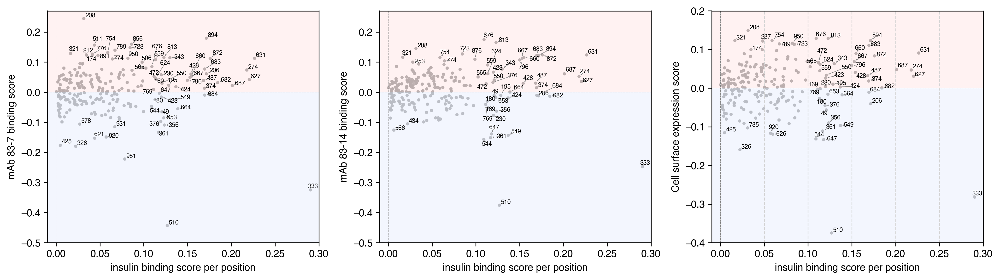

In [ ]:
df1=variantsScore_melt['insBind_avg'].copy()
df1=df1[df1['median_score']>0]
df1=df1[df1['position']<954]

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):

    df2=variantsScore_melt[data].copy()
    
    if data =='a07Bind_avg':
        df2=df2[~df2['position'].isin(ab8307_site)]
        
    if data =='a14Bind_avg':
        df2=df2[~df2['position'].isin(ab8314_site)]
        
    if data =='a07a14_Bind_avg':
        df2=df2[~df2['position'].isin(ab8307_site)]
        df2=df2[~df2['position'].isin(ab8314_site)]
        
    
    df2=df2[df2['position'].isin(list(df1['position']))]
    df1=df1[df1['position'].isin(list(df2['position']))]
  

    
    axs[idx].scatter(df1['median_score'], df2['median_score'], s=5, color=plot_cmap['grey'], alpha=0.9)
    
    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    #axs[idx].set_title('positions with gain of insulin binding with FDR < 0.01')
    axs[idx].set_xlim(-0.01, 0.3)
    axs[idx].set_ylim(-0.5, 0.27)
    if data =='a07a14_Bind_avg':
        axs[idx].set_ylim(-0.4, 0.2)
        
    axs[idx].set_ylabel(name_map[data], size=10)
    axs[idx].axhspan(-0.5, 0, facecolor='#c4d5fd', alpha=0.2) 
    axs[idx].axhspan(0, 0.27, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin binding score per position', size=10)

    texts = []
    for i, row in df1.iterrows():
    
        if df1['median_score'][i] > 0.1 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1 :
            point = axs[idx].annotate((row['position']), (df1['median_score'][i], (df2['median_score'][i])), size=6, **dict(color='black'))
            texts.append(point)

    adjust_text(texts,ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
            arrowprops=dict(arrowstyle='->', color='grey',
                            lw=0.5, mutation_scale=2))
            
plt.grid(axis='x', color='lightgrey', linestyle='--')

plt.tight_layout()
plt.savefig('results/figures/Fig3A.pdf')
plt.show()

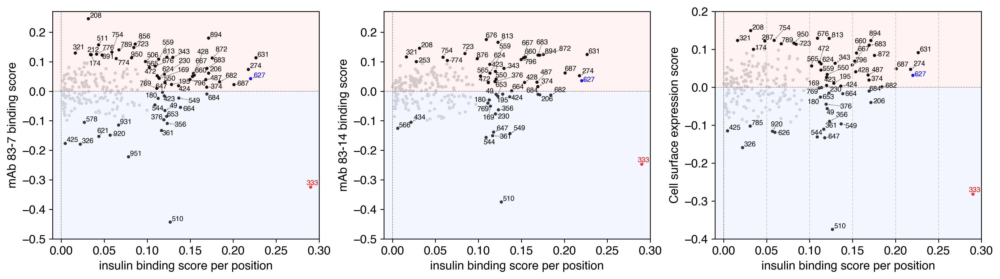

In [ ]:
df1 = variantsScore_melt['insBind_avg'].copy()
df1 = df1[df1['median_score'] > 0]
df1 = df1[df1['position'] < 954]

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):

    df2 = variantsScore_melt[data].copy()

    if data == 'a07Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]

    if data == 'a14Bind_avg':
        df2 = df2[~df2['position'].isin(ab8314_site)]

    if data == 'a07a14_Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]
        df2 = df2[~df2['position'].isin(ab8314_site)]

    df2 = df2[df2['position'].isin(list(df1['position']))]
    df1 = df1[df1['position'].isin(list(df2['position']))]

    # Default color for points
    point_colors = []

    # Loop over df1 to determine the color of each point
    for i, row in df1.iterrows():
        # Default point color
        color = 'lightgrey'
        
        # Annotate specific points
        if row['position'] == 333:
            color = 'red'
        elif row['position'] == 627:
            color = 'blue'
        else:
            # Color points based on the annotation conditions
            if df1['median_score'][i] > 0.1 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1:
                color = 'black'
        
        point_colors.append(color)

    # Scatter plot for the points (color according to position)
    axs[idx].scatter(df1['median_score'], df2['median_score'], s=5, color=point_colors, alpha=0.9)

    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].set_xlim(-0.01, 0.3)
    axs[idx].set_ylim(-0.5, 0.27)
    if data == 'a07a14_Bind_avg':
        axs[idx].set_ylim(-0.4, 0.2)

    axs[idx].set_ylabel(name_map[data], size=12)
    axs[idx].axhspan(-0.5, 0, facecolor='#c4d5fd', alpha=0.2)
    axs[idx].axhspan(0, 0.27, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin binding score per position', size=12)
    axs[idx].tick_params(axis='x', labelsize=12)
    axs[idx].tick_params(axis='y', labelsize=12)

    texts = []
    for i, row in df1.iterrows():
        # Default color for annotations
        color = 'black'

        # Change color for G333 (red) and D627 (blue)
        if row['position'] == 333:
            color = 'red'
        elif row['position'] == 627:
            color = 'blue'

        # Annotate only if conditions are met for annotation
        if df1['median_score'][i] > 0.1 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1:
            point = axs[idx].annotate(str(row['position']),
                                      (df1['median_score'][i], df2['median_score'][i]),
                                      size=7, color=color)
            texts.append(point)

    # Adjust text labels with arrows
    adjust_text(texts, ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
                arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=2))

plt.grid(axis='x', color='lightgrey', linestyle='--')

plt.tight_layout()
plt.savefig('results/figures/Fig3A.pdf')
plt.show()

# plotting individual variants with gain of insulin binding

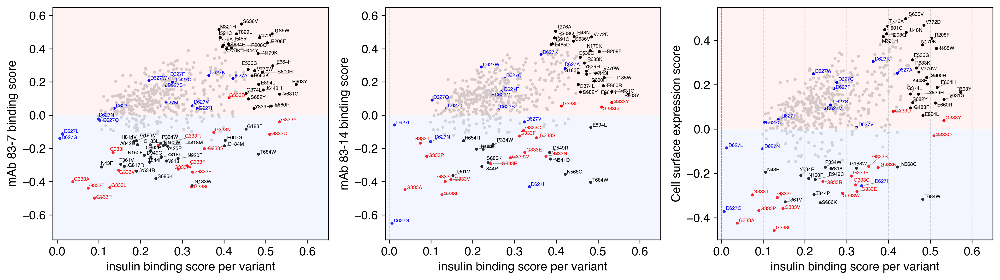

In [ ]:
df1 = variants_score_dict['insBind_avg'].copy()

df1 = df1[df1['variant_score'] > 0].reset_index()  # filter for variants with positive score

# Apply filtering to df1, except for G333 and D627
df1_filtered = df1[~df1['aa_substitutions'].str.startswith(('G333', 'D627'))]

# Apply filters for variants with positive score, FDR < 0.01, and insBind_RepCont == 2 for non-G333/D627 variants
df1_filtered = df1_filtered[df1_filtered['FDRvalues'] < 0.01]  # filter for variants with FDR < 0.01
df1_filtered = df1_filtered[df1_filtered['insBind_RepCont'] == 2]

# Now we combine G333 and D627 with filtered variants (which don't have FDR and RepCont filtering)
df1 = pd.concat([df1[df1['aa_substitutions'].str.startswith(('G333', 'D627'))], df1_filtered])

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']
plot_titles = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):
    df2 = variants_score_dict[data].copy()

    if data == 'a07Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]

    if data == 'a14Bind_avg':
        df2 = df2[~df2['position'].isin(ab8314_site)]

    if data == 'a07a14_Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]
        df2 = df2[~df2['position'].isin(ab8314_site)]

    df2 = df2[df2['aa_substitutions'].isin(list(df1['aa_substitutions']))]
    df1 = df1[df1['aa_substitutions'].isin(list(df2['aa_substitutions']))]

    df = df1.merge(df2, on='aa_substitutions', how='left', suffixes=['_insBind', '_exp'])

    # Initialize list for colors
    colors = []

    for i, row in df.iterrows():
        # Default color is grey for points that are not annotated
        color = 'lightgrey'

        # Annotate and color points based on conditions
        if row['aa_substitutions'].startswith('G333'):
            color = 'red'  # G333 annotated points will be red
        elif row['aa_substitutions'].startswith('D627'):
            color = 'blue'  # D627 annotated points will be blue
        elif df['variant_score_insBind'][i] > 0.45 or df['variant_score_exp'][i] < -0.15 or df['variant_score_exp'][i] > 0.4:
            color = 'black'  # Annotated points based on filtering will be black

        # Append the color for the current point
        colors.append(color)

    # Scatter plot with color based on conditions
    scatter = axs[idx].scatter(df['variant_score_insBind'], df['variant_score_exp'], s=4, c=colors)

    texts = []

    for i, row in df.iterrows():
        color = 'black'  # Default color for annotations

        # Annotate points with specific colors
        if row['aa_substitutions'].startswith('G333'):
            color = 'red'
        elif row['aa_substitutions'].startswith('D627'):
            color = 'blue'

        # Apply filtering conditions for other annotated variants
        elif df['variant_score_insBind'][i] > 0.45 or df['variant_score_exp'][i] < -0.15 or df['variant_score_exp'][i] > 0.4:
            color = 'black'

        else:
            continue  # Skip this point if it doesn’t meet the annotation condition

        # Add annotation to the plot
        point = axs[idx].annotate(
            row['aa_substitutions'],
            (df['variant_score_insBind'][i], df['variant_score_exp'][i]),
            size=5, color=color
        )
        texts.append(point)

    adjust_text(texts, ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
                arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=1))

    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].set_xlim(-0.01, 0.65)
    axs[idx].set_ylim(-0.75, 0.65)
    if data =='a07a14_Bind_avg':
        axs[idx].set_ylim(-0.5, 0.55)
    axs[idx].set_ylabel(name_map[data], size=12)
    axs[idx].axhspan(-1.5, 0, facecolor='#c4d5fd', alpha=0.2)
    axs[idx].axhspan(0, 0.75, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin binding score per variant', size=12)
    axs[idx].tick_params(axis='x', labelsize=12)
    axs[idx].tick_params(axis='y', labelsize=12)
    
plt.grid(axis='x', color='lightgrey', linestyle='--')

plt.tight_layout()

plt.savefig('results/figures/Fig3B.pdf')

plt.show()

2 [-0.52856733  0.61271477]
9 [-0.51361121  0.66088225]
2 [0.87540589 0.79086031]
31 [-0.89731719  0.85408746]
2 [ 0.04257103 -0.95792176]
10 [ 0.1775724  -0.38861238]
2 [-0.82006838 -0.98046153]
5 [ 0.34111611 -0.65717118]


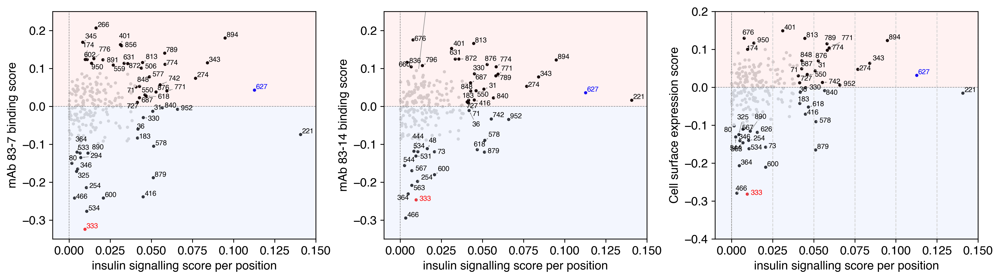

In [ ]:
df1 = variantsScore_melt['insSign_avg'].copy()
df1 = df1[df1['median_score'] > 0]
df1 = df1[df1['position'] < 954]

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):

    df2 = variantsScore_melt[data].copy()

    if data == 'a07Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]

    if data == 'a14Bind_avg':
        df2 = df2[~df2['position'].isin(ab8314_site)]

    if data == 'a07a14_Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]
        df2 = df2[~df2['position'].isin(ab8314_site)]

    df2 = df2[df2['position'].isin(list(df1['position']))]
    df1 = df1[df1['position'].isin(list(df2['position']))]
    point_colors = []

    # Loop over df1 to determine the color of each point
    for i, row in df1.iterrows():
        # Default point color
        color = 'lightgrey'
        
        # Annotate specific points
        if row['position'] == 333:
            color = 'red'
        elif row['position'] == 627:
            color = 'blue'
        else:
            # Color points based on the annotation conditions
            if df1['median_score'][i] > 0.04 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1:
                color = 'black'
        
        point_colors.append(color)
# Scatter plot for the points (color according to position)
    axs[idx].scatter(df1['median_score'], df2['median_score'], s=5, color=point_colors, alpha=0.9)

    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].set_xlim(-0.01, 0.15)
    axs[idx].set_ylim(-0.35, 0.25)
    if data == 'a07a14_Bind_avg':
        axs[idx].set_ylim(-0.4, 0.2)

    axs[idx].set_ylabel(name_map[data], size=12)
    axs[idx].axhspan(-0.5, 0, facecolor='#c4d5fd', alpha=0.2)
    axs[idx].axhspan(0, 0.3, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin signalling score per position', size=12)
    axs[idx].tick_params(axis='x', labelsize=12)
    axs[idx].tick_params(axis='y', labelsize=12)
    texts = []
    for i, row in df1.iterrows():
        # Default color for annotations
        color = 'black'

        # Change color for G333 (red) and D627 (blue)
        if row['position'] == 333:
            color = 'red'
        elif row['position'] == 627:
            color = 'blue'

        # Annotate only if conditions are met for annotation
        if df1['median_score'][i] > 0.04 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1:
            point = axs[idx].annotate(str(row['position']),
                                      (df1['median_score'][i], df2['median_score'][i]),
                                      size=7, color=color)
            texts.append(point)

    # Adjust text labels with arrows
    #adjust_text(texts, ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
                #arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=2))


    adjust_text(texts,ax=axs[idx],arrowprops=dict(arrowstyle='->', 
                color='grey',lw=0.5, mutation_scale=2))
    
plt.grid(axis='x', color='lightgrey', linestyle='--')

plt.tight_layout()
plt.savefig('results/figures/SuppFig6A.pdf')
plt.show()

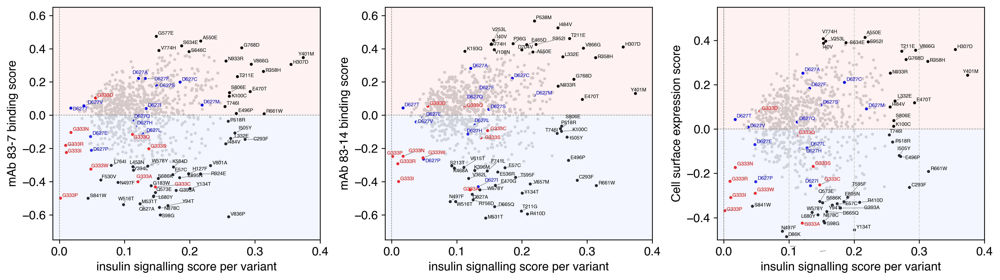

In [ ]:
df1 = variants_score_dict['insSign_avg'].copy()

df1 = df1[df1['variant_score'] > 0].reset_index()  # filter for variants with positive score

# Apply filtering to df1, except for G333 and D627
df1_filtered = df1[~df1['aa_substitutions'].str.startswith(('G333', 'D627'))]

# Apply filters for variants with positive score, FDR < 0.01, and insSign_RepCont == 2 for non-G333/D627 variants
df1_filtered = df1_filtered[df1_filtered['FDRvalues'] < 0.01]  # filter for variants with FDR < 0.01
df1_filtered = df1_filtered[df1_filtered['insSign_RepCont'] == 5]

# Now we combine G333 and D627 with filtered variants (which don't have FDR and RepCont filtering)
df1 = pd.concat([df1[df1['aa_substitutions'].str.startswith(('G333', 'D627'))], df1_filtered])


# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']
plot_titles = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):
    df2 = variants_score_dict[data].copy()

    if data == 'a07Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]

    if data == 'a14Bind_avg':
        df2 = df2[~df2['position'].isin(ab8314_site)]

    if data == 'a07a14_Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]
        df2 = df2[~df2['position'].isin(ab8314_site)]

    df2 = df2[df2['aa_substitutions'].isin(list(df1['aa_substitutions']))]
    df1 = df1[df1['aa_substitutions'].isin(list(df2['aa_substitutions']))]

    df = df1.merge(df2, on='aa_substitutions', how='left', suffixes=['_insBind', '_exp'])

    # Initialize list for colors
    colors = []

    for i, row in df.iterrows():
        # Default color is grey for points that are not annotated
        color = 'lightgrey'

        # Annotate and color points based on conditions
        if row['aa_substitutions'].startswith('G333'):
            color = 'red'  # G333 annotated points will be red
        elif row['aa_substitutions'].startswith('D627'):
            color = 'blue'  # D627 annotated points will be blue
        elif df['variant_score_insBind'][i] > 0.25 or df['variant_score_exp'][i] < -0.3 or df['variant_score_exp'][i] > 0.38:
            color = 'black'  # Annotated points based on filtering will be black

        # Append the color for the current point
        colors.append(color)

    # Scatter plot with color based on conditions
    scatter = axs[idx].scatter(df['variant_score_insBind'], df['variant_score_exp'], s=4, c=colors)

    texts = []

    for i, row in df.iterrows():
        color = 'black'  # Default color for annotations

        # Annotate points with specific colors
        if row['aa_substitutions'].startswith('G333'):
            color = 'red'
        elif row['aa_substitutions'].startswith('D627'):
            color = 'blue'

        # Apply filtering conditions for other annotated variants
        elif df['variant_score_insBind'][i] > 0.25 or df['variant_score_exp'][i] < -0.3 or df['variant_score_exp'][i] > 0.38:
            color = 'black'

        else:
            continue  # Skip this point if it doesn’t meet the annotation condition

        # Add annotation to the plot
        point = axs[idx].annotate(
            row['aa_substitutions'],
            (df['variant_score_insBind'][i], df['variant_score_exp'][i]),
            size=5, color=color
        )
        texts.append(point)

    adjust_text(texts, ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
                arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=1))

   
    
    
    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].set_xlim(-0.01, 0.4)
    axs[idx].set_ylim(-0.75, 0.65)
    if data =='a07a14_Bind_avg':
        axs[idx].set_ylim(-0.5, 0.55)
    axs[idx].set_ylabel(name_map[data], size=12)
    axs[idx].axhspan(-1.5, 0, facecolor='#c4d5fd', alpha=0.2)
    axs[idx].axhspan(0, 0.75, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin signalling score per variant', size=12)
    axs[idx].tick_params(axis='x', labelsize=12)
    axs[idx].tick_params(axis='y', labelsize=12)

plt.grid(axis='x', color='lightgrey', linestyle='--')

plt.tight_layout()

plt.savefig('results/figures/SuppFig6B.pdf')

plt.show()



4 [-0.77961054  0.27596451]
5 [0.47098812 0.55408344]
6 [-0.25248789  0.96846522]
10 [ 0.20687581 -0.47580105]
11 [-0.47714504 -0.78794202]
12 [-0.18065718  0.59857344]
13 [ 0.34427823 -0.51871558]
14 [ 0.32239078 -0.67743956]
15 [ 0.58590866 -0.07475319]
16 [ 0.19529389 -0.14117401]
17 [-0.58601421 -0.44709149]
18 [0.03362116 0.40965066]
19 [-0.32786934  0.89494133]
20 [ 0.24168052 -0.93594048]
72 [ 0.55277364 -0.99527002]
73 [ 0.07764005 -0.60576901]
74 [-0.98878734  0.78930139]
75 [ 0.18679665 -0.61890629]
76 [-0.46271039 -0.12877393]
77 [0.10452403 0.40928236]
78 [-0.13484488 -0.60758458]
79 [0.84773694 0.05596693]
80 [ 0.03952163 -0.43505744]
81 [-0.48046466 -0.21966381]
82 [0.60775603 0.78791608]
83 [-0.2713381  -0.39208938]
84 [-0.31310948 -0.92239314]
85 [0.7482501  0.99306188]
45 [-0.1825938  -0.61963709]
46 [-0.68739967  0.78368143]
57 [0.63920911 0.24360975]
58 [-0.97843985 -0.3172368 ]
59 [ 0.58403487 -0.51199904]
60 [-0.37922188 -0.33934499]
61 [-0.02827081  0.46170217]
54

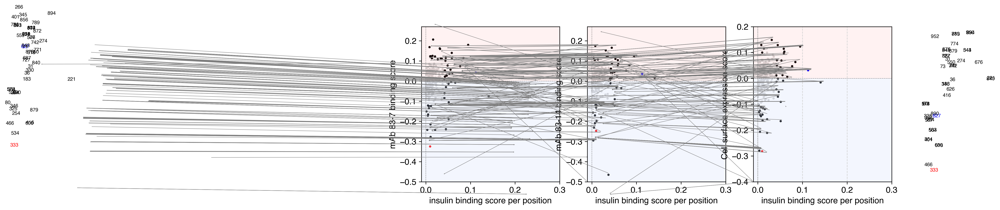

In [ ]:
df1 = variantsScore_melt['insSign_avg'].copy()
df1 = df1[df1['median_score'] > 0]
df1 = df1[df1['position'] < 954]

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(12, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):

    df2 = variantsScore_melt[data].copy()

    if data == 'a07Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]

    if data == 'a14Bind_avg':
        df2 = df2[~df2['position'].isin(ab8314_site)]

    if data == 'a07a14_Bind_avg':
        df2 = df2[~df2['position'].isin(ab8307_site)]
        df2 = df2[~df2['position'].isin(ab8314_site)]

    df2 = df2[df2['position'].isin(list(df1['position']))]
    df1 = df1[df1['position'].isin(list(df2['position']))]

    # Default color for points
    point_colors = []

    # Loop over df1 to determine the color of each point
    for i, row in df1.iterrows():
        # Default point color
        color = 'lightgrey'
        
        # Annotate specific points
        if row['position'] == 333:
            color = 'red'
        elif row['position'] == 627:
            color = 'blue'
        else:
            # Color points based on the annotation conditions
            if df1['median_score'][i] > 0.04 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1 :
                color = 'black'
        
        point_colors.append(color)

    # Scatter plot for the points (color according to position)
    axs[idx].scatter(df1['median_score'], df2['median_score'], s=5, color=point_colors, alpha=0.9)

    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].set_xlim(-0.01, 0.3)
    axs[idx].set_ylim(-0.5, 0.27)
    if data == 'a07a14_Bind_avg':
        axs[idx].set_ylim(-0.4, 0.2)

    axs[idx].set_ylabel(name_map[data], size=12)
    axs[idx].axhspan(-0.5, 0, facecolor='#c4d5fd', alpha=0.2)
    axs[idx].axhspan(0, 0.27, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin binding score per position', size=12)
    axs[idx].tick_params(axis='x', labelsize=12)
    axs[idx].tick_params(axis='y', labelsize=12)

    texts = []
    for i, row in df1.iterrows():
        # Default color for annotations
        color = 'black'

        # Change color for G333 (red) and D627 (blue)
        if row['position'] == 333:
            color = 'red'
        elif row['position'] == 627:
            color = 'blue'

        # Annotate only if conditions are met for annotation
        if df1['median_score'][i] > 0.04 or df2['median_score'][i] < -0.1 or df2['median_score'][i] > 0.1 :            point = axs[idx].annotate(str(row['position']),
                                      (df1['median_score'][i], df2['median_score'][i]),
                                      size=7, color=color)
        texts.append(point)

    # Adjust text labels with arrows
    adjust_text(texts, ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
                arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=2))

plt.grid(axis='x', color='lightgrey', linestyle='--')

plt.tight_layout()
#plt.savefig('results/figures/Fig3A.pdf')
plt.show()

# plotting positions (median score of variants per position) with gain of insulin signalling

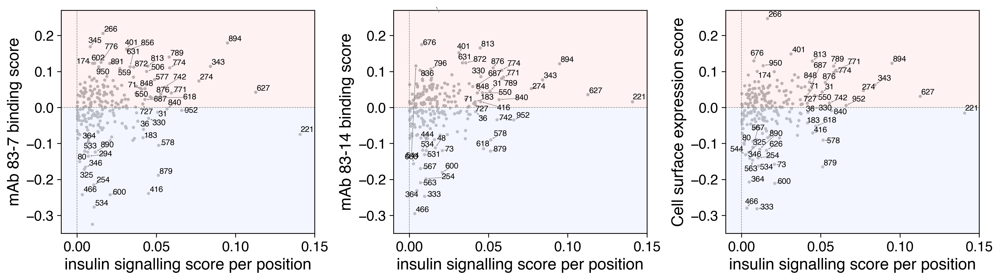

In [ ]:
df1=variantsScore_melt['insSign_avg'].copy()
df1=df1[df1['median_score']>0]
df1 = df1[df1['position'] < 954]

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):

    df2=variantsScore_melt[data].copy()
    
    if data =='a07Bind_avg':
        df2=df2[~df2['position'].isin(ab8307_site)]
        
    if data =='a14Bind_avg':
        df2=df2[~df2['position'].isin(ab8314_site)]
        
    if data =='a07a14_Bind_avg':
        df2=df2[~df2['position'].isin(ab8307_site)]
        df2=df2[~df2['position'].isin(ab8314_site)]
        
    
    df2=df2[df2['position'].isin(list(df1['position']))]
    df1=df1[df1['position'].isin(list(df2['position']))]
  

    
    axs[idx].scatter(df1['median_score'], df2['median_score'], s=5, color=plot_cmap['grey'], alpha=0.9)
    
    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    #axs[idx].set_title('positions with gain of insulin binding with FDR < 0.01')
    axs[idx].set_xlim(-0.01, 0.15)
    axs[idx].set_ylim(-0.35, 0.27)
    axs[idx].set_ylabel(name_map[data], size=16)
    axs[idx].axhspan(-0.5, 0, facecolor='#c4d5fd', alpha=0.2) 
    axs[idx].axhspan(0, 0.27, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin signalling score per position', size=16)
    axs[idx].tick_params(axis='both', which='major', length=4, width=0.8, labelsize=14)

    texts = []
    for i, row in df1.iterrows():
    
        if df1['median_score'][i] > 0.04 or (-0.32 < df2['median_score'][i] < -0.1) or df2['median_score'][i] > 0.1 :
            point = axs[idx].annotate((row['position']), (df1['median_score'][i], (df2['median_score'][i])), size=8, **dict(color='black'))
            texts.append(point)

    adjust_text(texts,ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
            arrowprops=dict(arrowstyle='->', color='grey',
                            lw=0.5, mutation_scale=2))
            

plt.tight_layout()
plt.savefig('results/figures/SuppFig6A.pdf')
plt.show()

# plotting individual variants with gain of insulin signalling

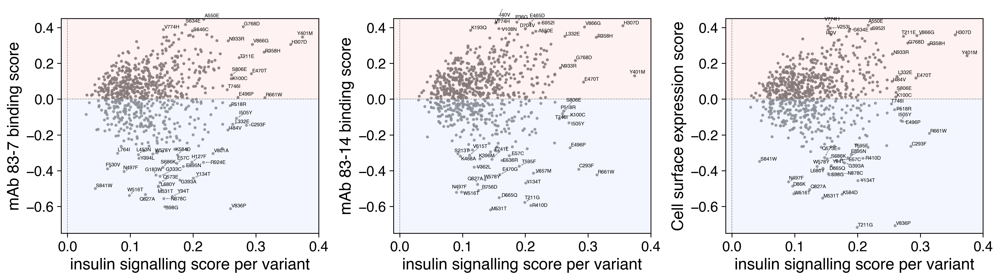

In [ ]:
df1=variants_score_dict['insSign_avg'].copy()
df1=df1[df1['variant_score']>0] #filter for variants with positive score
df1=df1[df1['FDRvalues'] < 0.01] #filter for variants with FDR < 0.01
df1=df1[df1['insSign_RepCont']==5]

# Create subplots: 1 row, 3 columns
fig, axs = plt.subplots(1, 3, figsize=(14, 4))

# Define the datasets to be plotted
datasets = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']
plot_titles = ['a07Bind_avg', 'a14Bind_avg', 'a07a14_Bind_avg']

for idx, data in enumerate(datasets):
    df2 = variants_score_dict[data].copy()

    if data =='a07Bind_avg':
        df2=df2[~df2['position'].isin(ab8307_site)]
        
    if data =='a14Bind_avg':
        df2=df2[~df2['position'].isin(ab8314_site)]
        
    if data =='a07a14_Bind_avg':
        df2=df2[~df2['position'].isin(ab8307_site)]
        df2=df2[~df2['position'].isin(ab8314_site)]
        
   
    df2 = df2[df2['aa_substitutions'].isin(list(df1['aa_substitutions']))]
    df1 = df1[df1['aa_substitutions'].isin(list(df2['aa_substitutions']))]


    df = df1.merge(df2, on='aa_substitutions', how='left', suffixes=['_insBind', '_exp'])

    # Scatter plot
    axs[idx].scatter(df['variant_score_insBind'], df['variant_score_exp'], s=4, color='grey', alpha=0.8)
    
    texts = []
    
    for i, row in df.iterrows():
        if df['variant_score_insBind'][i] > 0.25 or df['variant_score_exp'][i] < -0.3 or df['variant_score_exp'][i] > 0.38:
            point = axs[idx].annotate((row['aa_substitutions']), (df['variant_score_insBind'][i], df['variant_score_exp'][i]), size=5, color='black')
            texts.append(point)
        #elif df['variant_score_insBind'][i] > 0.3 and df['variant_score_exp'][i] <0:
           # point = axs[idx].annotate((row['aa_substitutions']), (df['variant_score_insBind'][i], df['variant_score_exp'][i]), size=5, color='black')
           # texts.append(point)
                


    adjust_text(texts, ax=axs[idx], precision=0.01, expand_text=(1.1, 1.1),
                arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=2))
    
    axs[idx].axvline(0, linestyle='--', c='gray', lw=0.5)
    axs[idx].axhline(0, linestyle='--', c='gray', lw=0.5)
    #axs[idx].set_title('positions with gain of insulin binding with FDR < 0.01')
    axs[idx].set_xlim(-0.01, 0.4)
    axs[idx].set_ylim(-0.75, 0.45)
    axs[idx].set_ylabel(name_map[data], size=16)
    axs[idx].axhspan(-1.5, 0, facecolor='#c4d5fd', alpha=0.2) 
    axs[idx].axhspan(0, 0.75, facecolor='red', alpha=0.05)
    axs[idx].set_xlabel('insulin signalling score per variant', size=16)
    #axs[idx].tick_params(axis='x', size=14)
    #axs[idx].tick_params(axis='y', size=14)
    axs[idx].tick_params(axis='both', which='major', length=4, width=0.8, labelsize=14)

plt.tight_layout()

plt.savefig('results/figures/SuppFig6B.pdf')

plt.show()

## plot INSR domains

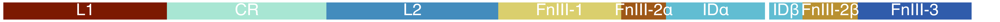

In [ ]:
# define box coordinates
boxes = [(1, 0, 157, 1, '#7C1900'), (158, 0, 153, 1, '#A8E6D3'), (311, 0, 165, 1, '#438CBD'),
         (476, 0, 118, 1, '#DACF6D'), (594, 0, 43, 1, '#9E5817'), (637, 0, 95, 1, '#61BDD2'),
         (732, 0, 6, 1, 'w'), (736, 0, 32, 1, '#61BDD2'), (768, 0, 53, 1, '#B99131'),
         (821, 0, 109, 1, '#305CAB')]

box_names=['L1','CR','L2','FnIII-1','FnIII-2α','IDα','','IDβ','FnIII-2β','FnIII-3']

# create figure and axis
fig, ax = plt.subplots(figsize=(40, 1))

# add rectangles and text to axis
for box, name in zip(boxes, box_names):
    rect = plt.Rectangle((box[0], box[1]), box[2], box[3], color=box[4])
    ax.add_patch(rect)
    text_x = box[0] + box[2] / 2
    text_y = box[1] + box[3] / 2
    ax.text(text_x, text_y, name, va='center', ha='center', color='white', fontsize=48, weight='bold')

# set x and y limits
ax.set_xlim(0, 955)  # Adjusted x-limit to accommodate the last box
ax.set_ylim(0, 1)

# remove axis lines
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis='both', which='both', length=0)

# remove axis labels
ax.set_xticklabels([])
ax.set_yticklabels([])
plt.tight_layout()
# save plot
plt.savefig("results/figures/INSR_domains.pdf")

# display plot
plt.show()

## plot median score pp and also number of variants scored pp

# make scatter plots individually

In [ ]:
# Create the figure with two subplots
sample_list = ['insBind_avg', 'a07Bind_avg', 'a14Bind_avg', 'insSign_avg', 'a07Sign_avg', 'a14Sign_avg']


for library in sample_list:
    
    df=variantsScore_melt[library]
    
        
    fig, axes = plt.subplots(figsize=(155, 4), nrows=2, ncols=1, gridspec_kw={'height_ratios': [2, 1]})
    plt.subplots_adjust(hspace=1)  # Adjust hspace as needed

    # Plot the first subplot (mean score per position)
    colors = ['#0073E6' if score < 0 else '#B51963' for score in df['median_score']]

    # Plot the first subplot (mean score per position)
    ax1 = axes[0]
    ax1.bar(df['position'], df['median_score'], color=colors)
    ax1.set_ylabel(f'median score pp')
    ax1.set_xticks(df['position'])
    ax1.tick_params(top=True, labeltop=False, bottom=False, labelbottom=False)
    ax1.set_xlim(27, 956)
    ax1.axhline(0,color='black', lw=0.5)
    #ax1.set_title('median score pp', size=50)
    #ax1.set_title(library) 
    
    df['N_scored_PP'] = df[AA_LIST].apply(lambda row: row.count(), axis=1)
    # Plot the second subplot (number of scored variants per position)
    ax2 = axes[1]
    ax2.bar(df['position'], df['N_scored_PP'], color='#595959')
    ax2.set_ylabel(f'variants scored pp')
    ax2.set_xticks(df['position'])
    ax2.tick_params(top=True, labeltop=False, bottom=False, labelbottom=False)
    ax2.set_xlim(27, 956)
    #ax2.set_title(' ', size=140)# this generates enough spaces between two plots

    # Save the figure to a file
    plt.tight_layout()
    fig.savefig(f"results/figures/{library}_meanScore_nScord_bcScored.pdf", dpi=300)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sample_list = ['insBind_avg', 'a07Bind_avg', 'a14Bind_avg', 'insSign_avg', 'a07Sign_avg', 'a14Sign_avg']
#sample_list = ['insBind_avg']

for library in sample_list:

    if library in ['insBind_avg','a07Bind_avg','a14Bind_avg', 'a07a14_Bind_avg',
                   'insBindR1','a07BindR1', 'a14BindR1','insBindR2', 'a07BindR2', 'a14BindR2']:
        vmin = -0.8
        vmax = 0.8
    else:
        vmin = -0.6
        vmax = 0.6
    
    df = variantsScore_melt[library]
    
    fig, axes = plt.subplots(figsize=(155, 4), nrows=2, ncols=1, gridspec_kw={'height_ratios': [1.25, 1]})
    plt.subplots_adjust(hspace=1)  # Adjust hspace as needed

    # Plot the first subplot (mean score per position)
    heatmap_data = df[['position', 'median_score']].pivot_table(index='position', values='median_score')
    heatmap_data = heatmap_data.reset_index(drop=True)

    # Create a heatmap with the data
    ax1 = axes[0]
    sns.heatmap(heatmap_data.T, cmap='RdBu_r', ax=ax1, vmin=vmin, vmax=vmax, cbar=False)
    ax1.set_ylabel(f'median score pp')

    # Adjust xtick labels for ax1
    xticks_labels = [int(label) + 28 for label in ax1.get_xticks()]
    ax1.set_xticklabels(xticks_labels, rotation=90)
    ax1.tick_params(top=True, labeltop=False, bottom=True, labelbottom=False)
    ax1.axhline(0, color='black', lw=0.5)

    # Plot the second subplot (number of scored variants per position)
    df['N_scored_PP'] = df[AA_LIST].apply(lambda row: row.count(), axis=1)
    ax2 = axes[1]
    ax2.plot(df['position'], df['N_scored_PP'], color='#595959', marker='o', linestyle='-')
    ax2.set_ylabel(f'variants scored pp')
    ax2.set_xticks(df['position'])
    
    # Adjust xtick labels for ax2
    ax2.set_xticklabels(df['position'], rotation=90)
    ax2.tick_params(top=True, labeltop=False, bottom=True, labelbottom=True)
    ax2.set_xlim(df['position'].min() - 0.5, df['position'].max() + 0.5)

    # Save the figure to a file
    plt.tight_layout()
    fig.savefig(f"results/figures/{library}_meanScore_nScord_bcScored.pdf", dpi=600)

In [ ]:

import matplotlib as mpl

mpl.rcParams['font.family'] = 'Helvetica'

In [ ]:
scatter_cmap = {'site_1': plot_cmap['green'],
                'c_c': plot_cmap['CopperSet'],
                'ab8307_site': plot_cmap['EmberRed'],
                'ab8314_site': plot_cmap['SapphBlue'],
                'data_pos': 'k',
                'site_2': '#23415A'
                }


def annotate_pos(df, df1, features, d=scatter_cmap):
    
    for i, row in df.iterrows():
        for item in features:
            if row[item] == 'yes':
                color = d.get(item, plot_cmap['grey'])  # Default to gray if item is not in the dictionary
                plt.scatter(df['median_score'][i], df1['median_score'][i], color=color, s=11.5)
                if item != 'c_c': # don't annotate c-c residues, just color their points
                    plt.annotate(row['position'], (df['median_score'][i], df1['median_score'][i]), color=color, alpha=0.8, size=12)
                
def annotate_all(df, features, d=scatter_cmap):
    
    plt.scatter(df['variant_score_df1'], df['variant_score_df2'], color='grey', s=1, alpha=0.4) 
    
    for item in features:
        item_=item+"_df1"
        df_subset=df[df[item_]=='yes']
        plt.scatter(df_subset['variant_score_df1'], df_subset['variant_score_df2'], color=d[item], s=1)
        #if item_=='c_c_df1':
            #df_subset=df[df['c_c_df1']=='yes']
            #plt.scatter(df_subset['variant_score_df1'], df_subset['variant_score_df2'], color='orange', s=1)
        #if item_=='site_1_df1':
            #df_subset=df[df['site_1_df1']=='yes']
            #plt.scatter(df_subset['variant_score_df1'], df_subset['variant_score_df2'], color='green', s=1)
                #plt.annotate(row['position'], (df['variant_score'][i], df1['variant_score'][i]), color=color, size=2, alpha=0.7)  
                
def plotting(dfs,style,coloring): 
    if style not in ["medPP", "SinglVars"]:
        raise ValueError("Style should be either 'medPP' or 'SinglVars'")
        sys.exit(1)  
    
    fig, ax = plt.subplots(figsize=(5, 5))  # Create subplot  
    
    if style=='medPP':
        df1=variantsScore_melt[dfs[0]]
        df2=variantsScore_melt[dfs[1]]
       
        plt.scatter(df1['median_score'], df2['median_score'], s=11.5, color=plot_cmap['grey'], alpha=0.8)
        annotate_pos(df1,df2,coloring)

    elif style=='SinglVars':
        df1=variants_score_dict[dfs[0]]
        df2=variants_score_dict[dfs[1]]
        df1=df1[df1['position']>27]
        df2=df2[df2['position']>27]
        
        if dfs[1]=='insSign_avg':
            df2=df2[df2['insSign_RepCont']==5]
            
        df=pd.merge(df1, df2, on='aa_substitutions', how='outer', suffixes=('_df1', '_df2'))
        #plt.scatter(df['variant_score_df1'], df['variant_score_df2'], s=1, color=plot_cmap['grey'], alpha=0.5)
        annotate_all(df, coloring)  
        
    ax.axvline(0, linestyle='--', c='gray', lw=0.5)
    ax.axhline(0, linestyle='--', c='gray', lw=0.5)
    ax.set_title(' ')
    ax.set_xlabel(name_map[dfs[0]], size=12)
    ax.set_ylabel(name_map[dfs[1]], size=12)
    ax.tick_params(axis='x')
    ax.tick_params(axis='y') 
    plt.tight_layout()
    
    # Save each figure individually
    combined_name = '_'.join(dfs)
    if dfs[0] in ['insBind_avg', 'insSign_avg']:
        combined_name = '_'.join(dfs)+"__"+coloring[1]
    if  style=='SinglVars':
        plt.savefig(f"{save_dir}{combined_name}_individual.pdf")
        plt.close()  # Close the current figure to release memory
    elif style=='medPP':
        plt.savefig(f"{save_dir}{combined_name}_PerPosition.pdf")
        plt.close()  # Close the current figure to release memory
        
    
save_dir = 'results/figures/scatters/'
os.makedirs(save_dir, exist_ok=True)

def annotate_pos(df, df1, features, d=scatter_cmap):
    texts = []  # List to hold all annotation texts

    for i, row in df.iterrows():
        for item in features:
            if row[item] == 'yes':
                color = d.get(item, plot_cmap['grey'])
                x = df['median_score'][i]
                y = df1['median_score'][i]
                plt.scatter(x, y, color=color, s=11.5)
                if item != 'c_c':
                    texts.append(plt.text(x, y, str(row['position']), color=color, alpha=0.8, size=12))
    
    adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.5))
def annotate_all(df, features, d=scatter_cmap):
    plt.scatter(df['variant_score_df1'], df['variant_score_df2'], color='grey', s=1, alpha=0.4) 
    texts = []

    for item in features:
        item_ = item + "_df1"
        df_subset = df[df[item_] == 'yes']
        plt.scatter(df_subset['variant_score_df1'], df_subset['variant_score_df2'], color=d[item], s=1)

        if item != 'c_c':
            for _, row in df_subset.iterrows():
                x = row['variant_score_df1']
                y = row['variant_score_df2']
                texts.append(plt.text(x, y, str(row['position_df1']), color=d[item], alpha=0.8, size=8))

    adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.3))


for i, (dfs, coloring) in enumerate([
   # (['insBind_avg', 'a07Bind_avg'], ['c_c', 'site_1', 'ab8307_site']),
   # (['insBind_avg', 'a14Bind_avg'], ['c_c', 'site_1', 'ab8314_site']),
   # (['insBind_avg', 'a07a14_Bind_avg'], ['c_c', 'site_1']),
    (['insBind_avg', 'insSign_avg'], ['c_c', 'site_1']),
    
   # (['insBind_avg', 'a07Bind_avg'], ['c_c', 'site_2', 'ab8307_site']),
   # (['insBind_avg', 'a14Bind_avg'], ['c_c', 'site_2', 'ab8314_site']),
    #(['insBind_avg', 'a07a14_Bind_avg'], ['c_c', 'site_2']),
    (['insBind_avg', 'insSign_avg'], ['c_c', 'site_2']),
    
   # (['insSign_avg', 'a14Sign_avg'], ['c_c', 'site_1', 'ab8314_site']),
   # (['insSign_avg', 'a07Sign_avg'], ['c_c', 'site_1', 'ab8307_site']),
    
   # (['insSign_avg', 'a14Sign_avg'], ['c_c', 'site_2', 'ab8314_site']),
   # (['insSign_avg', 'a07Sign_avg'], ['c_c', 'site_2', 'ab8307_site']),
    
   # (['a14Bind_avg', 'a14Sign_avg'], ['c_c', 'site_1']),
    #(['a07Bind_avg', 'a07Sign_avg'], ['c_c', 'site_1']),
    (['a14Bind_avg', 'a07Bind_avg'], ['c_c', 'ab8307_site','ab8314_site']),
    #(['a14Sign_avg', 'a07Sign_avg'], ['c_c','ab8307_site','ab8314_site']),
    
]):

    print (f'plotting medPP for:     {dfs} ...')
    plotting(dfs, 'medPP', coloring)
    
    #print (f'plotting SinglVars for: {dfs} ...')
    #plotting(dfs, 'SinglVars', coloring)
    
print ('Done!')

plotting medPP for:     ['insBind_avg', 'insSign_avg'] ...
plotting medPP for:     ['insBind_avg', 'insSign_avg'] ...
plotting medPP for:     ['a14Bind_avg', 'a07Bind_avg'] ...
Done!


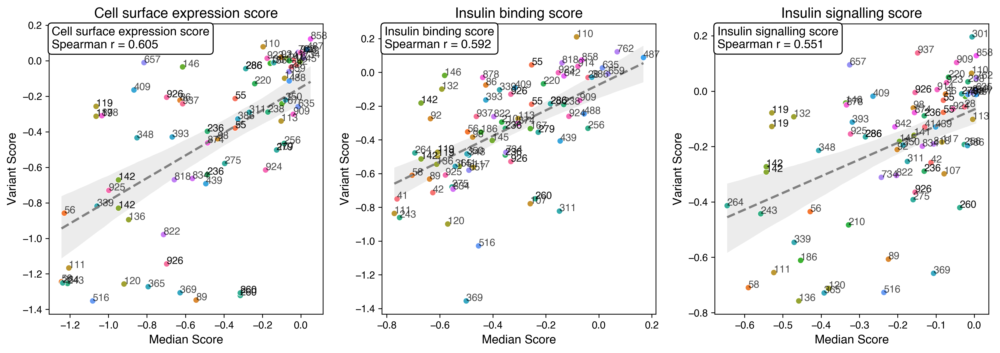

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
df = pd.read_csv("input_files/clinical_variants_to_check_vars.csv")
df1 = pd.read_csv("input_files/ClinicalVariants_toCheck_pos.csv")

# Variant score names and display names
score_names = ['a07a14_Bind_avg', 'insBind_avg', 'insSign_avg']

# Set up plot (larger figure size, no shared axes)
fig, axes = plt.subplots(1, 3, figsize=(14, 5))

for i, score_name in enumerate(score_names):
    # Create f1 and f2 for each score type
    f1 = pd.merge(df, variants_score_dict[score_name], on='aa_substitutions', how='left')
    f2 = pd.merge(df1, variantsScore_melt[score_name], on='position', how='left')
    f3 = pd.merge(f1, f2, on='position', how='left')

    ax = axes[i]

    # Regression line
    sns.regplot(data=f3, x='median_score', y='variant_score', scatter=False, color='gray',
                line_kws={'linestyle': '--'}, ax=ax)

    # Scatterplot (hue suppressed)
    sns.scatterplot(data=f3, x='median_score', y='variant_score',
                    hue='aa_substitutions', ax=ax, legend=False)

    # Annotate each point with integer position
    for _, row in f3.iterrows():
        x = row['median_score']
        y = row['variant_score']
        if not pd.isna(row['position']):
            ax.text(x, y, str(int(row['position'])), fontsize=10, color='black', alpha=0.7)

    # Spearman correlation
    corr = f3['median_score'].corr(f3['variant_score'], method='spearman')

    # Add correlation value as a legend in top-left
    ax.text(0.01, 0.99, f"{name_map[score_name]}\nSpearman r = {corr:.3f}",
            transform=ax.transAxes, ha='left', va='top', fontsize=12,
            bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="black"))

    # Set title and font sizes
    ax.set_title(name_map[score_name], fontsize=14)
    ax.set_xlabel("Median Score", fontsize=12)
    ax.set_ylabel("Variant Score", fontsize=12)

plt.tight_layout()
plt.show()

In [ ]:
f1.sort_values(by='position', ascending=True, inplace=True)
f1

,aa_substitutions,variant_score,insSign_RepCont,FDRvalues,position,-log10_FDRvalues,wt_aa,variant_aa,site_1,site_2,ab8307_site,ab8314_site,c_c,data_pos
0,H28Q,-0.057051,5.0,0.029621,28.0,1.528406,H,Q,,,,,,
1,R41W,-0.129458,5.0,0.000201,41.0,3.696444,R,W,yes,,,,,
2,N42K,-0.258036,5.0,0.000202,42.0,3.694254,N,K,yes,,,,,
3,V55A,-0.032944,5.0,0.565675,55.0,0.247433,V,A,,,,,,
4,V55F,-0.076650,5.0,0.206841,55.0,0.684364,V,F,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36,L260R,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
53,N458D,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
58,W642R,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,S835I,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#Notes: for plotting ['insBind_avg', 'a07a14_Bind_avg'], set figsize to figsize=(6, 5) and also increase font to 17 and 15, for others, keep figsize=(5,5) and font sizes to 16 and 14

save_dir = 'results/figures/scatters/'
os.makedirs(save_dir, exist_ok=True)

scatter_cmap = {'site_1': plot_cmap['green'],
                'c_c': plot_cmap['CopperSet'],
                'ab8307_site': plot_cmap['EmberRed'],
                'ab8314_site': plot_cmap['SapphBlue'],
                'data_pos': 'k',
                'site_2': '#23415A'
                }


def annotate_pos(df, df1, features, d=scatter_cmap, annotate=True, adjust=True):
    texts = []

    for i, row in df.iterrows():
        for item in features:
            if row[item] == 'yes':
                color = d.get(item, plot_cmap['grey'])
                x = df['median_score'][i]
                y = df1['median_score'][i]
                plt.scatter(x, y, color=color, s=11.5)
                if annotate and item != 'c_c':
                    texts.append(plt.text(x, y, str(row['position']), color=color, alpha=0.8, size=12))

    if annotate and adjust and texts:
        adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.5))


def annotate_all(df, features, d=scatter_cmap, annotate=True, adjust=True):
    plt.scatter(df['variant_score_df1'], df['variant_score_df2'], color='grey', s=4, alpha=0.4)
    texts = []

    for item in features:
        item_ = item + "_df1"
        df_subset = df[df[item_] == 'yes']
        plt.scatter(df_subset['variant_score_df1'], df_subset['variant_score_df2'], color=d[item], s=6)

        if annotate and item != 'c_c':
            for _, row in df_subset.iterrows():
                x = row['variant_score_df1']
                y = row['variant_score_df2']
                texts.append(plt.text(x, y, str(row['position_df1']), color=d[item], alpha=0.8, size=8))

    if annotate and adjust and texts:
        adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.3))


def plotting(dfs, style, coloring, annotate=True, adjust=True): 
    if style not in ["medPP", "SinglVars"]:
        raise ValueError("Style should be either 'medPP' or 'SinglVars'")

    fig, ax = plt.subplots(figsize=(5, 5))

    if style == 'medPP':
        df1 = variantsScore_melt[dfs[0]]
        df2 = variantsScore_melt[dfs[1]]
        plt.scatter(df1['median_score'], df2['median_score'], s=11.5, color=plot_cmap['grey'], alpha=0.8)
        annotate_pos(df1, df2, coloring, annotate=annotate, adjust=adjust)
        # Set x-axis limit if these specific datasets are being plotted
        if dfs == ['insBind_avg', 'a07a14_Bind_avg']:
            ax.set_xlim(right=0.5)  # Set maximum x-tick to 0.75

    elif style == 'SinglVars':
        df1 = variants_score_dict[dfs[0]]
        df2 = variants_score_dict[dfs[1]]
        df1 = df1[df1['position'] > 27]
        df2 = df2[df2['position'] > 27]

        if dfs[1] == 'insSign_avg':
            df2 = df2[df2['insSign_RepCont'] == 5]

        df = pd.merge(df1, df2, on='aa_substitutions', how='outer', suffixes=('_df1', '_df2'))
        annotate_all(df, coloring, annotate=annotate, adjust=adjust)

    ax.axvline(0, linestyle='--', c='gray', lw=0.5)
    ax.axhline(0, linestyle='--', c='gray', lw=0.5)
    ax.set_title(' ')
    ax.set_xlabel(name_map[dfs[0]], size=19)
    ax.set_ylabel(name_map[dfs[1]], size=19)
    ax.tick_params(axis='both', which='major', length=4, width=0.8, labelsize=15)
    plt.tight_layout()

    combined_name = '_'.join(dfs)
    if dfs[0] in ['insBind_avg', 'insSign_avg']:
        combined_name = combined_name + "__" + coloring[1]

    suffix = '_PerPosition.pdf' if style == 'medPP' else '_individual.pdf'
    plt.savefig(f"{save_dir}{combined_name}{suffix}")
    plt.close()

# Only color the points, no annotations
plotting(['a14Bind_avg', 'a07Bind_avg'], 'medPP', ['c_c', 'ab8307_site', 'ab8314_site'],
         annotate=False, adjust=False)

plotting(['a14Bind_avg', 'a07Bind_avg'], 'SinglVars', ['c_c', 'ab8307_site', 'ab8314_site'],
         annotate=False, adjust=False)

(['insBind_avg', ''], ['c_c', 'site_1']),

# Annotate, but don't use adjust_text (may overlap)
plotting(['insBind_avg', 'a07a14_Bind_avg'], 'medPP', ['c_c', 'site_1'],
         annotate=False, adjust=False)

plotting(['insSign_avg', 'a07Sign_avg'], 'medPP', ['c_c', 'site_1','ab8307_site'],
         annotate=False, adjust=False)

plotting(['insSign_avg', 'a14Sign_avg'], 'medPP', ['c_c', 'site_1','ab8314_site'],
         annotate=False, adjust=False)

plotting(['a07Sign_avg', 'a14Sign_avg'], 'medPP', ['c_c', 'ab8307_site','ab8314_site'],
         annotate=True, adjust=False)

plotting(['insBind_avg', 'insSign_avg'], 'medPP', ['c_c', 'site_1'],
         annotate=False, adjust=False)

plotting(['insBind_avg', 'insSign_avg'], 'SinglVars', ['c_c', 'site_1'],
         annotate=False, adjust=False)

plotting(['insBind_avg', 'a07a14_Bind_avg'], 'SinglVars', ['c_c', 'site_1'],
         annotate=False, adjust=False)

plotting(['insBind_avg', 'insSign_avg'], 'medPP', ['c_c', 'site_2'],
         annotate=False, adjust=False)

plotting(['insBind_avg', 'a07a14_Bind_avg'], 'medPP', ['c_c', 'site_2'],
         annotate=False, adjust=False)

In [ ]:
save_dir

'results/figures/scatters/'

In [ ]:
data_pos

[734]

### plot expression (pale green) and insulin binding (green) score for all the site 1 residues

In [ ]:
site_1_A = [i for i in site_1 if i > 700]
site_1_B = [i for i in site_1 if i > 700]

site_1=site_1_A

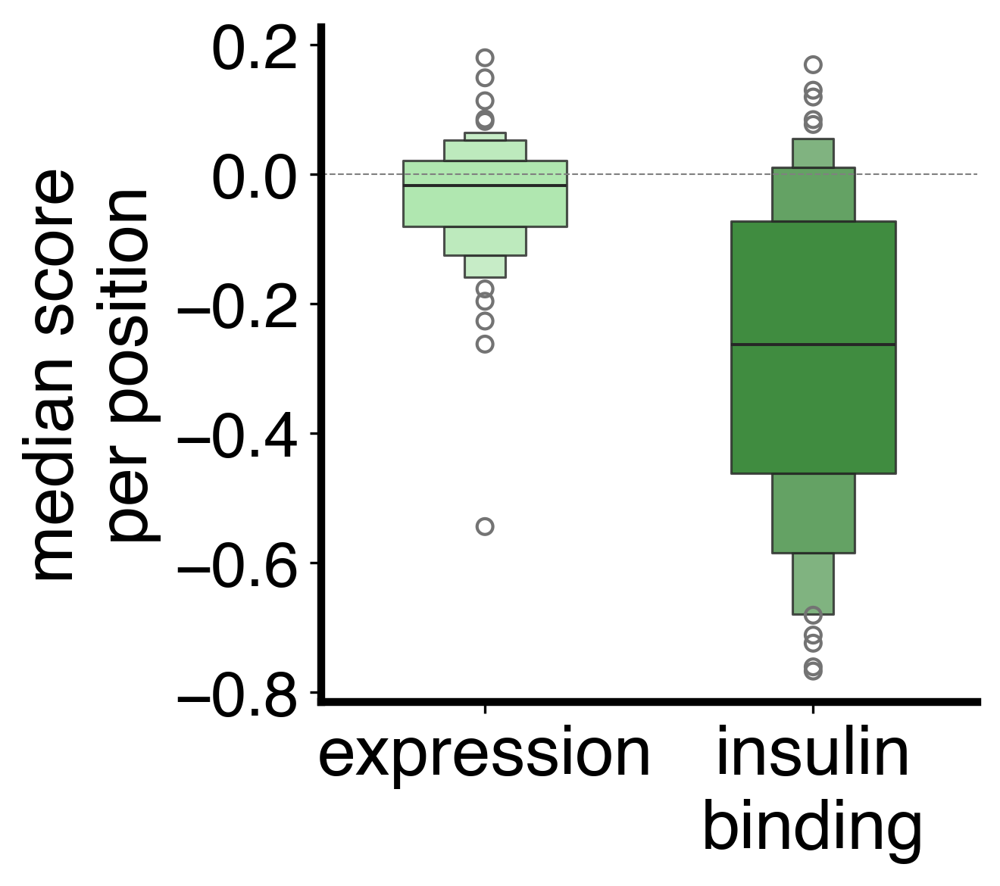

Mann-Whitney U Test: Statistic=41303.0, p-value=0.0012757043619629537
Mann-Whitney U Test: Statistic=23152.0, p-value=2.621417174446398e-06


In [ ]:
plt.subplots(figsize=(4.5, 4))

exp=variantsScore_melt['a07a14_Bind_avg'].copy()
insbind=variantsScore_melt['insBind_avg'].copy()

exp_noSite1=exp[exp['site_1']!='yes']
insbind_noSite1=insbind[insbind['site_1']!='yes']

exp_s1=exp[exp['site_1']=='yes']
insbind_s1=insbind[insbind['site_1']=='yes']


exp_s1['site_1'] = exp_s1['site_1'].apply(lambda x: 'site_1_exp' if x == 'yes' else ' ')
insbind_s1['site_1'] = insbind_s1['site_1'].apply(lambda x: 'site_1_insbind' if x == 'yes' else ' ')

#insbind['c_c'] = insbind['site_2'].apply(lambda x: 'site_2_ins' if x == 'yes' else 'site_2')



df3 = pd.concat([exp_s1,insbind_s1], ignore_index=True )

palette = {'site_1_exp': 'lightgreen', 'site_1_insbind': 'green'} 
           

plot=sns.boxenplot(data=df3, x='site_1', y='median_score', hue='site_1',  palette=palette, alpha=0.8, orient='v', width=0.5)

ax=plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)

#sns.stripplot(data=df3, x='site_2', y='median_score', hue='site_2', palette=palette, dodge=True, alpha=0.6, jitter=True)

#plt.ylabel('insulin binding             expression        ', size=14)
#plt.xlim(-0.84, 0.44)
#plt.yticks(size=14)
#plt.xticks(size=14)
#plt.yticks(ticks=[0, 1, 2, 3], 
         #  labels=['missense\nvariants', 'disulfide\ncysteine\nvariants',
         # 'missense\nvariants', 'disulfide\ncysteine\nvariants'])  # Customizing y-tick labels

fsize=24
plt.xticks([0,1],['expression','insulin\nbinding'], size=22)
#plt.title('site 2 residues', size=fsize)
plt.xlabel('')
plt.ylabel('median score \nper position', size=22)
plt.yticks(size=20)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)

plt.tight_layout()
plt.savefig('results/figures/Fig2E_inset.pdf')

plt.show()

# Assuming you have two sites you want to compare, let's call them site_A and site_B
site_A_data = df3[df3['site_1'] != 'site_1_exp']['median_score']
site_B_data = df3[df3['site_1'] != 'site_1_insbind']['median_score']


s1=exp_s1['median_score']
s2=exp_noSite1['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

s1=insbind_s1['median_score']
s2=insbind_noSite1['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

### plot expression (pale green) and insulin binding (green) score for all the site 2 residues

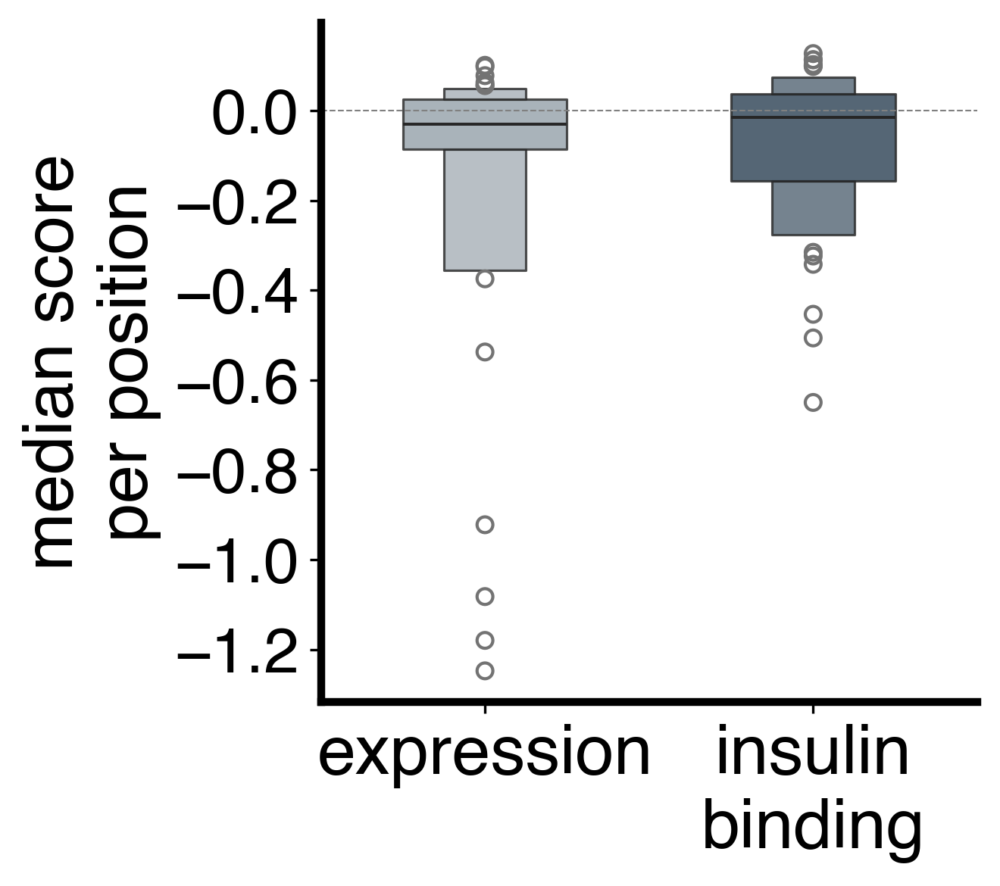

Mann-Whitney U Test: Statistic=23269.0, p-value=0.1519643478181884
Mann-Whitney U Test: Statistic=25401.0, p-value=0.00870540196622182


In [ ]:
plt.subplots(figsize=(4.5, 4))

exp=variantsScore_melt['a07a14_Bind_avg'].copy()
insbind=variantsScore_melt['insBind_avg'].copy()

exp_noSite_s2=exp[exp['site_2']!='yes']
insbind_noSite_s2=insbind[insbind['site_2']!='yes']

exp_s2=exp[exp['site_2']=='yes']
insbind_s2=insbind[insbind['site_2']=='yes']


exp_s2['site_2'] = exp_s2['site_2'].apply(lambda x: 'site_2_exp' if x == 'yes' else ' ')
insbind_s2['site_2'] = insbind_s2['site_2'].apply(lambda x: 'site_2_insbind' if x == 'yes' else ' ')

#insbind['c_c'] = insbind['site_2'].apply(lambda x: 'site_2_ins' if x == 'yes' else 'site_2')


#df3=exp_s2.append(insbind_s2, ignore_index=True)
df3 = pd.concat([exp_s2, insbind_s2], ignore_index=True)


palette = {'site_2_exp': '#91A0AC', 'site_2_insbind': '#23415A'} 
           

plot=sns.boxenplot(data=df3, x='site_2', y='median_score', hue='site_2',  palette=palette, alpha=0.8, orient='v', width=0.5)

ax=plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)


fsize=24
plt.xticks([0,1],['expression','insulin\nbinding'], size=22)
#plt.title('site 2 residues', size=fsize)
plt.xlabel('')
plt.ylabel('median score\nper position', size=22)
plt.yticks(size=20)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)

plt.tight_layout()
plt.savefig('results/figures/SuppFig3E_inset.pdf')


plt.show()

# Assuming you have two sites you want to compare, let's call them site_A and site_B
site_A_data = df3[df3['site_2'] != 'site_2_exp']['median_score']
site_B_data = df3[df3['site_2'] != 'site_2_insbind']['median_score']

#plt.axvline(0, linestyle='--', c='gray', lw=0.5 )

s1=exp_s2['median_score']
s2=exp_noSite_s2['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

s1=insbind_s2['median_score']
s2=insbind_noSite_s2['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

([Text(0.09013142174432498, -0.3616524252825559, '510'),
  Text(0.09013142174432498, -1.1617034727689382, '512'),
  Text(0.09013142174432498, -1.250775215543059, '514'),
  Text(0.09013142174432498, -1.0641476551102333, '516'),
  Text(0.09013142174432498, -0.5245686292633596, '561'),
  Text(0.09013142174432498, -0.9091591449413371, '583'),
  Text(1.0901314217443252, -0.550495812964582, '512'),
  Text(1.0901314217443252, -0.2012016725924981, '514'),
  Text(1.0901314217443252, -0.4716848127180415, '516'),
  Text(1.0901314217443252, -0.39149512427686206, '529'),
  Text(1.0901314217443252, -0.6532259627337555, '530'),
  Text(1.0901314217443252, -0.30250959831851576, '583')],
  <matplotlib.patches.FancyArrowPatch at 0x33578b7c0>])

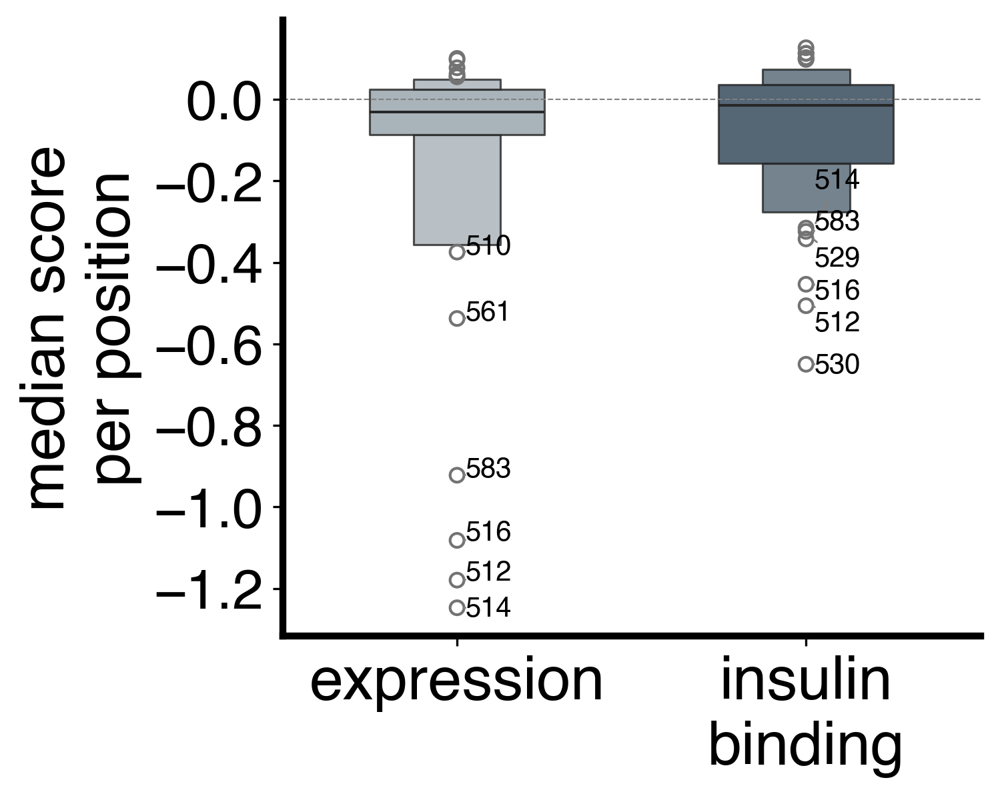

In [ ]:
plt.subplots(figsize=(4.5, 4))

exp=variantsScore_melt['a07a14_Bind_avg'].copy()
insbind=variantsScore_melt['insBind_avg'].copy()

exp_noSite_s2=exp[exp['site_2']!='yes']
insbind_noSite_s2=insbind[insbind['site_2']!='yes']

exp_s2=exp[exp['site_2']=='yes']
insbind_s2=insbind[insbind['site_2']=='yes']


exp_s2['site_2'] = exp_s2['site_2'].apply(lambda x: 'site_2_exp' if x == 'yes' else ' ')
insbind_s2['site_2'] = insbind_s2['site_2'].apply(lambda x: 'site_2_insbind' if x == 'yes' else ' ')

#insbind['c_c'] = insbind['site_2'].apply(lambda x: 'site_2_ins' if x == 'yes' else 'site_2')


#df3=exp_s2.append(insbind_s2, ignore_index=True)
df3 = pd.concat([exp_s2, insbind_s2], ignore_index=True)


palette = {'site_2_exp': '#91A0AC', 'site_2_insbind': '#23415A'} 
# Existing plotting code
plot = sns.boxenplot(
    data=df3,
    x='site_2',
    y='median_score',
    hue='site_2',
    palette=palette,
    alpha=0.8,
    orient='v',
    width=0.5
)

ax = plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)

fsize = 24
plt.xticks([0, 1], ['expression', 'insulin\nbinding'], size=22)
plt.xlabel('')
plt.ylabel('median score\nper position', size=22)
plt.yticks(size=20)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)

texts = []
x_offset = 0.02  

for i, row in df3.iterrows():
    if row['site_2'] == 'site_2_exp' and row['median_score'] < -0.35:
        xpos = 0
    elif row['site_2'] == 'site_2_insbind' and row['median_score'] < -0.3:
        xpos = 1
    else:
        continue

    txt = ax.text(
        xpos + x_offset,
        row['median_score'],
        str(row['position']),
        fontsize=10,
        color='black',
        ha='left',
        va='center'
    )
    texts.append(txt)

# Adjust positions and add lines connecting labels to points
adjust_text(
    texts,
    only_move={'points': 'x', 'texts': 'x'},
    arrowprops=dict(arrowstyle="-", color='gray', lw=0.7),
    ax=ax
)


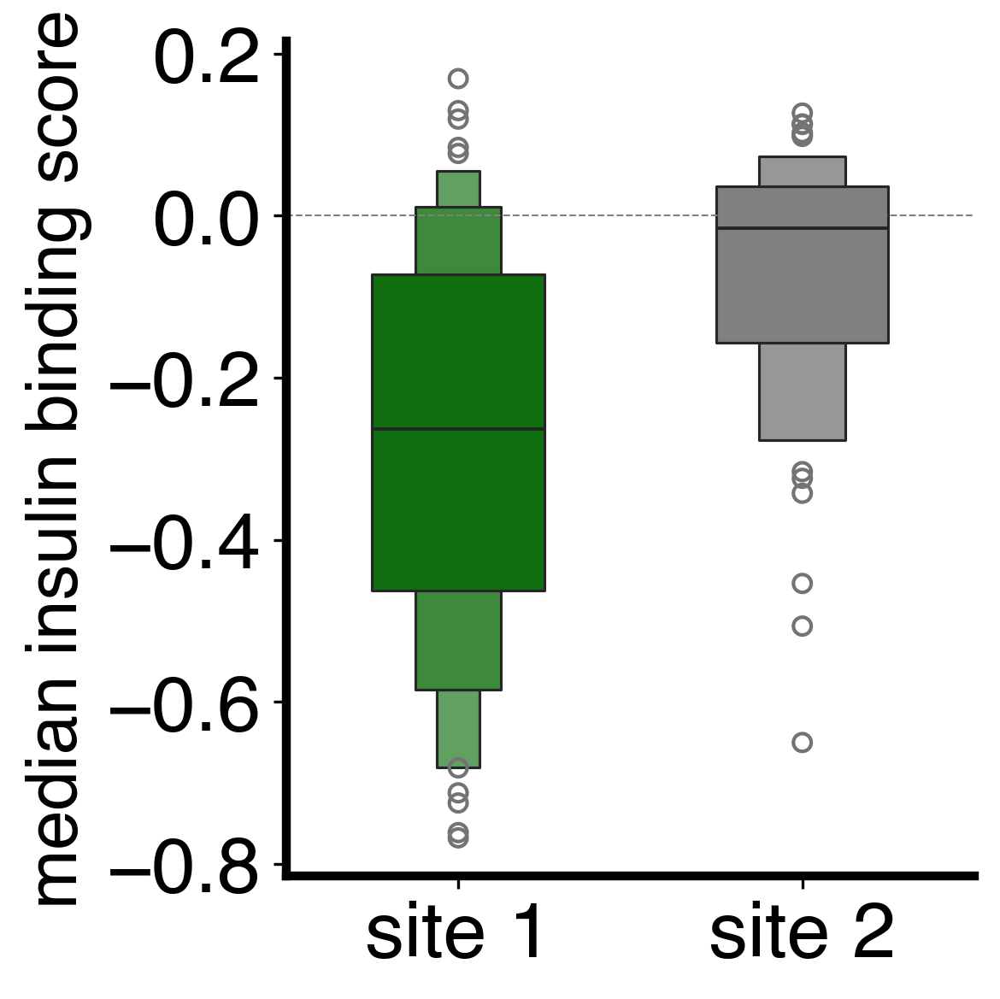

Mann-Whitney U Test: Statistic=995.0, p-value=1.0025852475832e-05


In [ ]:
plt.subplots(figsize=(4, 4))

s1=list(insbind_s1['median_score'])
s2=list(insbind_s2['median_score'])

# Combine data into a single list and create a corresponding list of labels
data = s1 + s2
labels = ['s1'] * len(s1) + ['s2'] * len(s2)

# Create a boxen plot with different colors for each dataset
plot = sns.boxenplot(x=labels, y=data, palette=['g', 'grey'], width=0.5)


fsize=24
plt.xticks([0,1],['site 1','site 2'], size=22)
#plt.title('site 2 residues', size=fsize)
plt.xlabel('')
plt.ylabel('median insulin binding score', size=20)
plt.yticks(size=22)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)


ax=plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)

plt.tight_layout()
plt.savefig('results/figures/Fig2F.pdf')


plt.show()

# Perform t-test
stat, p = mannwhitneyu(s1, s2)
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

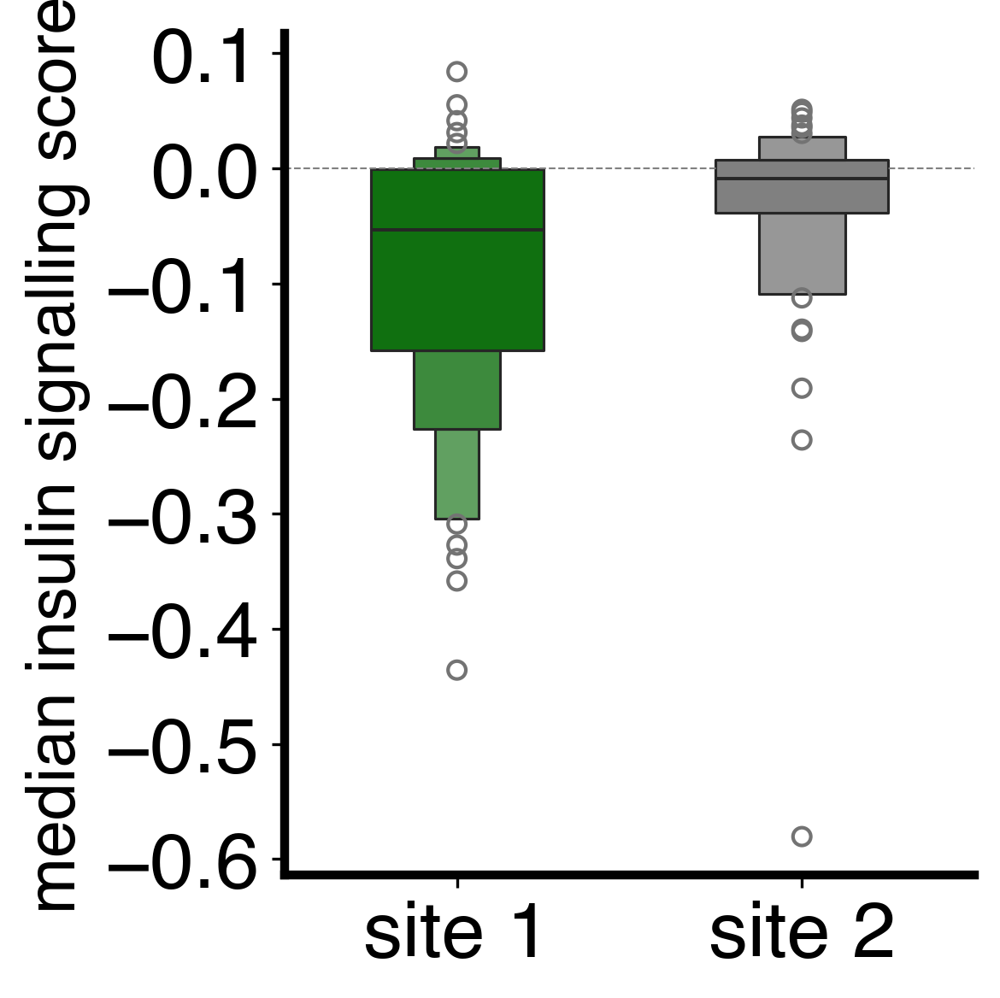

Mann-Whitney U Test: Statistic=1247.0, p-value=0.001586966497514774


In [ ]:
plt.subplots(figsize=(4, 4))

inssign=variantsScore_melt['insSign_avg'].copy()
insbind=variantsScore_melt['insBind_avg'].copy()

inssign_s1=inssign[inssign['site_1']=='yes']
inssign_s2=inssign[inssign['site_2']=='yes']


s1=list(inssign_s1['median_score'])
s2=list(inssign_s2['median_score'])

# Combine data into a single list and create a corresponding list of labels
data = s1 + s2
labels = ['s1'] * len(s1) + ['s2'] * len(s2)

# Create a boxen plot with different colors for each dataset
plot = sns.boxenplot(x=labels, y=data, palette=['g', 'grey'], width=0.5)


fsize=24
plt.xticks([0,1],['site 1','site 2'], size=22)
#plt.title('site 2 residues', size=fsize)
plt.xlabel('')
plt.ylabel('median insulin signalling score', size=19)
plt.yticks(size=22)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)

plt.tight_layout()
plt.savefig('results/figures/Fig4D.pdf')

ax=plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)

plt.show()

# Perform t-test
stat, p = mannwhitneyu(s1, s2)
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

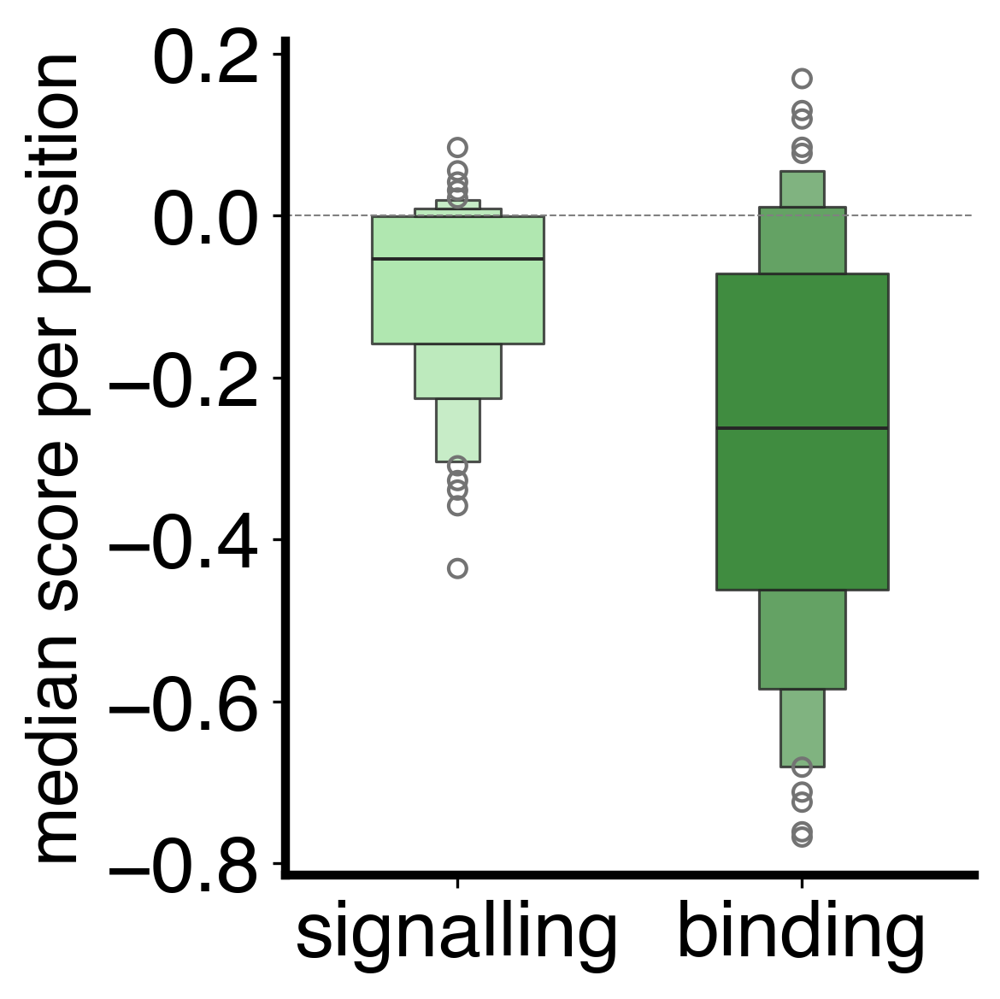

Mann-Whitney U Test: Statistic=30032.0, p-value=0.08982347185537257
Mann-Whitney U Test: Statistic=23152.0, p-value=2.621417174446398e-06


In [ ]:
plt.subplots(figsize=(4, 4))

inssign=variantsScore_melt['insSign_avg'].copy()
insbind=variantsScore_melt['insBind_avg'].copy()

inssign_noSite1=inssign[inssign['site_1']!='yes']
insbind_noSite1=insbind[insbind['site_1']!='yes']

inssign_s1=inssign[inssign['site_1']=='yes']
insbind_s1=insbind[insbind['site_1']=='yes']


inssign_s1['site_1'] = inssign_s1['site_1'].apply(lambda x: 'site_1_inssign' if x == 'yes' else ' ')
insbind_s1['site_1'] = insbind_s1['site_1'].apply(lambda x: 'site_1_insbind' if x == 'yes' else ' ')



df3 = pd.concat([inssign_s1,insbind_s1],ignore_index=True)

palette = {'site_1_inssign': 'lightgreen', 'site_1_insbind': 'green'} 
           

plot=sns.boxenplot(data=df3, x='site_1', y='median_score', hue='site_1',  palette=palette, alpha=0.8, orient='v', width=0.5)

ax=plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)



fsize=24
plt.xticks([0,1],['signalling','binding'], size=22)
#plt.title('site 2 residues', size=fsize)
plt.xlabel('')
plt.ylabel('median score per position', size=20)
plt.yticks(size=22)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)

plt.tight_layout()
plt.savefig('results/figures/Fig4Binset.pdf')

plt.show()

s1=inssign_s1['median_score']
s2=inssign_noSite1['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

s1=insbind_s1['median_score']
s2=insbind_noSite1['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

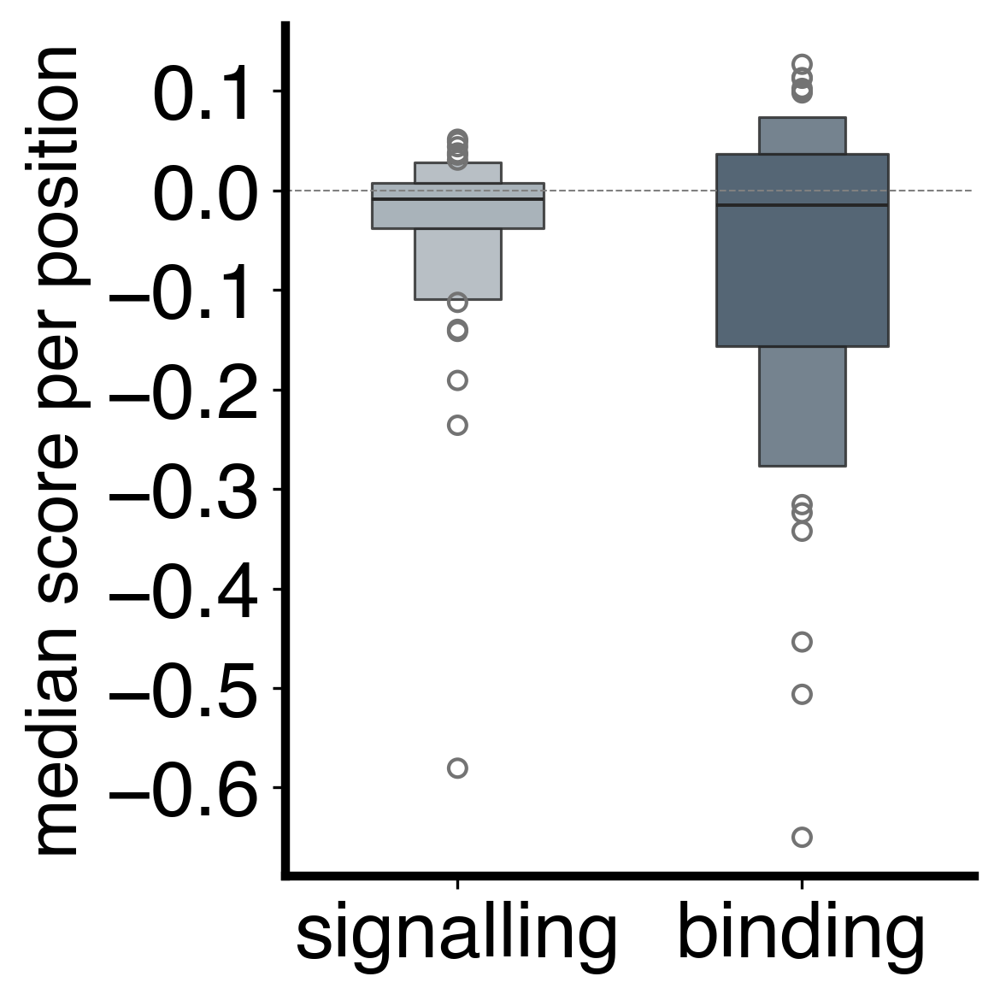

Mann-Whitney U Test: Statistic=26327.0, p-value=0.0016859655848474636
Mann-Whitney U Test: Statistic=25401.0, p-value=0.00870540196622182


In [ ]:
plt.subplots(figsize=(4, 4))

inssign=variantsScore_melt['insSign_avg'].copy()
insbind=variantsScore_melt['insBind_avg'].copy()

inssign_noSite2=inssign[inssign['site_2']!='yes']
insbind_noSite2=insbind[insbind['site_2']!='yes']

inssign_s2=inssign[inssign['site_2']=='yes']
insbind_s2=insbind[insbind['site_2']=='yes']


inssign_s2['site_2'] = inssign_s2['site_2'].apply(lambda x: 'site_2_inssign' if x == 'yes' else ' ')
insbind_s2['site_2'] = insbind_s2['site_2'].apply(lambda x: 'site_2_insbind' if x == 'yes' else ' ')



df3 = pd.concat([inssign_s2,insbind_s2],ignore_index=True)

#palette = {'site_2_inssign': 'lightgreen', 'site_2_insbind': 'green'} 
palette = {'site_2_inssign': '#91A0AC', 'site_2_insbind': '#23415A'} 


plot=sns.boxenplot(data=df3, x='site_2', y='median_score', hue='site_2',  palette=palette, alpha=0.8, orient='v', width=0.5)

ax=plot.axes
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2.5)
ax.spines['left'].set_linewidth(2.5)



fsize=24
plt.xticks([0,1],['signalling','binding'], size=22)
#plt.title('site 2 residues', size=fsize)
plt.xlabel('')
plt.ylabel('median score per position', size=20)
plt.yticks(size=22)
plt.axhline(0, linestyle='--', c='gray', lw=0.5)

plt.tight_layout()
plt.savefig('results/figures/Fig4Binset.pdf')

plt.show()

s1=inssign_s2['median_score']
s2=inssign_noSite2['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

s1=insbind_s2['median_score']
s2=insbind_noSite2['median_score']
stat, p = mannwhitneyu(s1, s2, alternative='two-sided')
print(f'Mann-Whitney U Test: Statistic={stat}, p-value={p}')

### plot expression and insulin binding for missense and disulfide cysteine variants

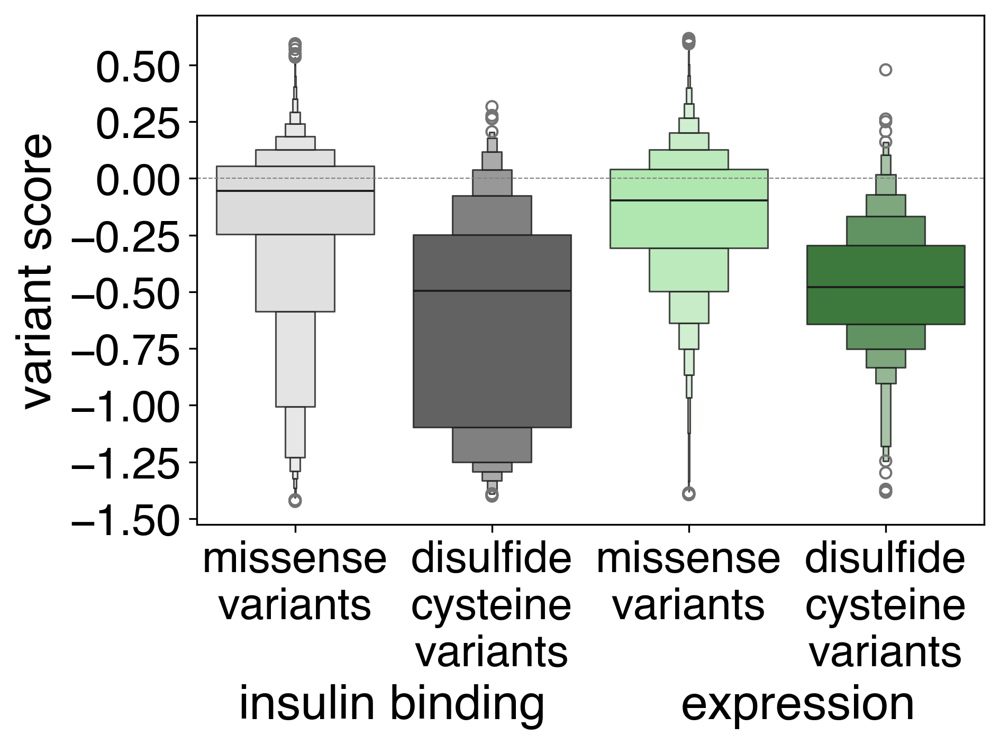

In [ ]:
exp=variants_score_dict['a07a14_Bind_avg'].copy()
insbind=variants_score_dict['insBind_avg'].copy()



exp['c_c'] = exp['c_c'].apply(lambda x: 'disulfide\ncysteine\nvariants\nexp' if x == 'yes' else 'missense\nvariants\nexp')
insbind['c_c'] = insbind['c_c'].apply(lambda x: 'disulfide\ncysteine\nvariants\nins' if x == 'yes' else 'missense\nvariants\nins')

#insbind['c_c'] = insbind['site_1'].apply(lambda x: 'site_1_ins' if x == 'yes' else 'site_1')


df3 = pd.concat([exp,insbind], ignore_index=True)

palette = {'disulfide\ncysteine\nvariants\nexp': '#3b3b3b',
           'disulfide\ncysteine\nvariants\nins': 'darkgreen',
           'missense\nvariants\nexp': 'lightgrey',
           'missense\nvariants\nins': 'lightgreen'}
           

#plt.figure(figsize=(8, 6))  # Adjust the figure size as needed
sns.boxenplot(data=df3, x='c_c', y='variant_score', hue='c_c',  palette=palette, alpha=0.8)

plt.axhline(0, linestyle='--', c='gray', lw=0.5)

plt.xlabel('      insulin binding          expression        ', size=22)
plt.ylabel('variant score', size=22)
plt.xticks(size=20)
plt.yticks(size=20)
plt.xticks(ticks=[0, 1, 2, 3], 
           labels=['missense\nvariants', 'disulfide\ncysteine\nvariants',
          'missense\nvariants', 'disulfide\ncysteine\nvariants'])  # Customizing y-tick labels

plt.tight_layout()
plt.savefig('results/figures/SuppFig3B.pdf')

plt.show()


### binary classification of functional variants into wild-type and loss-of-function according to their expression score using confusion matrix analysis

In [ ]:
funcVariants_all

,aa_substitutions,a07a14_Bind_avg,insBind_avg,insSign_avg
0,R41W,blue,NaN,red
1,R41A,blue,NaN,red
2,R41E,blue,NaN,red
3,N42K,blue,purple,purple
4,G58R,red,red,NaN
...,...,...,...,...
57,P874L,red,NaN,NaN
58,N878S,red,NaN,NaN
59,I925T,red,red,NaN
60,R926W,red,red,NaN


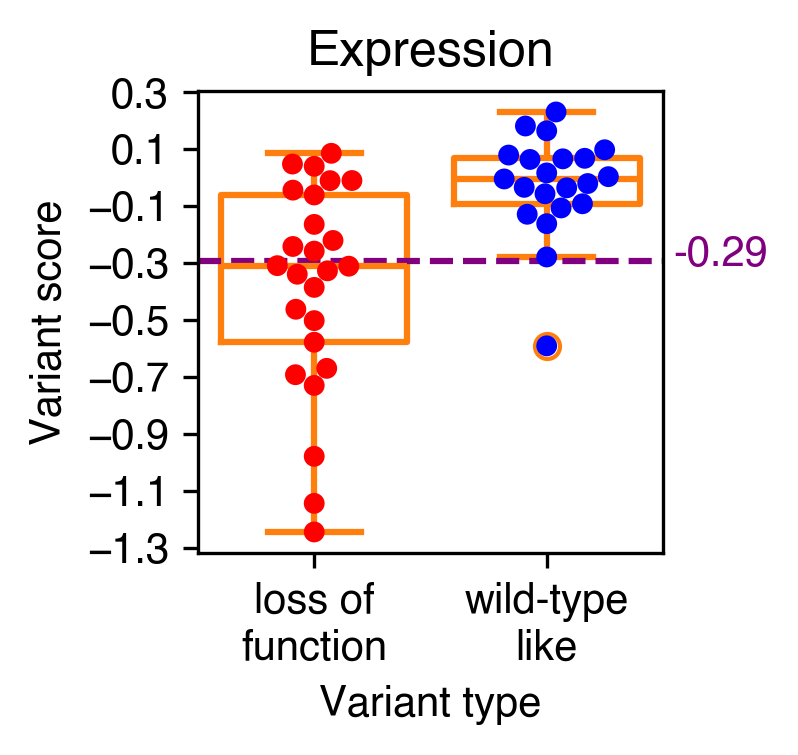

In [ ]:
funcVariants_all=pd.read_csv('input_files/functional_variants.csv')

df=funcVariants_all.copy()
df_exp=variants_score_dict['a07a14_Bind_avg']
exp_func=df.dropna(subset=['a07a14_Bind_avg'])
exp_func=exp_func.merge(df_exp,on='aa_substitutions',  how='left').dropna(subset='variant_score')
exp_func=exp_func[exp_func['a07a14_Bind_avg']!='brown']
exp_func['variant type'] = exp_func['a07a14_Bind_avg'].apply(lambda x: 'wild-type\nlike' if x == 'blue' else 'loss of\nfunction')
X=list(exp_func['variant_score'])
y=list(exp_func['variant type'])

# Create DataFrame for boxplot
df1 = exp_func[['variant_score', 'variant type']]

# Define colors for each label
palette = {'loss of\nfunction': 'red', 'wild-type\nlike': 'blue'}
order = ['loss of\nfunction', 'wild-type\nlike']

plt.figure(figsize=(2,2))
# Create boxplot
sns.swarmplot(data=df1, x='variant type', y='variant_score', palette=palette, order=order)
sns.boxplot(data=df1, x='variant type', y='variant_score', fill=False, order=order)

plt.ylabel('Variant score')
plt.xlabel('Variant type')

plt.title('Expression')

threshold=-0.294
plt.axhline(threshold, linestyle='--', color='purple')
plt.text(1.75, threshold-0.05, f'{threshold:.2f}', 
         ha='center', va='bottom', color='purple')

y_min, y_max = plt.ylim()  # Get current y-axis limits
plt.yticks(np.arange(round(y_min, 1), round(y_max, 1) + 0.2, 0.2))

plt.savefig('results/figures/SuppFig7A.pdf', transparent=True)
plt.show()

Best Threshold: 0.055118925638522304
Number of misclassifications: 33
Misclassified details:
   a07a14_Bind_avg  variant_score predicted_a07a14_Bind_avg
6             blue      -0.591055                       red
8           purple      -0.502500                       red
10          purple      -0.385885                       red
12          purple      -0.327703                       red
13          purple      -0.311496                       red
15            blue      -0.279121                       red
16          purple      -0.258568                       red
17          purple      -0.242345                       red
18          purple      -0.221207                       red
19          purple      -0.164804                       red
20            blue      -0.162322                       red
21            blue      -0.129182                       red
22            blue      -0.107072                       red
23            blue      -0.092352                       red
25     

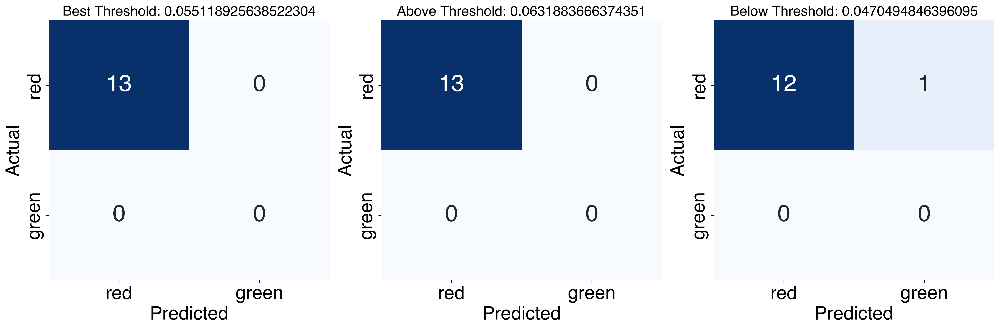

In [ ]:
from sklearn.metrics import confusion_matrix

df=exp_func[['a07a14_Bind_avg','variant_score']]


#df = pd.DataFrame(data)

# Sort by variant_score
df_sorted = df.sort_values(by='variant_score').reset_index(drop=True)
variant_scores = list(df_sorted['variant_score'])[2:-2]

# Calculate means of each two adjacent scores and add them to the scores list
mean_scores = [(variant_scores[i] + variant_scores[i + 1]) / 2 for i in range(len(variant_scores) - 1)]
all_scores = sorted(variant_scores + mean_scores)

# Initialize variables to store the best threshold and minimum misclassifications
best_threshold = None
min_misclassifications = float('inf')
best_misclassified = None
best_fdr = None

# Store results for each threshold
results = []

# Evaluate each threshold
for threshold in all_scores:
    # Apply classification based on the threshold
    df_sorted['predicted_a07a14_Bind_avg'] = df_sorted['variant_score'].apply(lambda x: 'red' if x < threshold else 'green')

    # Calculate the number of misclassifications
    misclassified = df_sorted[df_sorted['a07a14_Bind_avg'] != df_sorted['predicted_a07a14_Bind_avg']]
    num_misclassified = len(misclassified)

    # Calculate FDR (False Discovery Rate)
    false_positives = df_sorted[(df_sorted['predicted_a07a14_Bind_avg'] == 'red') & (df_sorted['a07a14_Bind_avg'] == 'green')]
    true_positives = df_sorted[(df_sorted['predicted_a07a14_Bind_avg'] == 'red') & (df_sorted['a07a14_Bind_avg'] == 'red')]
    fdr = len(false_positives) / (len(false_positives) + len(true_positives)) if (len(false_positives) + len(true_positives)) > 0 else 0

    # Store results
    results.append((threshold, num_misclassified, misclassified, fdr))

    # Update the best threshold if the current one has fewer misclassifications
    if num_misclassified < min_misclassifications:
        best_threshold = threshold
        min_misclassifications = num_misclassified
        best_misclassified = misclassified
        best_fdr = fdr

# Find indices of best threshold, and the ones above and below
best_index = all_scores.index(best_threshold)
above_threshold = all_scores[best_index + 1] if best_index + 1 < len(all_scores) else None
below_threshold = all_scores[best_index - 1] if best_index - 1 >= 0 else None

# Function to print details for a given threshold
def print_threshold_details(threshold, df, results):
    for res in results:
        if res[0] == threshold:
            print(f'\nThreshold: {threshold}')
            print(f'Number of misclassifications: {res[1]}')
            print('Misclassified details:')
            print(res[2][['a07a14_Bind_avg', 'variant_score', 'predicted_a07a14_Bind_avg']])
            print(f'False Discovery Rate (FDR): {res[3]:.2f}')
            return res[2], res[3]

# Print results for the best threshold
print(f'Best Threshold: {best_threshold}')
print(f'Number of misclassifications: {min_misclassifications}')
print('Misclassified details:')
print(best_misclassified[['a07a14_Bind_avg', 'variant_score', 'predicted_a07a14_Bind_avg']])
print(f'False Discovery Rate (FDR): {best_fdr:.2f}')

# Print results for the threshold above
if above_threshold:
    above_misclassified, above_fdr = print_threshold_details(above_threshold, df_sorted, results)

# Print results for the threshold below
if below_threshold:
    below_misclassified, below_fdr = print_threshold_details(below_threshold, df_sorted, results)

# Plot confusion matrices
def plot_confusion_matrix(df, threshold, ax, title):
    df['predicted_a07a14_Bind_avg'] = df['variant_score'].apply(lambda x: 'red' if x < threshold else 'green')
    cm = confusion_matrix(df['a07a14_Bind_avg'], df['predicted_a07a14_Bind_avg'], labels=['red', 'green'])
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=ax, annot_kws={"size": 30})
    ax.set_title(title, fontsize=18)
    ax.set_xlabel('Predicted', fontsize=24)
    ax.set_ylabel('Actual', fontsize=24)
    ax.set_xticklabels(['red', 'green'], fontsize=24)
    ax.set_yticklabels(['red', 'green'], fontsize=24)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot confusion matrix for the best threshold
plot_confusion_matrix(df_sorted.copy(), best_threshold, axes[0], f'Best Threshold: {best_threshold}')

# Plot confusion matrix for the threshold above
if above_threshold:
    plot_confusion_matrix(df_sorted.copy(), above_threshold, axes[1], f'Above Threshold: {above_threshold}')

# Plot confusion matrix for the threshold below
if below_threshold:
    plot_confusion_matrix(df_sorted.copy(), below_threshold, axes[2], f'Below Threshold: {below_threshold}')

plt.tight_layout()
plt.show()

### binary classification of functional variants into wild-type and loss-of-function according to their insulin binding score using confusion matrix analysis

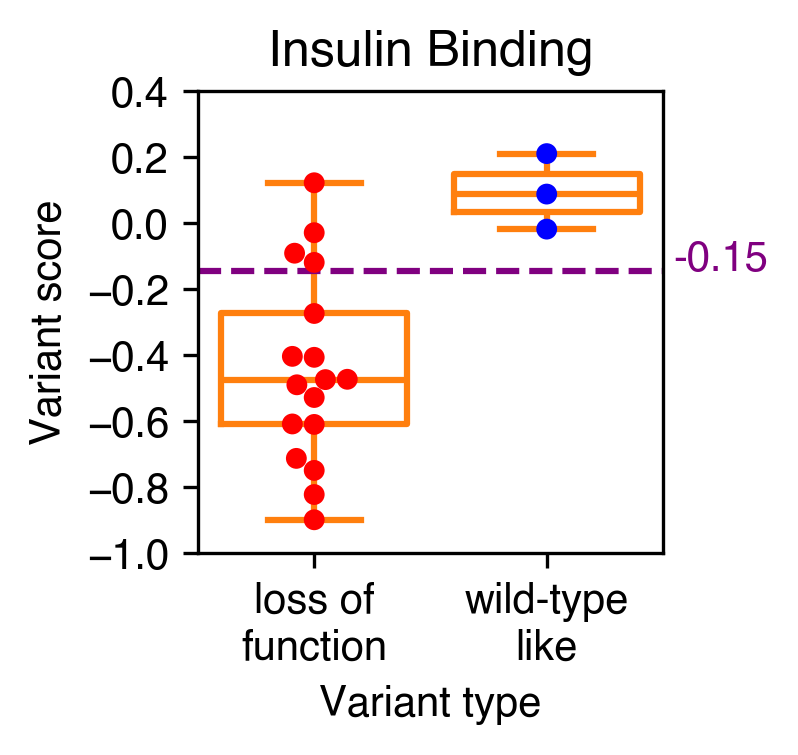

In [ ]:
funcVariants_all=pd.read_csv('input_files/functional_variants.csv')

df=funcVariants_all.copy()
df_exp=variants_score_dict['insBind_avg']
exp_func=df.dropna(subset=['insBind_avg'])
exp_func=exp_func.merge(df_exp,on='aa_substitutions',  how='left').dropna(subset='variant_score')
exp_func=exp_func[exp_func['insBind_avg']!='brown']
exp_func['variant type'] = exp_func['insBind_avg'].apply(lambda x: 'wild-type\nlike' if x == 'blue' else 'loss of\nfunction')
X=list(exp_func['variant_score'])
y=list(exp_func['variant type'])

# Create DataFrame for boxplot
df1 = exp_func[['variant_score', 'variant type']]

# Define colors for each label
palette = {'wild-type\nlike': 'blue', 'loss of\nfunction': 'red'}

plt.figure(figsize=(2,2))
# Create boxplot
sns.swarmplot(data=df1, x='variant type', y='variant_score', palette=palette)
sns.boxplot(data=df1, x='variant type', y='variant_score', fill=False)

plt.ylabel('Variant score')
plt.xlabel('Variant type')

plt.title('Insulin Binding')

threshold=-0.1464
plt.axhline(threshold, linestyle='--', color='purple')
plt.text(1.75, threshold-0.025, f'{threshold:.2f}', 
         ha='center', va='bottom', color='purple')
y_min, y_max = plt.ylim()  # Get current y-axis limits
plt.yticks(np.arange(round(y_min, 1), round(y_max, 1) + 0.2, 0.2))

plt.savefig('results/figures/SuppFig7B.pdf', transparent=True)
plt.show()

### binary classification of functional variants into wild-type and loss-of-function according to their insulin signalling score using confusion matrix analysis

Best Threshold: -0.14645652254440047
Number of misclassifications: 0
Misclassified details:
Empty DataFrame
Columns: [insBind_avg, variant_score, predicted_insBind_avg]
Index: []
False Discovery Rate (FDR): 0.00

Threshold: -0.018629502994029278
Number of misclassifications: 0
Misclassified details:
Empty DataFrame
Columns: [insBind_avg, variant_score, predicted_insBind_avg]
Index: []
False Discovery Rate (FDR): 0.00

Threshold: -0.2742835420947717
Number of misclassifications: 1
Misclassified details:
  insBind_avg  variant_score predicted_insBind_avg
9         red      -0.274284                 green
False Discovery Rate (FDR): 0.00


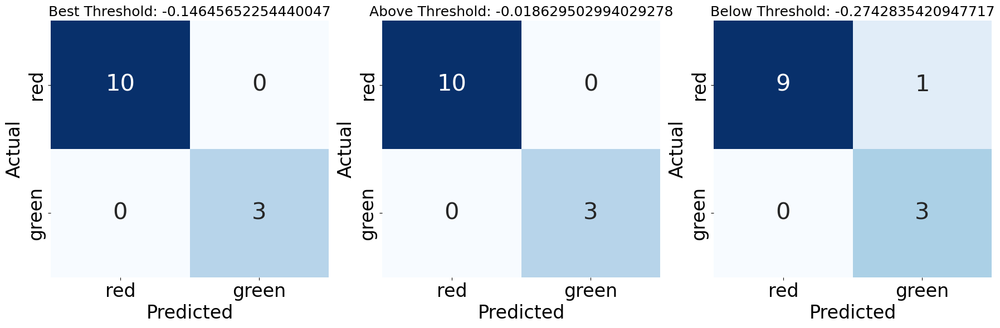

In [ ]:
df=exp_func[['insBind_avg','variant_score']]

# Sort by variant_score
df_sorted = df.sort_values(by='variant_score').reset_index(drop=True)
variant_scores = list(df_sorted['variant_score'])[2:-2]

# Calculate means of each two adjacent scores and add them to the scores list
mean_scores = [(variant_scores[i] + variant_scores[i + 1]) / 2 for i in range(len(variant_scores) - 1)]
all_scores = sorted(variant_scores + mean_scores)

# Initialize variables to store the best threshold and minimum misclassifications
best_threshold = None
min_misclassifications = float('inf')
best_misclassified = None
best_fdr = None

# Store results for each threshold
results = []

# Evaluate each threshold
for threshold in all_scores:
    # Apply classification based on the threshold
    df_sorted['predicted_insBind_avg'] = df_sorted['variant_score'].apply(lambda x: 'red' if x < threshold else 'green')

    # Calculate the number of misclassifications
    misclassified = df_sorted[df_sorted['insBind_avg'] != df_sorted['predicted_insBind_avg']]
    num_misclassified = len(misclassified)

    # Calculate FDR (False Discovery Rate)
    false_positives = df_sorted[(df_sorted['predicted_insBind_avg'] == 'red') & (df_sorted['insBind_avg'] == 'green')]
    true_positives = df_sorted[(df_sorted['predicted_insBind_avg'] == 'red') & (df_sorted['insBind_avg'] == 'red')]
    fdr = len(false_positives) / (len(false_positives) + len(true_positives)) if (len(false_positives) + len(true_positives)) > 0 else 0

    # Store results
    results.append((threshold, num_misclassified, misclassified, fdr))

    # Update the best threshold if the current one has fewer misclassifications
    if num_misclassified < min_misclassifications:
        best_threshold = threshold
        min_misclassifications = num_misclassified
        best_misclassified = misclassified
        best_fdr = fdr

# Find indices of best threshold, and the ones above and below
best_index = all_scores.index(best_threshold)
above_threshold = all_scores[best_index + 1] if best_index + 1 < len(all_scores) else None
below_threshold = all_scores[best_index - 1] if best_index - 1 >= 0 else None

# Function to print details for a given threshold
def print_threshold_details(threshold, df, results):
    for res in results:
        if res[0] == threshold:
            print(f'\nThreshold: {threshold}')
            print(f'Number of misclassifications: {res[1]}')
            print('Misclassified details:')
            print(res[2][['insBind_avg', 'variant_score', 'predicted_insBind_avg']])
            print(f'False Discovery Rate (FDR): {res[3]:.2f}')
            return res[2], res[3]

# Print results for the best threshold
print(f'Best Threshold: {best_threshold}')
print(f'Number of misclassifications: {min_misclassifications}')
print('Misclassified details:')
print(best_misclassified[['insBind_avg', 'variant_score', 'predicted_insBind_avg']])
print(f'False Discovery Rate (FDR): {best_fdr:.2f}')

# Print results for the threshold above
if above_threshold:
    above_misclassified, above_fdr = print_threshold_details(above_threshold, df_sorted, results)

# Print results for the threshold below
if below_threshold:
    below_misclassified, below_fdr = print_threshold_details(below_threshold, df_sorted, results)

# Plot confusion matrices
def plot_confusion_matrix(df, threshold, ax, title):
    df['predicted_insBind_avg'] = df['variant_score'].apply(lambda x: 'red' if x < threshold else 'green')
    cm = confusion_matrix(df['insBind_avg'], df['predicted_insBind_avg'], labels=['red', 'green'])
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=ax, annot_kws={"size": 30})
    ax.set_title(title, fontsize=18)
    ax.set_xlabel('Predicted', fontsize=24)
    ax.set_ylabel('Actual', fontsize=24)
    ax.set_xticklabels(['red', 'green'], fontsize=24)
    ax.set_yticklabels(['red', 'green'], fontsize=24)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot confusion matrix for the best threshold
plot_confusion_matrix(df_sorted.copy(), best_threshold, axes[0], f'Best Threshold: {best_threshold}')

# Plot confusion matrix for the threshold above
if above_threshold:
    plot_confusion_matrix(df_sorted.copy(), above_threshold, axes[1], f'Above Threshold: {above_threshold}')

# Plot confusion matrix for the threshold below
if below_threshold:
    plot_confusion_matrix(df_sorted.copy(), below_threshold, axes[2], f'Below Threshold: {below_threshold}')

plt.tight_layout()
plt.show()

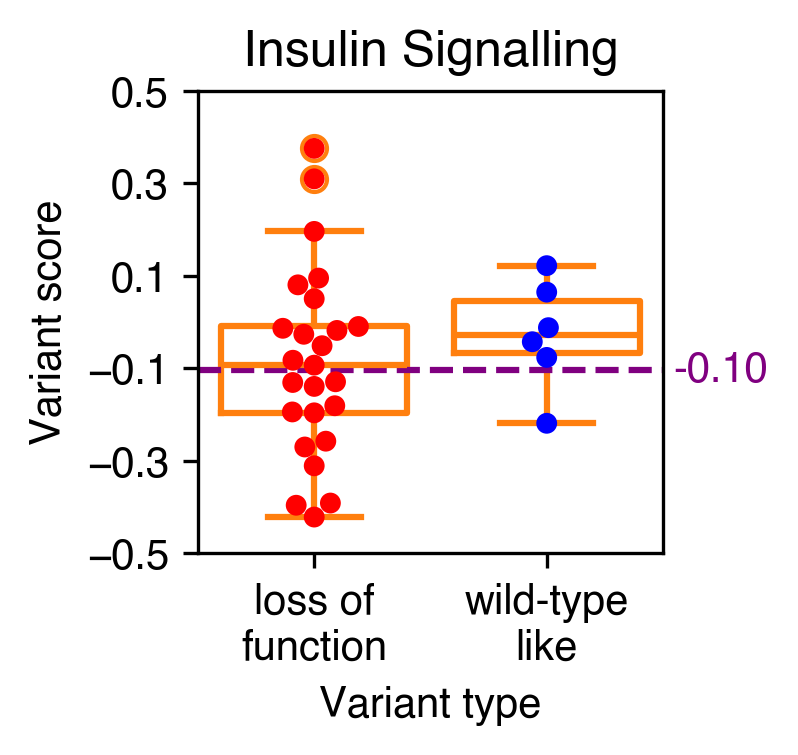

In [ ]:
funcVariants_all=pd.read_csv('input_files/functional_variants.csv')

df=funcVariants_all.copy()
df_exp=variants_score_dict['insSign_avg']
exp_func=df.dropna(subset=['insSign_avg'])
exp_func=exp_func.merge(df_exp,on='aa_substitutions',  how='left').dropna(subset='variant_score')
exp_func=exp_func[exp_func['insSign_avg']!='brown']
exp_func['variant type'] = exp_func['insSign_avg'].apply(lambda x: 'wild-type\nlike' if x == 'blue' else 'loss of\nfunction')
X=list(exp_func['variant_score'])
y=list(exp_func['variant type'])

# Create DataFrame for boxplot
df1 = exp_func[['variant_score', 'variant type']]

# Define colors for each label
palette = {'wild-type\nlike': 'blue', 'loss of\nfunction': 'red'}

plt.figure(figsize=(2,2))
# Create boxplot
sns.swarmplot(data=df1, x='variant type', y='variant_score', palette=palette)
sns.boxplot(data=df1, x='variant type', y='variant_score', fill=False)

plt.ylabel('Variant score')
plt.xlabel('Variant type')

plt.title('Insulin Signalling')

threshold=-0.103
plt.axhline(threshold, linestyle='--', color='purple')
plt.text(1.75, threshold-0.045, f'{threshold:.2f}', 
         ha='center', va='bottom', color='purple')

y_min, y_max = plt.ylim()  # Get current y-axis limits
plt.yticks(np.arange(round(y_min, 1), round(y_max, 1) + 0.2, 0.2))


plt.savefig('results/figures/SuppFig7C.pdf', transparent=True)
plt.show()

Best Threshold: -0.1030865316223245
Number of misclassifications: 1
Misclassified details:
  insSign_avg  variant_score predicted_insSign_avg
4       green      -0.219303                   red
False Discovery Rate (FDR): 0.11

Threshold: -0.07671470176836397
Number of misclassifications: 1
Misclassified details:
  insSign_avg  variant_score predicted_insSign_avg
4       green      -0.219303                   red
False Discovery Rate (FDR): 0.11

Threshold: -0.12945836147628503
Number of misclassifications: 2
Misclassified details:
  insSign_avg  variant_score predicted_insSign_avg
4       green      -0.219303                   red
8         red      -0.129458                 green
False Discovery Rate (FDR): 0.12


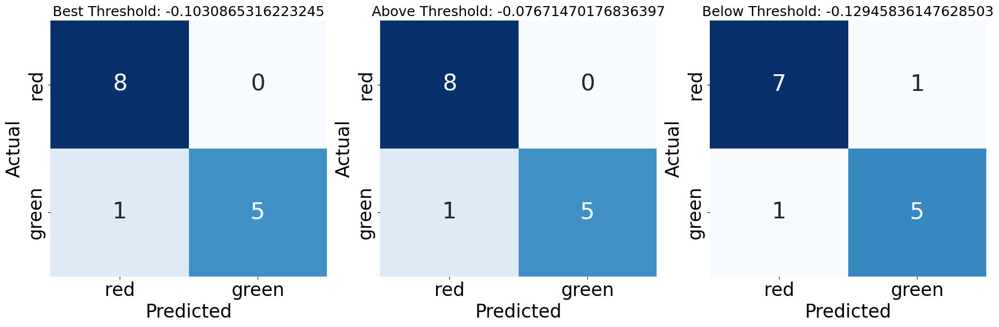

In [ ]:
df=exp_func[['insSign_avg','variant_score']]


#df = pd.DataFrame(data)

# Sort by variant_score
df_sorted = df.sort_values(by='variant_score').reset_index(drop=True)
variant_scores = list(df_sorted['variant_score'])[2:-2]

# Calculate means of each two adjacent scores and add them to the scores list
mean_scores = [(variant_scores[i] + variant_scores[i + 1]) / 2 for i in range(len(variant_scores) - 1)]
all_scores = sorted(variant_scores + mean_scores)

# Initialize variables to store the best threshold and minimum misclassifications
best_threshold = None
min_misclassifications = float('inf')
best_misclassified = None
best_fdr = None

# Store results for each threshold
results = []

# Evaluate each threshold
for threshold in all_scores:
    # Apply classification based on the threshold
    df_sorted['predicted_insSign_avg'] = df_sorted['variant_score'].apply(lambda x: 'red' if x < threshold else 'green')

    # Calculate the number of misclassifications
    misclassified = df_sorted[df_sorted['insSign_avg'] != df_sorted['predicted_insSign_avg']]
    num_misclassified = len(misclassified)

    # Calculate FDR (False Discovery Rate)
    false_positives = df_sorted[(df_sorted['predicted_insSign_avg'] == 'red') & (df_sorted['insSign_avg'] == 'green')]
    true_positives = df_sorted[(df_sorted['predicted_insSign_avg'] == 'red') & (df_sorted['insSign_avg'] == 'red')]
    fdr = len(false_positives) / (len(false_positives) + len(true_positives)) if (len(false_positives) + len(true_positives)) > 0 else 0

    # Store results
    results.append((threshold, num_misclassified, misclassified, fdr))

    # Update the best threshold if the current one has fewer misclassifications
    if num_misclassified < min_misclassifications:
        best_threshold = threshold
        min_misclassifications = num_misclassified
        best_misclassified = misclassified
        best_fdr = fdr

# Find indices of best threshold, and the ones above and below
best_index = all_scores.index(best_threshold)
above_threshold = all_scores[best_index + 1] if best_index + 1 < len(all_scores) else None
below_threshold = all_scores[best_index - 1] if best_index - 1 >= 0 else None

# Function to print details for a given threshold
def print_threshold_details(threshold, df, results):
    for res in results:
        if res[0] == threshold:
            print(f'\nThreshold: {threshold}')
            print(f'Number of misclassifications: {res[1]}')
            print('Misclassified details:')
            print(res[2][['insSign_avg', 'variant_score', 'predicted_insSign_avg']])
            print(f'False Discovery Rate (FDR): {res[3]:.2f}')
            return res[2], res[3]

# Print results for the best threshold
print(f'Best Threshold: {best_threshold}')
print(f'Number of misclassifications: {min_misclassifications}')
print('Misclassified details:')
print(best_misclassified[['insSign_avg', 'variant_score', 'predicted_insSign_avg']])
print(f'False Discovery Rate (FDR): {best_fdr:.2f}')

# Print results for the threshold above
if above_threshold:
    above_misclassified, above_fdr = print_threshold_details(above_threshold, df_sorted, results)

# Print results for the threshold below
if below_threshold:
    below_misclassified, below_fdr = print_threshold_details(below_threshold, df_sorted, results)

# Plot confusion matrices
def plot_confusion_matrix(df, threshold, ax, title):
    df['predicted_insSign_avg'] = df['variant_score'].apply(lambda x: 'red' if x < threshold else 'green')
    cm = confusion_matrix(df['insSign_avg'], df['predicted_insSign_avg'], labels=['red', 'green'])
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=ax, annot_kws={"size": 30})
    ax.set_title(title, fontsize=18)
    ax.set_xlabel('Predicted', fontsize=24)
    ax.set_ylabel('Actual', fontsize=24)
    ax.set_xticklabels(['red', 'green'], fontsize=24)
    ax.set_yticklabels(['red', 'green'], fontsize=24)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot confusion matrix for the best threshold
plot_confusion_matrix(df_sorted.copy(), best_threshold, axes[0], f'Best Threshold: {best_threshold}')

# Plot confusion matrix for the threshold above
if above_threshold:
    plot_confusion_matrix(df_sorted.copy(), above_threshold, axes[1], f'Above Threshold: {above_threshold}')

# Plot confusion matrix for the threshold below
if below_threshold:
    plot_confusion_matrix(df_sorted.copy(), below_threshold, axes[2], f'Below Threshold: {below_threshold}')

plt.tight_layout()
plt.show()

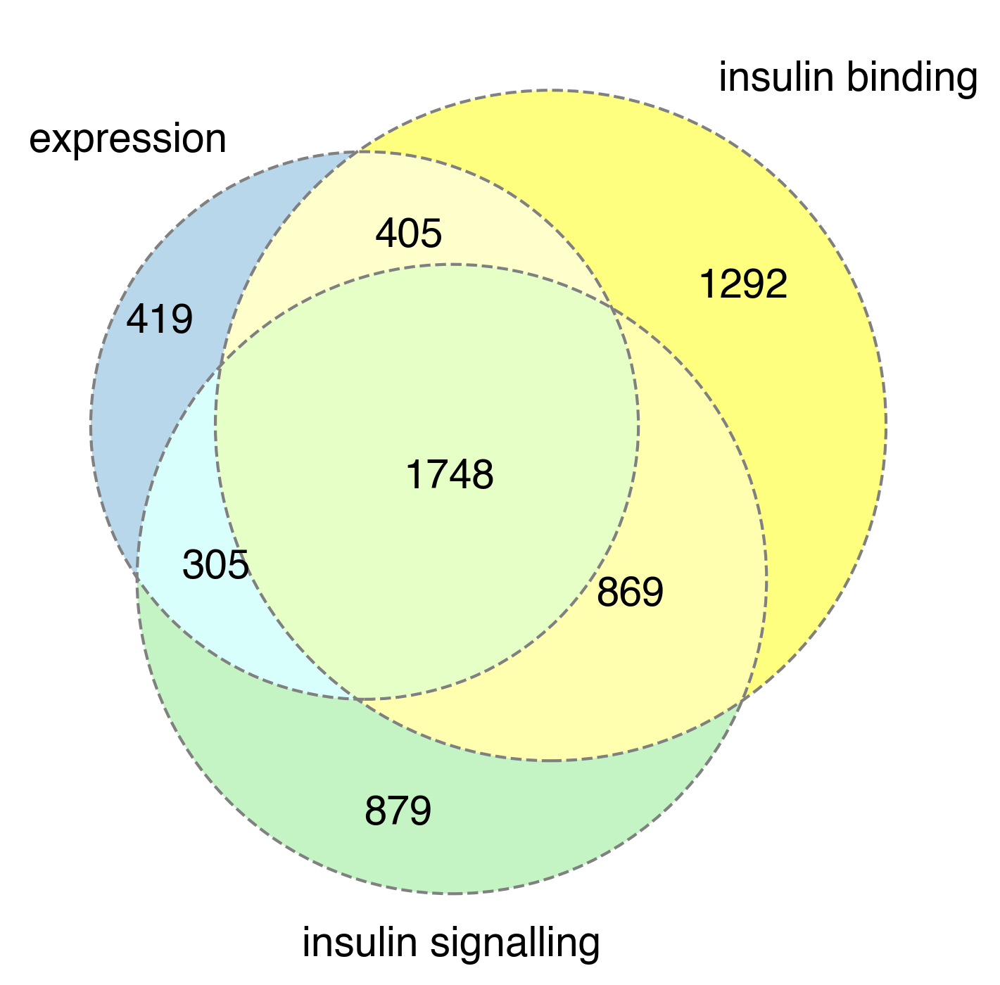

In [ ]:
df=variants_score.copy()
df=df.dropna(subset=['a07a14_Bind_avg','insBind_avg','insSign_avg'])

scored_inAll3=list(df.aa_substitutions)

df_exp=df.copy()
df_insSign=df.copy()
df_insBind=df.copy()

df_exp=df_exp.dropna(subset=['a07a14_Bind_avg','a07BindR1','a07BindR2','a14BindR1','a14BindR2'])
df_exp_aaList=list(df_exp.aa_substitutions)

df_insSign=df_insSign.dropna(subset=['insSign_avg','insSignR1','insSignR2','insSignR3','insSignR4','insSignR5'])
df_insSign_aaList=list(df_insSign.aa_substitutions)

df_insBind=df_insBind.dropna(subset=['insBind_avg','insBindR1','insBindR2'])
df_insBind_aaList=list(df_insBind.aa_substitutions)


df_exp=variants_score_dict['a07a14_Bind_avg']
#expressed in all three assays
df_exp=df_exp[df_exp['aa_substitutions'].isin(scored_inAll3)]
#expressed in all all the replicates
df_exp=df_exp[df_exp['aa_substitutions'].isin(df_exp_aaList)]
#get variants with FDR < 0.05
df_exp=df_exp[df_exp['FDRvalues'] <= 0.05]


df_insBind=variants_score_dict['insBind_avg']
#expressed in all three assays
df_insBind=df_insBind[df_insBind['aa_substitutions'].isin(scored_inAll3)]
#expressed in all all the replicates
df_insBind=df_insBind[df_insBind['aa_substitutions'].isin(df_insBind_aaList)]
#get variants with FDR < 0.05
df_insBind=df_insBind[df_insBind['FDRvalues'] <= 0.05]


df_insSign=variants_score_dict['insSign_avg']
#expressed in all three assays
df_insSign=df_insSign[df_insSign['aa_substitutions'].isin(scored_inAll3)]
#expressed in all all the replicates
df_insSign=df_insSign[df_insSign['aa_substitutions'].isin(df_insSign_aaList)]
#get variants with FDR < 0.05
df_insSign=df_insSign[df_insSign['FDRvalues'] <= 0.05]



noExp=set(df_exp[df_exp['variant_score'] < -0.29436108315799264]['aa_substitutions'])

noBind=set(df_insBind[(df_insBind['variant_score'] < -0.14645652254440045) ]['aa_substitutions'])

noSign=set(df_insSign[(df_insSign['variant_score'] < -0.10308653162232445) ]['aa_substitutions'])


set1_aa_substitutions_loss = noExp
set2_aa_substitutions_loss = noBind
set3_aa_substitutions_loss = noSign

# Create the Venn diagram for Loss
out=venn3([set1_aa_substitutions_loss, set2_aa_substitutions_loss, set3_aa_substitutions_loss],
      ('expression', 'insulin binding', 'insulin signalling'),
     set_colors=('#74B1D9','#FFFF00','#8AEA8A'),
         alpha=0.5)

venn3_circles(subsets = [set1_aa_substitutions_loss, set2_aa_substitutions_loss, set3_aa_substitutions_loss]
              , linestyle='dashed', linewidth=1, color="grey")

for text in out.set_labels:
    text.set_fontsize(14)
for text in out.subset_labels:
    text.set_fontsize(14)
    
# Adjust layout
plt.tight_layout()
plt.savefig('results/figures/SuppFig7D.pdf')
plt.show()


### dividing loss of expression variant scores into 5 bins

Bin Borders:
Bin 1: -1.424359812043256 - -1.1394882801087696
Bin 2: -1.1394882801087696 - -0.854616748174283
Bin 3: -0.854616748174283 - -0.5697452162397966
Bin 4: -0.5697452162397966 - -0.2848736843053101
Bin 5: -0.2848736843053101 - -2.152370823685424e-06


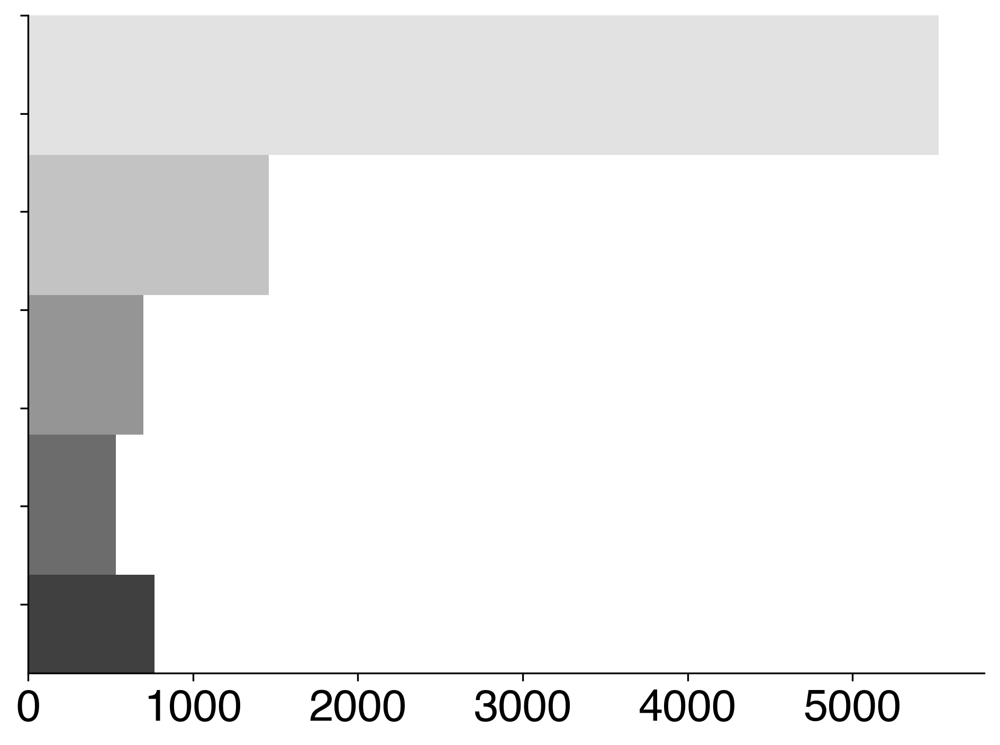

In [ ]:
exp_score=variants_score_dict['a07a14_Bind_avg']['variant_score']
scores_neg = [value for value in exp_score if value < 0]

hist, bin_edges = np.histogram(scores_neg, bins=5)

from matplotlib.cm import Greys

# Get the patches for the histogram bars
_, _, patches = plt.hist(scores_neg, bins=5, orientation='horizontal')

# Generate colors from the reversed Greys colormap
cmap_reversed = Greys(np.linspace(0.8, 0.2, len(patches)))

# Set colors for each bar from light to dark grey
for patch, color in zip(patches, cmap_reversed):
    patch.set_facecolor(color)

# Print the bin borders
print("Bin Borders:")
for i in range(len(bin_edges) - 1):
    print(f"Bin {i+1}: {bin_edges[i]} - {bin_edges[i+1]}")

# Customize the plot
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(-1.34, 0)
plt.xticks(size=20)
plt.yticks()
plt.gca().set_yticklabels([])  # Removes labels but keeps tick marks

plt.tight_layout()
plt.savefig('results/figures/SuppFig3F.pdf')
plt.show()


In [ ]:
### dividing loss of signalling variant scores into 5 bins

Bin Borders:
Bin 1: -1.3704044386167171 - -1.0963237782349657
Bin 2: -1.0963237782349657 - -0.8222431178532141
Bin 3: -0.8222431178532141 - -0.5481624574714626
Bin 4: -0.5481624574714626 - -0.27408179708971114
Bin 5: -0.27408179708971114 - -1.136707959848732e-06


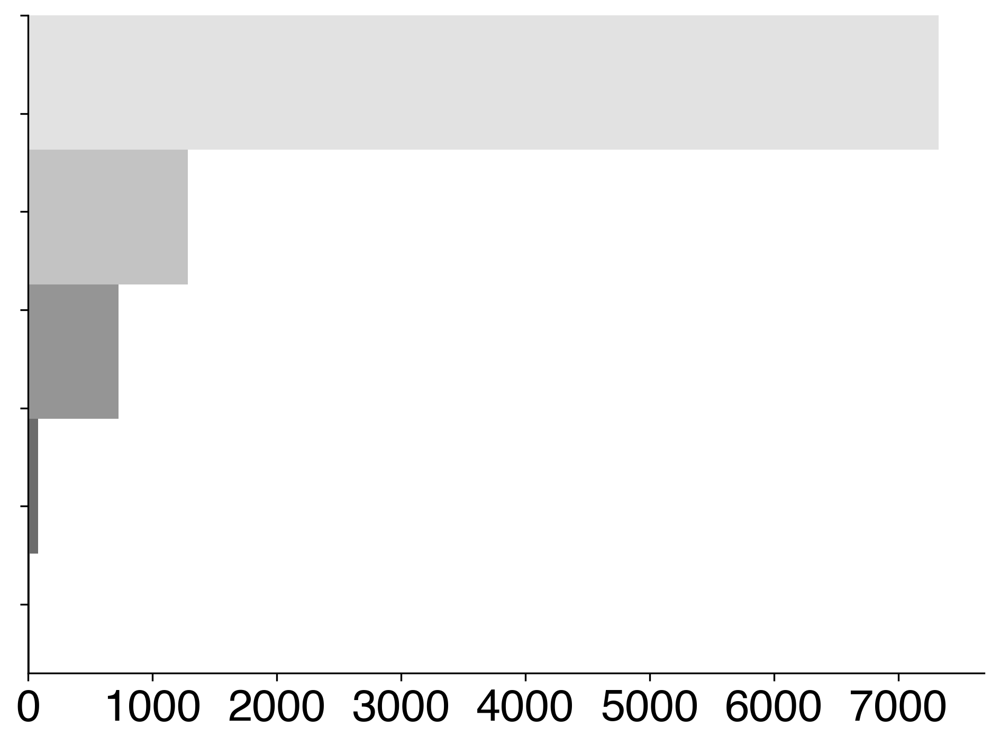

In [ ]:
exp_score=variants_score_dict['insSign_avg']['variant_score']
scores_neg = [value for value in exp_score if value < 0]

hist, bin_edges = np.histogram(scores_neg, bins=5)

from matplotlib.cm import Greys

# Get the patches for the histogram bars
_, _, patches = plt.hist(scores_neg, bins=5, orientation='horizontal')

# Generate colors from the reversed Greys colormap
cmap_reversed = Greys(np.linspace(0.8, 0.2, len(patches)))

# Set colors for each bar from light to dark grey
for patch, color in zip(patches, cmap_reversed):
    patch.set_facecolor(color)

# Print the bin borders
print("Bin Borders:")
for i in range(len(bin_edges) - 1):
    print(f"Bin {i+1}: {bin_edges[i]} - {bin_edges[i+1]}")

# Customize the plot
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(-1.34, 0)
plt.xticks(size=20)
plt.yticks()
plt.gca().set_yticklabels([])  # Removes labels but keeps tick marks

plt.tight_layout()
plt.savefig('results/figures/Fig6E.pdf')
plt.show()

# --------- find the most targetable variants by the antibodies -------------

### Manhathan plot for variants amenable for activation by mAb83-7

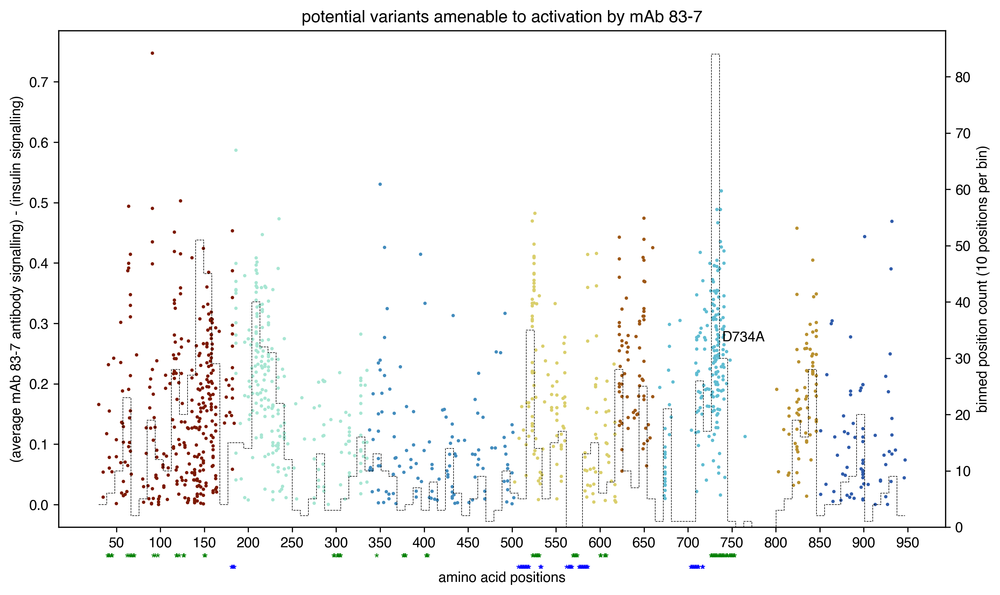

In [ ]:
df=variants_score_dict['insSign_avg'].copy()
insSign_20more=(df[df['variant_score']<-0.204])

insSign_20more=insSign_20more[insSign_20more['insSign_RepCont']==5]
fig, ax1 = plt.subplots(figsize=(10, 6))


df_inSig = insSign_20more
antibodySig = variants_score_dict['a07Sign_avg']
antibodySig=antibodySig[antibodySig['a07Sign_RepCont']==3]

antibodySig=antibodySig[antibodySig['aa_substitutions'].isin(list(df_inSig['aa_substitutions']))]

m1=pd.merge(df_inSig,antibodySig, on='aa_substitutions', suffixes=['_insSign','_antibodySig'])
m1=m1[m1['position_insSign']>27]
m1=m1[m1['variant_score_insSign']<0] #reduced insulin signalling
m1['subtract']=m1['variant_score_antibodySig']-m1['variant_score_insSign']
m1=m1[m1['subtract']>0]

m2=m1[m1['subtract']>0]
mAb83_7_Activated=set(m2['aa_substitutions'])


# Define color ranges and corresponding colors
color_ranges = [
 (28,184,'#7C1900'),
(185,337,'#A8E6D3'),
(338,502,'#438CBD'),
(503,620,'#DACF6D'),
(621,663,'#9E5817'),
(664,758,'#61BDD2'),
(759,764,'w'),
(763,794,'#61BDD2'),
(795,847,'#B99131'),
(848,956,'#305CAB')
]
def get_color(position):
    for start, end, color in color_ranges:
        if start <= position <= end:
            return color
    return 'black'  # default color if position is not within any range

# Generate colors for each point based on 'position_insSign'
colors = [get_color(position) for position in m1['position_insSign']]

# Scatter plot on primary y-axis
ax1.scatter(m1['position_insSign'], m1['subtract'], c=colors, s=2)
ax1.set_ylabel('(average mAb 83-7 antibody signalling) - (insulin signalling)')
ax1.set_xlabel('\namino acid positions')  # Setting x-label here


'''
texts=[]
for i, text in enumerate(m1['aa_substitutions']):
    if m1['subtract'].iloc[i]>0.6 or text == 'D734A':
        texts.append(plt.text(m1['position_insSign'].iloc[i], m1['subtract'].iloc[i], text))
adjust_text(texts, arrowprops=dict(lw=0.5, color='k', arrowstyle='-'))
'''

texts=[]
for i, text in enumerate(m1['aa_substitutions']):
    if text == 'D734A' or text == 'S350L':
        texts.append(plt.text(m1['position_insSign'].iloc[i], m1['subtract'].iloc[i], text))
adjust_text(texts, arrowprops=dict(lw=0.5, color='k', arrowstyle='-'), size=8)
                     
ax2 = ax1.twinx()


# Histogram on secondary y-axis
sns.histplot(data=m1['position_insSign'], bins=100, element='step', color='#000000', fill=False, linewidth=0.4, linestyle='--', label='mAb 8307', ax=ax2)
ax2.set_ylabel('binned position count (10 positions per bin)')
ax2.set_xlabel('positions')
plt.xticks(range(50, 956, 50))
plt.title('potential variants amenable to activation by mAb 83-7')

ab8307_site = [263, 315, 328, 286, 265, 261, 311, 249, 269, 270, 271]
ab8314_site=[504, 506, 622, 515, 577] # derived from scatter plot and structure info, 

for x_coord in site_2:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-8.5), color='b')

for x_coord in site_1:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-6.5), color='g')
    


plt.tight_layout()
plt.savefig('results/figures/Fig6F.pdf')
plt.show()

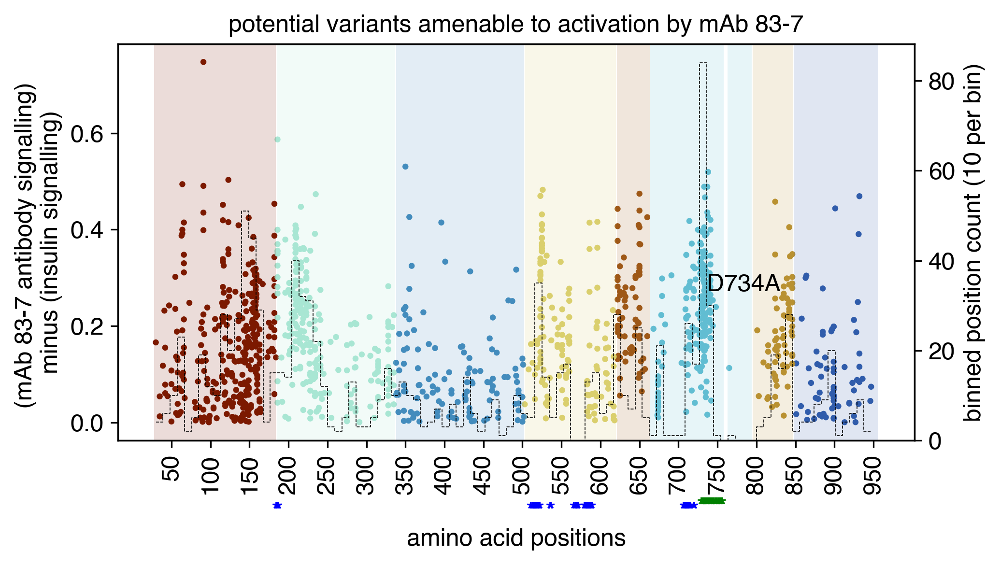

In [ ]:
df=variants_score_dict['insSign_avg'].copy()
insSign_20more=(df[df['variant_score']<-0.204])

insSign_20more=insSign_20more[insSign_20more['insSign_RepCont']==5]
fig, ax1 = plt.subplots(figsize=(7, 4))

df_inSig = insSign_20more
antibodySig = variants_score_dict['a07Sign_avg']
antibodySig=antibodySig[antibodySig['a07Sign_RepCont']==3]
antibodySig=antibodySig[antibodySig['aa_substitutions'].isin(list(df_inSig['aa_substitutions']))]

m1=pd.merge(df_inSig,antibodySig, on='aa_substitutions', suffixes=['_insSign','_antibodySig'])
m1=m1[m1['position_insSign']>27]
m1=m1[m1['variant_score_insSign']<0] #reduced insulin signalling
m1['subtract']=m1['variant_score_antibodySig']-m1['variant_score_insSign']
m1=m1[m1['subtract']>0]

m2=m1[m1['subtract']>0]
mAb83_7_Activated=set(m2['aa_substitutions'])

# Define color ranges and corresponding colors
color_ranges = [
 (28,184,'#7C1900'),
(185,337,'#A8E6D3'),
(338,502,'#438CBD'),
(503,620,'#DACF6D'),
(621,663,'#9E5817'),
(664,758,'#61BDD2'),
(759,764,'w'),
(763,794,'#61BDD2'),
(795,847,'#B99131'),
(848,956,'#305CAB')
]
def get_color(position):
    for start, end, color in color_ranges:
        if start <= position <= end:
            return color
    return 'black'  # default color if position is not within any range

# Generate colors for each point based on 'position_insSign'
colors = [get_color(position) for position in m1['position_insSign']]

# Scatter plot on primary y-axis
ax1.scatter(m1['position_insSign'], m1['subtract'], c=colors, s=4)
ax1.set_ylabel('(mAb 83-7 antibody signalling) \nminus (insulin signalling)', fontsize=12)
ax1.set_xlabel('\namino acid positions', fontsize=12)  # Setting x-label here
ax1.tick_params(axis='both', labelsize=12)
ax1.tick_params(axis='x', rotation=90)


texts=[]
for i, text in enumerate(m1['aa_substitutions']):
    if text == 'D734A' or text == 'S350L':
        texts.append(plt.text(m1['position_insSign'].iloc[i], m1['subtract'].iloc[i], text, fontsize=12))
adjust_text(texts, arrowprops=dict(lw=0.5, color='k', arrowstyle='-'), size=12)
                     
ax2 = ax1.twinx()

# Histogram on secondary y-axis
sns.histplot(data=m1['position_insSign'], bins=100, element='step', color='#000000', fill=False, linewidth=0.4, linestyle='--', label='mAb 8307', ax=ax2)
ax2.set_ylabel('binned position count (10 per bin)', fontsize=12)
ax2.set_xlabel('positions', fontsize=12)
plt.xticks(range(50, 956, 50), fontsize=12)
plt.title('potential variants amenable to activation by mAb 83-7', fontsize=12)
plt.tick_params(axis='y', which='both', labelsize=12)

# Overlay: Domain annotations as background color spans
for start, end, color in color_ranges:
    ax1.axvspan(start, end, color=color, alpha=0.15, lw=0)
    
ab8307_site = [263, 315, 328, 286, 265, 261, 311, 249, 269, 270, 271]
ab8314_site=[504, 506, 622, 515, 577] # derived from scatter plot and structure info, 

for x_coord in site_2:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-17.5), color='b', fontsize=12)

for x_coord in site_1:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-16.5), color='g', fontsize=12)

plt.tight_layout()
plt.savefig('results/figures/Fig6F.pdf')
plt.show()

### Manhathan plot for variants amenable for activation by mAb83-14

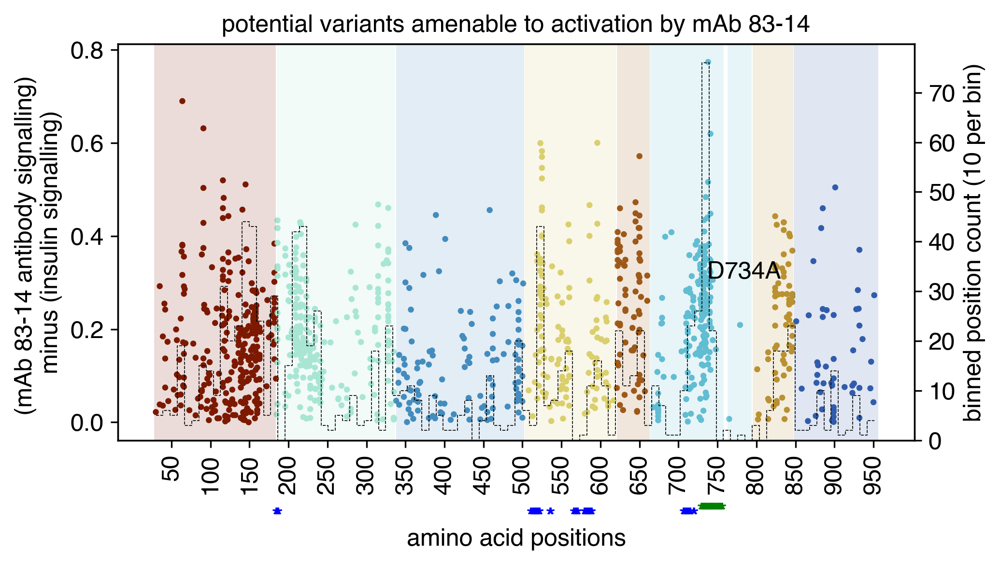

In [ ]:
df=variants_score_dict['insSign_avg'].copy()
insSign_20more=(df[df['variant_score']<-0.204])

insSign_20more=insSign_20more[insSign_20more['insSign_RepCont']==5]
fig, ax1 = plt.subplots(figsize=(7, 4))

df_inSig = insSign_20more
antibodySig = variants_score_dict['a14Sign_avg']
antibodySig=antibodySig[antibodySig['a14Sign_RepCont']==3]
antibodySig=antibodySig[antibodySig['aa_substitutions'].isin(list(df_inSig['aa_substitutions']))]

m1=pd.merge(df_inSig,antibodySig, on='aa_substitutions', suffixes=['_insSign','_antibodySig'])
m1=m1[m1['position_insSign']>27]
m1=m1[m1['variant_score_insSign']<0] #reduced insulin signalling
m1['subtract']=m1['variant_score_antibodySig']-m1['variant_score_insSign']
m1=m1[m1['subtract']>0]

m2=m1[m1['subtract']>0]
mAb83_14_Activated=set(m2['aa_substitutions'])

# Define color ranges and corresponding colors
color_ranges = [
 (28,184,'#7C1900'),
(185,337,'#A8E6D3'),
(338,502,'#438CBD'),
(503,620,'#DACF6D'),
(621,663,'#9E5817'),
(664,758,'#61BDD2'),
(759,764,'w'),
(763,794,'#61BDD2'),
(795,847,'#B99131'),
(848,956,'#305CAB')
]
def get_color(position):
    for start, end, color in color_ranges:
        if start <= position <= end:
            return color
    return 'black'  # default color if position is not within any range

# Generate colors for each point based on 'position_insSign'
colors = [get_color(position) for position in m1['position_insSign']]

# Scatter plot on primary y-axis
ax1.scatter(m1['position_insSign'], m1['subtract'], c=colors, s=4)
ax1.set_ylabel('(mAb 83-14 antibody signalling) \nminus (insulin signalling)', fontsize=12)
ax1.set_xlabel('\namino acid positions', fontsize=12)  # Setting x-label here
ax1.tick_params(axis='both', labelsize=12)
ax1.tick_params(axis='x', rotation=90)


texts=[]
for i, text in enumerate(m1['aa_substitutions']):
    if text == 'D734A' or text == 'S350L':
        texts.append(plt.text(m1['position_insSign'].iloc[i], m1['subtract'].iloc[i], text, fontsize=12))
adjust_text(texts, arrowprops=dict(lw=0.5, color='k', arrowstyle='-'), size=12)
                     
ax2 = ax1.twinx()

# Histogram on secondary y-axis
sns.histplot(data=m1['position_insSign'], bins=100, element='step', color='#000000', fill=False, linewidth=0.4, linestyle='--', label='mAb 8314', ax=ax2)
ax2.set_ylabel('binned position count (10 per bin)', fontsize=12)
ax2.set_xlabel('positions', fontsize=12)
plt.xticks(range(50, 956, 50), fontsize=12)
plt.title('potential variants amenable to activation by mAb 83-14', fontsize=12)
plt.tick_params(axis='y', which='both', labelsize=12)

# Overlay: Domain annotations as background color spans
for start, end, color in color_ranges:
    ax1.axvspan(start, end, color=color, alpha=0.15, lw=0)
    
ab8307_site = [263, 315, 328, 286, 265, 261, 311, 249, 269, 270, 271]
ab8314_site=[504, 506, 622, 515, 577] # derived from scatter plot and structure info, 

for x_coord in site_2:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-17), color='b', fontsize=12)

for x_coord in site_1:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-16), color='g', fontsize=12)

plt.tight_layout()
plt.savefig('results/figures/Fig6G.pdf')
plt.show()

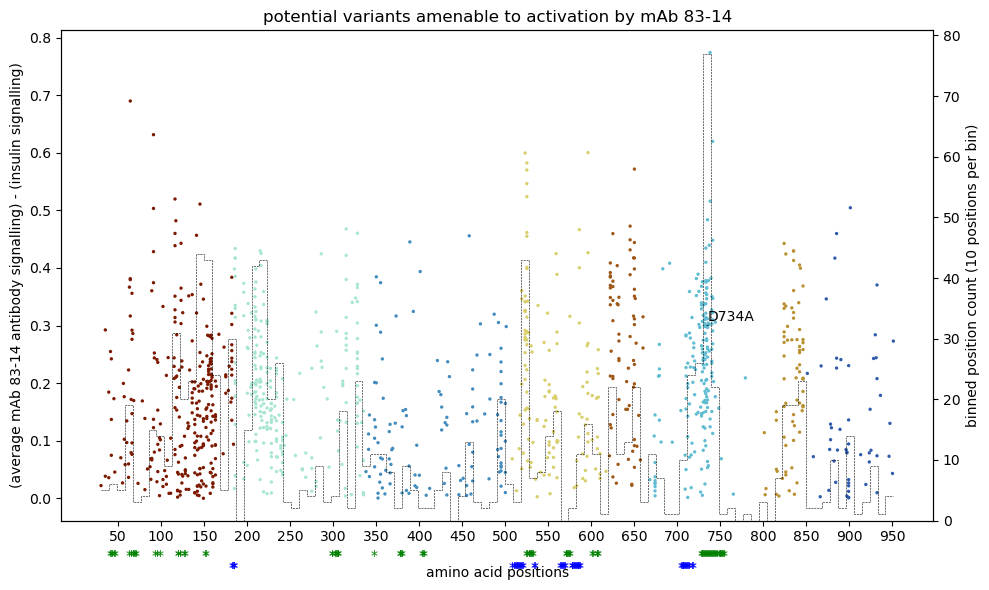

In [ ]:
df=variants_score_dict['insSign_avg'].copy()
insSign_20more=(df[df['variant_score']<-0.204])
insSign_20more=insSign_20more[insSign_20more['insSign_RepCont']==5]

fig, ax1 = plt.subplots(figsize=(10, 6))


df_inSig = insSign_20more
antibodySig = variants_score_dict['a14Sign_avg']
antibodySig=antibodySig[antibodySig['a14Sign_RepCont']==3]

antibodySig=antibodySig[antibodySig['aa_substitutions'].isin(list(df_inSig['aa_substitutions']))]

m1=pd.merge(df_inSig,antibodySig, on='aa_substitutions', suffixes=['_insSign','_antibodySig'])
m1=m1[m1['position_insSign']>27]
m1=m1[m1['variant_score_insSign']<0] #reduced insulin signalling
m1['subtract']=m1['variant_score_antibodySig']-m1['variant_score_insSign']
m1=m1[m1['subtract']>0]

m2=m1[m1['subtract']>0]

mAb83_14_Activated=set(m2['aa_substitutions'])

# Define color ranges and corresponding colors
color_ranges = [
 (28,184,'#7C1900'),
(185,337,'#A8E6D3'),
(338,502,'#438CBD'),
(503,620,'#DACF6D'),
(621,663,'#9E5817'),
(664,758,'#61BDD2'),
(759,764,'w'),
(763,794,'#61BDD2'),
(795,847,'#B99131'),
(848,956,'#305CAB')
]
def get_color(position):
    for start, end, color in color_ranges:
        if start <= position <= end:
            return color
    return 'black'  # default color if position is not within any range

# Generate colors for each point based on 'position_insSign'
colors = [get_color(position) for position in m1['position_insSign']]

# Scatter plot on primary y-axis
ax1.scatter(m1['position_insSign'], m1['subtract'], c=colors, s=2)
ax1.set_ylabel('(average mAb 83-14 antibody signalling) - (insulin signalling)')
ax1.set_xlabel('\namino acid positions')  # Setting x-label here


'''
texts=[]
for i, text in enumerate(m1['aa_substitutions']):
    if m1['subtract'].iloc[i]>0.6 or text == 'D734A':
        texts.append(plt.text(m1['position_insSign'].iloc[i], m1['subtract'].iloc[i], text))
adjust_text(texts, arrowprops=dict(lw=0.5, color='k', arrowstyle='-'))
'''

texts=[]
for i, text in enumerate(m1['aa_substitutions']):
    if text == 'D734A' or text == 'S350L':
        texts.append(plt.text(m1['position_insSign'].iloc[i], m1['subtract'].iloc[i], text))
adjust_text(texts, arrowprops=dict(lw=0.5, color='k', arrowstyle='-'), size=8)
                     
ax2 = ax1.twinx()

# Histogram on secondary y-axis
sns.histplot(data=m1['position_insSign'], bins=100, element='step', color='#000000', fill=False, linewidth=0.4, linestyle='--', label='mAb 8307', ax=ax2)
ax2.set_ylabel('binned position count (10 positions per bin)')
ax2.set_xlabel('positions')
plt.xticks(range(50, 956, 50))
plt.title('potential variants amenable to activation by mAb 83-14')

for x_coord in site_2:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-8.5), color='b')

for x_coord in site_1:
    plt.annotate('*', xy=(x_coord, 0), xytext=(x_coord,-6.5), color='g')
     

plt.tight_layout()
plt.savefig('results/figures/Fig6G.pdf')
plt.show()

30 variants unique to mAb83_7_Activated
10 variants unique to mAb83_14_Activated


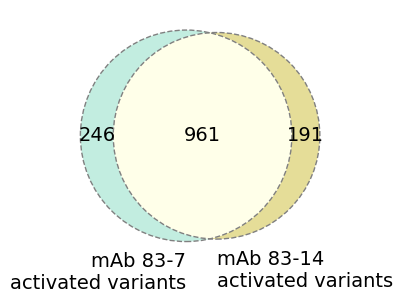

In [ ]:
from matplotlib_venn import venn2, venn3, venn2_circles

plt.subplots(figsize=(4,4))
# Example data for AA substitutions - Loss
#mAb83_7_Activated = set(mAb83_7['aa_substitutions'])
#mAb83_14_Activated = set(mAb83_14['aa_substitutions'])

# Create the Venn diagram for Loss
# Create the Venn diagram for Loss
out=venn2([mAb83_7_Activated, mAb83_14_Activated],
      set_labels=('mAb 83-7\nactivated variants', 'mAb 83-14\nactivated variants'),
      set_colors=('#A8E6D3', '#DACF6D'),
         alpha=0.7,
         ) 

venn2_circles(subsets = [mAb83_7_Activated, mAb83_14_Activated]
              , linestyle='dashed', linewidth=1, color="grey")

for text in out.set_labels:
    text.set_fontsize(14)
for text in out.subset_labels:
    text.set_fontsize(14)
    

#plt.title("variants with (antibody - insulin signalling) score of > 0.25")
#'#A8E6D3''#DACF6D'

# Adjust layout
plt.tight_layout()

count_ab07=0
for aa in mAb83_7_Activated:
    if int(aa[1:-1]) in ab8307_site:
        count_ab07=count_ab07+1
print (str(count_ab07) + ' variants unique to mAb83_7_Activated')

count_ab14=0
for aa in mAb83_14_Activated:
    if int(aa[1:-1]) in ab8314_site:
        count_ab14=count_ab14+1
print (str(count_ab14) + ' variants unique to mAb83_14_Activated')

plt.tight_layout()
plt.savefig('results/figures/Fig6H.pdf')
plt.show()

# ---------------------ChimeraX structure colouring---------------------

### takes pdb file, modify some of the columns and merge pdb file with variant scores, replacing B-factor values in PDB files with variant scores

In [ ]:
pdb_file = "input_files/6pxv.pdb"
for record in SeqIO.parse(pdb_file, "pdb-atom"):
    print("chain: " + record.id.split(":")[1])
    print(record.seq)
    
    
def pdb_to_csv(pdb):
    df_pdb = pd.DataFrame(columns=["id", "atom_no", "atom", "res", "chain", "res_no",
                               "x", "y", "z", "factor_a", "bfactor", "atom_center"])
    with open(pdb) as pdbfile:
        i = 0
        for line in pdbfile:
            if line[:4] == 'ATOM' or line[:6] == "HETATM":
                splitted_line = [line[:6], line[6:11], line[12:16], line[17:20], line[21], line[22:26],
                             line[30:38], line[38:46], line[46:54], line[54:60], line[60:66], line[66:78]]
                df_pdb.loc[i] = splitted_line
                i += 1
    df_id = df_pdb["id"].str.strip()
    df_atom_no = df_pdb["atom_no"].str.strip()
    df_atom = df_pdb["atom"].str.strip()
    df_res = df_pdb["res"].str.strip()
    df_chain = df_pdb["chain"].str.strip()
    df_res_no = df_pdb["res_no"].str.strip()
    df_res_no = df_res_no.astype(int)
    df_x = df_pdb["x"].str.strip()
    df_y = df_pdb["y"].str.strip()
    df_z = df_pdb["z"].str.strip()
    df_factor_a = df_pdb["factor_a"].str.strip()
    df_bfactor = df_pdb["bfactor"].str.strip()
    df_bfactor = df_bfactor.astype(float)
    df_atom_center = df_pdb["atom_center"].str.strip()
    df = pd.concat([df_id, df_atom_no, df_atom, df_res, df_chain, df_res_no,
                   df_x, df_y, df_z, df_factor_a, df_bfactor, df_atom_center], axis = 1)
    return df  

def domain_partitioner(df_csv):
    Selected_columns=["id", "atom_no", "atom", "res", "chain", "res_no","x", "y", "z", "factor_a", "bfactor", "atom_center"]
    df_A = pd.DataFrame(columns=Selected_columns)
    df_C = pd.DataFrame(columns=Selected_columns)
    df_D = pd.DataFrame(columns=Selected_columns)
    df_E = pd.DataFrame(columns=Selected_columns)
    df_F = pd.DataFrame(columns=Selected_columns)
    df_G = pd.DataFrame(columns=Selected_columns)
    
    
    
    ix = 0
    for c in range(len(df_csv["id"])):
        #domain A
        if df_csv["chain"][c]=="A":
            df_A.loc[ix] = df_csv.iloc[c]  
        #domain C
        elif df_csv["chain"][c]=="C":
            df_C.loc[ix] = df_csv.iloc[c]  
        #domain D
        elif df_csv["chain"][c]=="D":
            df_D.loc[ix] = df_csv.iloc[c] 
        #domain E
        elif df_csv["chain"][c]=="E":
            df_E.loc[ix] = df_csv.iloc[c]
        #domain A
        elif df_csv["chain"][c]=="F":
            df_F.loc[ix] = df_csv.iloc[c]
        elif df_csv["chain"][c]=="G":
            df_G.loc[ix] = df_csv.iloc[c]
        
  
            
        ix = ix+1  
    return df_A, df_C, df_D, df_E, df_F, df_G

def bfactor_overwriter_6PXV(pdb, data):
    df_csv = pdb_to_csv(pdb)
    
   
    df_csv['res_no'] = df_csv.apply(lambda row: row['res_no'] + 12 if (row['chain'] in ['A', 'C'] and row['res_no'] > 715) else row['res_no'], axis=1)
   
    
    result_df = df_csv.copy()
    #==============================
    
    a, c, d, e,f,g = domain_partitioner(result_df)
    a['res_no']=a['res_no']+27 #this is to adjust residue numbering in pdb file
    c['res_no']=c['res_no']+27 #this is to adjust residue numbering in pdb file
 
    #this is to adjust residue numbering in pdb file
    df_data = data
    df_a = a.merge(df_data, left_on = "res_no", right_on = "position")
    df_c = c.merge(df_data, left_on = "res_no", right_on = "position")


    df_a = df_a[["id", "atom_no", "atom", "res", "chain", "res_no","x", "y", "z", "factor_a", "median_score", "atom_center"]]
    df_c = df_c[["id", "atom_no", "atom", "res", "chain", "res_no","x", "y", "z", "factor_a", "median_score", "atom_center"]]

    
    df_d=d.rename({'bfactor':'median_score'}, axis=1)
    df_e=e.rename({'bfactor':'median_score'}, axis=1)
    df_f=f.rename({'bfactor':'median_score'}, axis=1)
    df_g=g.rename({'bfactor':'median_score'}, axis=1)
    
 

    df = pd.concat([df_a, df_c, df_d, df_e, df_f, df_g], axis = 0)
    
    print("Process completed")
    return df

chain: A
HLYPGEVCPGMDIRNNLTRLHELENCSVIEGHLQILLMFKTRPEDFRDLSFPKLIMITDYLLLFRVYGLESLKDLFPNLTVIRGSRLFFNYALVIFEMVHLKELGLYNLMNITRGSVRIEKNNELCYLATIDWSRILDSVEDNYIVLNKDDNEECGDICPGTXXXXXNCPATVINGQFVERCWTHSHCQKVCPTICKSHGCTAEGLCCHSECLGNCSQPDDPTKCVACRNFYLDGRCVETCPPPYYHFQDWRCVNFSFCQDLHHKCKNSRXXXCHQYVIHNNKCIPECPSGYTMNSSNLLCTPCLGPCPKVCHLLEGEKTIDSVTSAQELRGCTVINGSLIINIRGGNNLAAELEANLGLIEEISGYLKIRRSYALVSLSFFRKLRLIRGETLEIGNYSFYALDNQNLRQLWDWSKHNLTITQGKLFFHYNPKLCLSEIHKMEEVSGTKGRQERNDIALKTNGDQASCENELLKFSYIRTSFDKILLRWEPYWPPDFRDLLGFMLFYKEAPYQNVTEFXXXXXXXXXSWTVVDIDPPLRSNDPKSQNHPGWLMRGLKPWTQYAIFVKTLVTFSDERRTYGAKSDIIYVQTDATNPSVPLDPISVSNSSSQIILKWKPPSDPNGNITHYLVFWERQAEDSELFELDYCLKGLKLPSRXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXQILKELEESSFRKTFEDYLHNVVFVPRXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXEEHRPFEKVVNKESLVISGLRHFTGYRIELQACNQDTPEERCSVAAYVSARTMPEAKADDIVGPVTHEIFENNVVHLMWQEPKEPNGLIVLYEVSYRRYGDEELHLCVSRKHFALERGCRLRGLSPGNYSVRIRATSLAGNGSWTEPTYFYVTDYLD
chain: C
HLYPGEVCPGMDIRNNLTRLHELENCSVIEGHLQILLMFKTRPEDFRDLSFPKLIMITDYLLLFRVYGLES

### process PDB file and add expression scores to the file

In [ ]:
df_exp = variantsScore_melt['a07a14_Bind_avg']

df_exp = df_exp[['position','median_score']]

df_end=bfactor_overwriter_6PXV(pdb = pdb_file, data = df_exp)

df_end.to_csv('results/PDB/expression_6PXV.csv', index=False, header=False)

# define the AWK command
!awk 'BEGIN{OFS=FS=","}{$7=sprintf("%.3f",$7)}1{$8=sprintf("%.3f",$8)}1{$9=sprintf("%.3f",$9)}1' results/PDB/expression_6PXV.csv | awk 'BEGIN {FS =","; OFS=""} { if(length($3) == 4 ) {pad = sprintf("%s", " ")} else {pad = sprintf("%2s", " ")} } { if(length($3) == 4 ) {pad2 = sprintf("%s", " ")} else {pad2 = sprintf("%s", "")} } {printf "%-6s%5s%s%-4s%s%3s%2s%4s%12s%8s%8s%6s%6s%12s\n", $1, $2, pad, $3, pad2, $4, $5, $6, $7, $8, $9, $10, $11, $12}' > results/PDB/expression_6PXV.pdb


Process completed


### get list of the positions with median scores less than -0.284 according to SuppFigure3F

In [ ]:
df_exp_subset = df_exp[['position','median_score']]

# Filter positions where median score is less than -0.266
expressLoss_morDan20prc = df_exp_subset[df_exp_subset['median_score'] < -0.284]['position'].tolist()
expressLoss_lesDan20prc = df_exp_subset[~df_exp_subset['position'].isin(expressLoss_morDan20prc)]['position'].tolist()

print(f"Mutating {len(expressLoss_morDan20prc)} residues reduces expression more than 20%")
print(f"Mutating {len(expressLoss_lesDan20prc)} have not effect on expression or or reduction is less than 20%")

Mutating 164 residues reduces expression more than 20%
Mutating 764 have not effect on expression or or reduction is less than 20%


### process PDB file and add insulin binding scores to the file

In [ ]:
#give 0 to median_resides in positions that reduce cell surface expression more than 20%

df_insBind = variantsScore_melt['insBind_avg']

df_insBind = df_insBind[['position','median_score']]

df_insBind.loc[df_insBind['position'].isin(expressLoss_morDan20prc), 'median_score'] = 0 

df_end=bfactor_overwriter_6PXV(pdb = pdb_file, data = df_insBind)

df_end.to_csv('results/PDB/insBind_6PXV.csv', index=False, header=False)

# define the AWK command
!awk 'BEGIN{OFS=FS=","}{$7=sprintf("%.3f",$7)}1{$8=sprintf("%.3f",$8)}1{$9=sprintf("%.3f",$9)}1' results/PDB/insBind_6PXV.csv | awk 'BEGIN {FS =","; OFS=""} { if(length($3) == 4 ) {pad = sprintf("%s", " ")} else {pad = sprintf("%2s", " ")} } { if(length($3) == 4 ) {pad2 = sprintf("%s", " ")} else {pad2 = sprintf("%s", "")} } {printf "%-6s%5s%s%-4s%s%3s%2s%4s%12s%8s%8s%6s%6s%12s\n", $1, $2, pad, $3, pad2, $4, $5, $6, $7, $8, $9, $10, $11, $12}' > results/PDB/insBind_6PXV.pdb


Process completed


### process PDB file and add insulin signalling scores to the file

In [ ]:
#give 0 to median_resides in positions that reduce cell surface expression more than 20%

df_insBind = variantsScore_melt['insSign_avg']

df_insBind = df_insBind[['position','median_score']]

df_insBind.loc[df_insBind['position'].isin(expressLoss_morDan20prc), 'median_score'] = 0 

df_end=bfactor_overwriter_6PXV(pdb = pdb_file, data = df_insBind)

df_end.to_csv('results/PDB/insSign_6PXV.csv', index=False, header=False)

# define the AWK command
!awk 'BEGIN{OFS=FS=","}{$7=sprintf("%.3f",$7)}1{$8=sprintf("%.3f",$8)}1{$9=sprintf("%.3f",$9)}1' results/PDB/insSign_6PXV.csv | awk 'BEGIN {FS =","; OFS=""} { if(length($3) == 4 ) {pad = sprintf("%s", " ")} else {pad = sprintf("%2s", " ")} } { if(length($3) == 4 ) {pad2 = sprintf("%s", " ")} else {pad2 = sprintf("%s", "")} } {printf "%-6s%5s%s%-4s%s%3s%2s%4s%12s%8s%8s%6s%6s%12s\n", $1, $2, pad, $3, pad2, $4, $5, $6, $7, $8, $9, $10, $11, $12}' > results/PDB/insSign_6PXV.pdb


Process completed


# ----------------------- Alanine Scanning Studies -----------------------

Load alanine scanning data derived from previous studies

In [ ]:
#read excel file made by Robert from alanin scanning papers
ala_scan=pd.ExcelFile(config['alanin_scan']).parse('Sheet1')

#drop variants with no expression 
ala_scan=ala_scan[ala_scan['Expression']=='expressed']

#store KD and IC50 scanning methods in separate dataframes 
ala_scan_kd = ala_scan[ala_scan['Note'] == 'KD MUT:KD WT']
ala_scan_IC50 = ala_scan[ala_scan['Note'] == 'IC50M:IC50WT']

#read insulin binding scores for all individual variants
ins_bnd_all=variants_score_dict['insBind_avg']

ins_bnd_all=ins_bnd_all.rename(columns={'variant_aa':'aa_change'})
ins_bnd_all.head()

,aa_substitutions,variant_score,insBind_RepCont,FDRvalues,-log10_FDRvalues,wt_aa,position,aa_change,site_1,site_2,ab8307_site,ab8314_site,c_c,data_pos
0,A10V,-0.025762,2.0,0.82726,0.082358,A,10,V,,,,,,
1,A119C,-0.352023,2.0,0.000203,3.693375,A,119,C,,,,,,
2,A119D,-0.506145,2.0,0.000824,3.084308,A,119,D,,,,,,
3,A119E,-0.842691,2.0,0.000202,3.694517,A,119,E,,,,,,
4,A119F,-0.548608,2.0,0.000203,3.693111,A,119,F,,,,,,


In [ ]:
#read excel file made by Robert from alanin scanning papers
ala_scan=pd.ExcelFile(config['alanin_scan']).parse('Sheet1')

#drop variants with no expression 
ala_scan=ala_scan[ala_scan['Expression']=='expressed']

#store KD and IC50 scanning methods in separate dataframes 
ala_scan_kd = ala_scan[ala_scan['Note'] == 'KD MUT:KD WT']
ala_scan_IC50 = ala_scan[ala_scan['Note'] == 'IC50M:IC50WT']

#read insulin binding scores for all individual variants
ins_bnd_all=variants_score_dict['insBind_avg'].copy()
ins_bnd_all['pos']=ins_bnd_all['aa_substitutions'].str[1:-1]
ins_bnd_all['wt_aa']=ins_bnd_all['aa_substitutions'].str[:1]
ins_bnd_all['aa_change']=ins_bnd_all['aa_substitutions'].str[-1:]
ins_bnd_all=ins_bnd_all[ins_bnd_all['aa_substitutions']!='synonymous']
#ins_bnd_all=ins_bnd_all.rename(columns={'insBind_avg':'variant_score'})


ala_scan_kd['pos']=ala_scan_kd['pos'].astype(int)
ins_bnd_all['pos']=ins_bnd_all['pos'].astype(int)


#get average variant score per position for insulin binding
ins_bnd_pp=ins_bnd_all.groupby(['pos']).mean()

#get average alanin scanning score per position from different KD assays
ala_scan_kd_pp=ala_scan_kd.groupby(['pos']).mean()

#merge ala_scan_kd with ins_bnd_all based on pos and aa_change, also keep duplicated observations in ala_scan_kd data, 
ala_scan_kd_merg_all = ala_scan_kd.merge(ins_bnd_all, on=['pos', 'aa_change'], how='left')

#==============  merge KD data with variant scores  ==========

#merge ala_scan_kd with ins_bnd_all based on pos and aa_change, also keep duplicated observations in ala_scan_kd data, 
ala_scan_kd_merg_all_new = ala_scan_kd_pp.merge(ins_bnd_all, on=['pos'], how='left')

#drop rows if there is no variant score for an alanin scanning variant
ala_scan_kd_merg_all=ala_scan_kd_merg_all.dropna(subset=['variant_score'])

#drop rows if there is no variant score for an alanin scanning variant
ala_scan_kd_merg_all_new=ala_scan_kd_merg_all_new.dropna(subset=['variant_score'])

#merge ala_scan_kd with ins_bnd_all based on pos and aa_change, also keep duplicated observations in ala_scan_kd data, 
ala_scan_kd_merg_pp = ala_scan_kd.merge(ins_bnd_pp, on='pos', how='left')

ala_scan_kd_merg_pp_new = ala_scan_kd_pp.merge(ins_bnd_pp, on=['pos'], how='left')

#drop rows if there is no variant score for an alanin scanning variant
ala_scan_kd_merg_pp=ala_scan_kd_merg_pp.dropna(subset=['variant_score'])

#drop rows if there is no variant score for an alanin scanning variant
ala_scan_kd_merg_pp_new=ala_scan_kd_merg_pp_new.dropna(subset=['variant_score'])


#================  merge IC50 data with variant scores  ============
#merge ala_scan_kd with ins_bnd_all based on pos and aa_change, also keep duplicated observations in ala_scan_kd data, 
ala_scan_IC50_merg_all = ala_scan_IC50.merge(ins_bnd_all, on=['pos', 'aa_change'], how='left')

#drop rows if there is no variant score for an alanin scanning variant
ala_scan_IC50_merg_all=ala_scan_IC50_merg_all.dropna(subset=['variant_score'])

#merge ala_scan_kd with ins_bnd_all based on pos and aa_change, also keep duplicated observations in ala_scan_kd data, 
ala_scan_IC50_merg_pp = ala_scan_IC50.merge(ins_bnd_pp, on='pos', how='left')

#drop rows if there is no variant score for an alanin scanning variant
ala_scan_IC50_merg_pp=ala_scan_IC50_merg_pp.dropna(subset=['variant_score'])


#================   save merged alanin scanning and DMS scores in results folder   ==============
#ala_scan_kd_merg_pp.to_csv('results/ala_scan_kd_pp.csv')

ala_scan_kd_merg_all['FDRvalues']=np.power(10,-ala_scan_kd_merg_all['FDRvalues'])


ala_scan_kd_merg_all.drop(['No (Mature)','Ins Signallling','wt_aa','aa_wt','Expression','Assay Comment',
                           'Note','aa_change','insBind_RepCont'], axis=1, inplace=True)
ala_scan_kd_merg_all.rename(columns={'Ins Binding':'alanine_scanning_score'}, inplace=True)



ala_scan_kd_merg_all_mean=(ala_scan_kd_merg_all.groupby(['pos']).mean())
ala_scan_kd_merg_all_mean['pos']=ala_scan_kd_merg_all_mean.index
ala_scan_kd_merg_pp_mean=(ala_scan_kd_merg_pp.groupby(['pos']).mean())
ala_scan_kd_merg_pp_mean['pos']=ala_scan_kd_merg_pp_mean.index

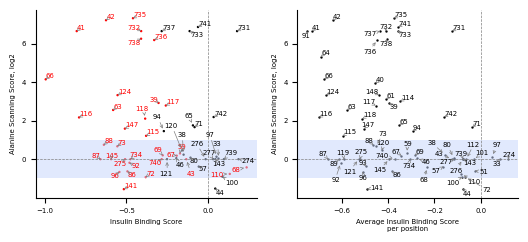

In [ ]:
#========= scatter plot insulin binding scores from DMS data and insulin binding from alanin scanning  experiments =======
# Create a function to plot scatter with annotations


plt.figure(figsize=(8, 9.3))
plt.subplots_adjust(hspace=0.15, wspace=0.15)

def plot_scatter_with_annotations(data_df, x_col, y_col, color_red=False):
    if color_red:
        fdr_values = data_df['-log10_FDRvalues']  # Assuming 'FDRvalues' is the column name
        red_indices = fdr_values > -np.log10(0.05)
        plt.scatter(data_df[x_col], np.log2(data_df[y_col]), s=0.5, c=np.where(red_indices, 'red', 'black'))
        plt.xlabel('Insulin Binding Score', size=5)
        plt.axhspan(-1, 1, facecolor='#c4d5fd', alpha=0.5)

        

        
        texts = []
        for i, row in data_df.iterrows():
            text_color = 'red' if row['-log10_FDRvalues'] > -np.log10(0.05) else 'black'
            point = plt.annotate((row['pos'].astype(int)), (row[x_col], np.log2(row[y_col])), size=5, **dict(color=text_color))
            texts.append(point)

        adjust_text(texts, precision=0.001, expand_text=(1.1, 1.25), arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=5))
    
    else:
        plt.scatter(data_df[x_col], np.log2(data_df[y_col]), s=0.5, c='black')
        plt.xlabel('Average Insulin Binding Score\nper position', size=5)
        plt.axhspan(-1, 1, facecolor='#c4d5fd', alpha=0.5)

    
    

        texts = []
        for i, row in data_df.iterrows():
            point = plt.annotate((row['pos'].astype(int)), (row[x_col], np.log2(row[y_col])), size=5, **dict(color='black'))
            texts.append(point)

        adjust_text(texts, precision=0.001, expand_text=(1.1, 1.25), arrowprops=dict(arrowstyle='->', color='grey', lw=0.5, mutation_scale=5))
    
    plt.axvline(0, linestyle='--', c='gray', lw=0.5)
    plt.axhline(0, linestyle='--', c='gray', lw=0.5)
    plt.xticks(size=5)
    plt.yticks(size=5)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.ylabel(f'Alanine Scanning Score, log2', size=5)
    
    

# Assuming plt.subplot() is already imported

ax = plt.subplot(4,3,1)
plot_scatter_with_annotations(ala_scan_kd_merg_all_mean, 'variant_score', 'alanine_scanning_score', color_red=True)



ax = plt.subplot(4,3,2)
plot_scatter_with_annotations(ala_scan_kd_merg_pp_mean, 'variant_score', 'Ins Binding')

plt.tight_layout()

plt.savefig('results/figures/SuppFig4AB.pdf')

plt.show()